### 3202 Introduction to AI - Final Project - Spring 2022
### Analyzing Feature Extraction in Diffraction Image Classifiers
#### Author: Sabine Hollatz <br><br>GitHub:https://github.com/SHollatz/CSPB3202_finalProject
Videopresentation:

### Motivation and Background Information 
This project is part of my internship at the National Accelerator Laboratory SLAC with the Molecular Crystallography group. Crystallography is an important method for determining biological structures, based on which drugs for diseases can be developed. For example, the Zika virus shell could be determined by this research field. Currently, research on coronavirus 2 (SARS-CoV-2) is conducted.

Crystallography research analyzes and determines the molecular structure of macromolecules, such as proteins, in crystallized form. During an X-ray diffraction experiment, the X-ray beam can interact with the electrons of a protein crystal and diffract in a structure-specific pattern. These diffraction patterns are recorded by an area detector in form of diffraction images. Crystallographic experiments have led to substantial advances including structure-based drug development fo fighting diseases.

Artificial Intelligence can support this important field of research by providing automatic means to gauge experimental success in real-time. Especially serial crystallography is challenging, where hundreds of thousands of tiny crystals are exposed to X-rays in random orientations and lost after beam impact. Often only one diffraction image is detected from each crystal. The analyses of large serial diffraction datasets currently take from hours to days. Detector improvemens have further increased the amount of data to massive amounts of data (~25 Gbit/s). Machine learning models will be applied to detect and discard blank images while ensuring that images with usable diffraction are not lost. Furthermore, they will detect problematic diffraction images (such as images with split diffraction spots) that cannot be identified and analyzed by the currently available crystallographic software. Overall, Machine learning models will dramatically reduce the time, storage and effort required to aptly process challenging datasets. 

### My Previous Work in the Internship Project
First, initial machine learning tests with simulated 512x512 8-bit images of crystal diffraction (photosystem II) were  promising. Categories were: blank, no-crystal, and weak, good, and strong diffraction. I could train a classifier that predicted diffraction quality with an accuracy of more than 90% and that generalized well in tests with completely new data.
Second, I conducted further ML tests by adding more complex categories to the data. These categories included partial ice rings and mixing patterns from two different types of protein (photosystem I and photosystem II), as well as smeared diffraction spots caused by flawed crystals. The simulated training images were categorized into 6 different categories in total: blank/no diffraction, photosystem I, photosystem II, multilattice (smeared spots), ice diffraction, and dangerous ice diffraction, which can damage the detector. In addition, two continuous parameters for the mosaicity of the flawed crystals were predicted. The goal was to train a single model that can fulfill both tasks at once, categorization and regression, trained on the same dataset. Multitask learning models supposedly perform better than separately trained models.
However, the second part of the project turned out to be challenging. The multitask learning approach did not learn from scratch, but needed initial weights that were suited to diffraction images. When I applied transfer learning based on the simple classifier from the first part of the project, I finally saw learning behavior. But the performance of the regression compound was still far off and, even though it was better, the performance of the classifier compound was also disappointing. For that reason, I reduced the multitask learning approach to multilabel classification without regression. The achieved accuracies were partially fine, partially disappointing, and partially not even better than random (blank: 92.25%, photo1: 51.96%, photo2: 57.16%, multilattice: 76.56%, ice: 22.64%, badice: 13.71%). To ensure that ice patterns and smeared spots can be detected by a classifier in general, I trained two binary classifiers, one for each task. Ice could be detected with an accuracy of 89.7% on test data and smeared spots with an accuracy of 66.91%.

### The Current Project in CSPB 3202
Recent discussions within our team braught up the question, if the pixel patterns for each category are significant enough in the training data to enable machine learning models to pick up on them. This is particularly interesting, because the training images are downsampled so that the computational expense for training convolutional neural networks (CNNs) is kept feasible. CNNs are known for being opaque during their feature extraction process on which they make their predictions and are often referred to as black boxes. Nevertheless, I will attempt to extract, display and analyze convolutional filters and feature maps from the previously trained classifiers and try to gain more insight on the learned representations. These results may influence future training approaches and architecture designs in general, and, in particular, the decision if we continue training with downsampled images or switch to cropped pieces of images.

##### The Data
Experimental diffraction images are poorly suited to ML training, as they are easy to mis-categorize by eye and difficult to obtain in sufficient quantity for each category. Therefore, the training dataset is simulated. The physics of X-ray diffraction are well understood and a simulator was developed by my mentor, James Holton. Input to the simulation software includes specific X-ray properties and the experimental environment. More information about the simulator can be found here: http://bl831.als.lbl.gov/~jamesh/nanoBragg
The dataset used to train the previously described models consists of 41956 diffraction images (8 bit grayscale images of size 512x512) in png and pgm format that are distributed over 6 categories: blank, photo1, photoII, multilattice, ice and badice. Each image can belong to more than one category, but does not have to. In addition, two numeric mosaicitiy parameters are provided, continuous numbers between 0 and 1, that stand for the level of which a crystal is split into sub-crystals. Split crystals cause smeared or split spots that are difficult to process by current crystallographic software.

### Exploratory Data Analysis of the Training Data

In [1]:
import tensorflow as tf
import keras as k
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import glob
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn import metrics

Using TensorFlow backend.


In [2]:
# loading the labels from try2 with added noxtal imgs from try1
df_labels = pd.read_csv('/data/hollatz/deep_learning/datasets/try2_gray_512_pgm/multiclasses.txt', sep=' ', 
                        names=['blank', 'photo1', 'photo2', 'multilattice', 'ice', 'badice', 'mosaic1', 'mosaic2'])
df_labels_try1 = pd.read_csv('/data/hollatz/deep_learning/datasets/try1_original/categories1.txt', sep=' ', 
                        names=['quality', 'mosaic1', 'mosaic2'])
dummy = pd.get_dummies(df_labels_try1.quality)
df_labels_try1 = df_labels_try1.drop(['quality'], axis=1)
df_labels_try1_dummies = pd.concat([df_labels_try1, dummy], axis=1)
df_labels_try1_dummies.head()
df_labels_try1_noxtal = df_labels_try1_dummies.drop(['mosaic1', 'mosaic2', 'good', 'strong', 'weak', 'blank'], axis=1)
not_noxtal = df_labels_try1_noxtal[df_labels_try1_noxtal.noxtal == 0].index
df_try1_noxtal = df_labels_try1_noxtal.drop(not_noxtal)
df_try1_blank = df_try1_noxtal.rename(columns={'noxtal':'blank'})
df_labels = df_labels.append(df_try1_blank, ignore_index=False, sort=False)
df_labels.fillna(0, inplace=True)
df_labels[['blank', 'photo1', 'photo2', 'multilattice', 'ice', 'badice']] = df_labels[['blank', 'photo1', 'photo2', 'multilattice', 'ice', 'badice']].astype(int)
print("num images: ", len(df_labels.index))
df_labels.head()

('num images: ', 41956)


,blank,photo1,photo2,multilattice,ice,badice,mosaic1,mosaic2
fake_00001.pgm,0,1,0,0,1,0,0.892528,0.000000
fake_00002.pgm,0,0,1,1,0,0,0.581729,0.568217
fake_00003.pgm,0,1,0,0,0,0,0.508285,0.000000
fake_00004.pgm,0,1,0,0,0,0,0.852589,0.000000
fake_00005.pgm,0,0,1,0,0,0,0.762097,0.000000


In [21]:
def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 5),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

def fill_counter(df, cats):
    counter = np.zeros(len(cats), dtype=int)
    for i, cat in enumerate(cats):
        if (cat == 'mosaic1' or cat == 'mosaic2'): 
            counter[i] = df[cat][df[cat] > 0].count()
        else: 
            counter[i] = df[cat][df[cat] == 1].count()
    return counter

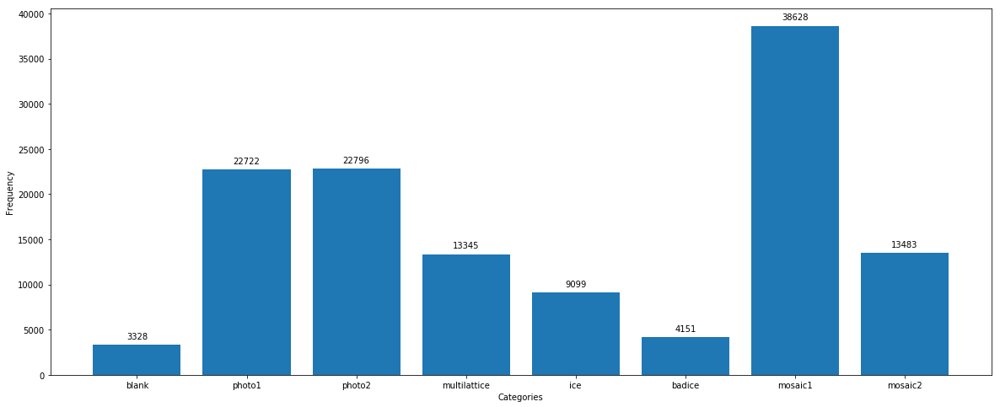

In [4]:
categories = ['blank', 'photo1', 'photo2', 'multilattice', 'ice', 'badice', 'mosaic1', 'mosaic2']
counter = fill_counter(df_labels, categories)
fig, ax = plt.subplots(figsize=(20,8))
rects = plt.bar(categories, counter)
autolabel(rects)
plt.ylabel('Frequency')
plt.xlabel('Categories');

The images are unevenly distributed over the 6 categories and 2 numeric factors. Particularly small is the number of blank and badice images. 

Checking correlations between labels is used here as a quality check for the simulation. 

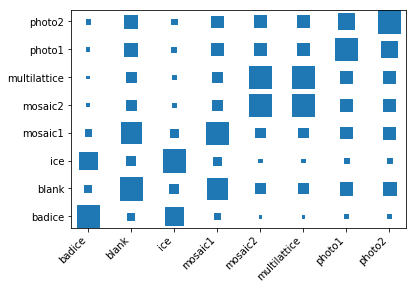

In [5]:
def heatmap(x, y, size):
    fig, ax = plt.subplots()
    
    # Mapping from column names to integer coordinates
    x_labels = [v for v in sorted(x.unique())]
    y_labels = [v for v in sorted(y.unique())]
    x_to_num = {p[1]:p[0] for p in enumerate(x_labels)} 
    y_to_num = {p[1]:p[0] for p in enumerate(y_labels)} 
    
    size_scale = 500
    ax.scatter(
        x=x.map(x_to_num), # Use mapping for x
        y=y.map(y_to_num), # Use mapping for y
        s=size * size_scale, # Vector of square sizes, proportional to size parameter
        marker='s' # Use square as scatterplot marker
    )
    
    # Show column labels on the axes
    ax.set_xticks([x_to_num[v] for v in x_labels])
    ax.set_xticklabels(x_labels, rotation=45, horizontalalignment='right')
    ax.set_yticks([y_to_num[v] for v in y_labels])
    ax.set_yticklabels(y_labels)
    
corr = df_labels[categories].corr()
corr = pd.melt(corr.reset_index(), id_vars='index') # Unpivot the dataframe, so we can get pair of arrays for x and y
corr.columns = ['x', 'y', 'value']
heatmap(
    x=corr['x'],
    y=corr['y'],
    size=corr['value'].abs()
)

# code from https://towardsdatascience.com/better-heatmaps-and-correlation-matrix-plots-in-python-41445d0f2bec

As expected, correlations exist between the categories ice and badice, as well as mosaic2 
and multilattice. The correlation between blank and mosaic1 can be explained by the occurance
that mosaic1 is never 0 except in blank images. Mosaic2 is only greater than 0 when the crystal is flawed and smeared spots (multilattice) occur. There are no unexpected correlations between label distributions.

In [6]:
# loading the images of the original dataset
read_all_imgs = []
folderpath_try2 = "/data/hollatz/deep_learning/datasets/try2_gray_512_pgm/pgm/"
folderpath_try1 = "/data/hollatz/deep_learning/datasets/try1_original/png/"
for filename in df_labels.iterrows():
    if ".png" in filename[0]:
        img_path = folderpath_try1 + str(filename[0])
    else:
        img_path = folderpath_try2 + str(filename[0])
    img_frame = Image.open(img_path)
    img_array = np.asarray(img_frame)
    img_array = img_array.reshape((img_array.shape[0], img_array.shape[1], 1))
    read_all_imgs.append(img_array)

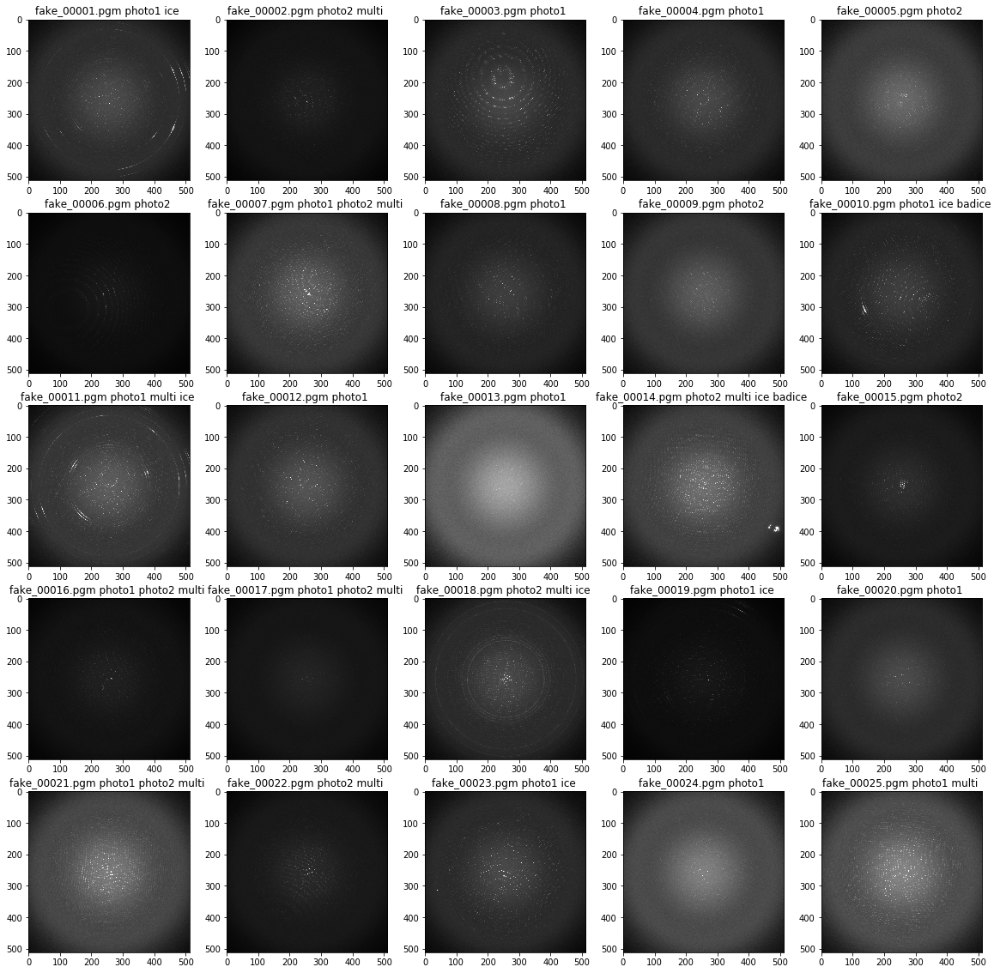

In [7]:
# display first 25 images
unique_index = pd.Index(df_labels.index)

fig = plt.figure(figsize=(20,20))
for o in range(25):
    fig.add_subplot(5, 5, o+1)
    cats = "" 
    row = df_labels.iloc[o]
    if row['blank'] == 1:
        cats += "blank "
    if row['photo1'] == 1:
        cats += "photo1 "
    if row['photo2'] == 1:
        cats += "photo2 " 
    if row['multilattice']==1:
        cats += "multi "
    if row['ice']==1:
        cats += "ice "
    if row['badice']==1:
        cats += "badice "
    plt.title(str(unique_index[o])+ " " + cats)
    plt.imshow(read_all_imgs[o].reshape(read_all_imgs[o].shape[0], read_all_imgs[o].shape[1]), cmap='gray')
plt.show()

To get a better idea of the dataset, these sample images are provided. 
The title for each image includes the filename and the categories the image belongs to. It becomes obvious that identifying diffraction images by eye requires a lot of professional experience and insight.

### Analyzing Four Sample Images in Detail

In [76]:
def annotate_hist(freq, bins, patches):
# x coordinate for labels
    bin_centers = np.diff(bins)*0.5 + bins[:-1]

    n = 0
    for fr, x, patch in zip(freq, bin_centers, patches):
      height = int(freq[n])
      plt.annotate("{}".format(height),
                   xy = (x, height),             # top left corner of the histogram bar
                   xytext = (0,0.2),             # offsetting label position above its bar
                   textcoords = "offset points", # Offset (in points) from the *xy* value
                   ha = 'center', va = 'bottom'
                   )
      n = n+1

    plt.legend()
    plt.show;

For reference purposes, a grayscale color gradient with pixel values is displayed. Black pixels have a value of 0 and white pixels have a value of 255.

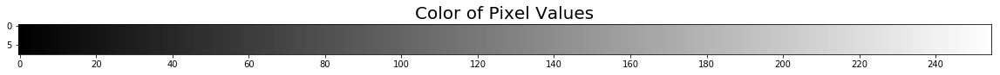

In [55]:
img = [np.arange(0, 255, 1)] * 8
img = np.array(img)
plt.figure(figsize=(20,5))
plt.imshow(img.reshape(img.shape[0], img.shape[1]), cmap='gray')
plt.xticks(np.arange(0, 255, 20))
plt.title("Color of Pixel Values", fontsize=20)
plt.show()

#### 1. Sample Image with Strong, but Regular Diffraction

(1, 512, 512, 1)


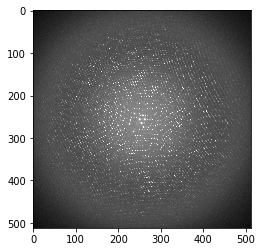

In [2]:
image_path_strong = "/data/hollatz/deep_learning/datasets/try1_original/png/fake_00003.png"
img_array_strong = np.array(Image.open(image_path_strong))
img_0_strong = np.expand_dims(img_array_strong, axis=0)
img_strong = np.expand_dims(img_0_strong, axis=3)
print(img_strong.shape)
plt.imshow(img_array_strong.reshape(img_array_strong.shape[0], img_array_strong.shape[1]), cmap="gray")

The following cells provide some insight about the pixel distribution in that sample image. I picked a row of 512 pixels from the middle of the image, where the most and most intense diffraction spots are located.

In [103]:
img_array_strong[250]

array([130, 127, 129, 129, 129, 132, 131, 134, 134, 131, 134, 135, 135,
       135, 136, 133, 133, 130, 136, 135, 137, 142, 136, 137, 136, 135,
       138, 147, 139, 143, 137, 135, 136, 136, 134, 136, 136, 136, 137,
       137, 138, 140, 139, 148, 135, 137, 138, 137, 151, 157, 136, 139,
       137, 134, 141, 143, 146, 140, 139, 140, 137, 137, 154, 139, 139,
       139, 137, 138, 147, 147, 136, 134, 134, 134, 136, 139, 137, 135,
       136, 135, 137, 139, 137, 138, 138, 136, 140, 143, 158, 140, 140,
       142, 140, 140, 161, 175, 142, 138, 136, 149, 210, 149, 139, 140,
       137, 144, 171, 201, 143, 143, 140, 144, 154, 153, 146, 143, 142,
       143, 145, 159, 144, 143, 143, 144, 146, 158, 148, 146, 144, 150,
       156, 155, 148, 147, 146, 147, 146, 148, 145, 150, 146, 151, 149,
       164, 150, 148, 149, 148, 149, 152, 151, 151, 151, 155, 208, 224,
       159, 151, 154, 154, 161, 239, 161, 155, 158, 156, 160, 163, 159,
       155, 160, 159, 167, 158, 157, 160, 155, 167, 205, 163, 15

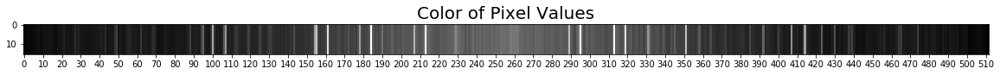

In [104]:
img_strong_stripe = [img_array_strong[250]] * 16
img_strong_stripe = np.array(img_strong_stripe)
plt.figure(figsize=(20,5))
plt.imshow(img_strong_stripe, cmap='gray')
plt.xticks(np.arange(0, 512, 10))
plt.title("Color of Pixel Values", fontsize=20)
plt.show()

Spots, which are represented as brighter lines, occur along the image width between pixel 25 to 475. They seem to consist of only a few pixels in width, between 1 to 3 or 4 pixels.

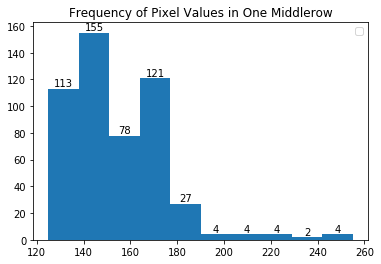

In [78]:
freq_row_strong, bins_row_strong, patches_row_strong = plt.hist(img_array_strong[250])
plt.title("Frequency of Pixel Values in One Middlerow")
annotate_hist(freq_row_strong, bins_row_strong, patches_row_strong)

In row 250 out of 512 total rows, the pixel values start at around 120 and do not get darker. Most values are a shade of middle gray (~91%). Diffraction spots are mainly of a light grey or weight, but are best detected in contrast with surrounding pixels. 

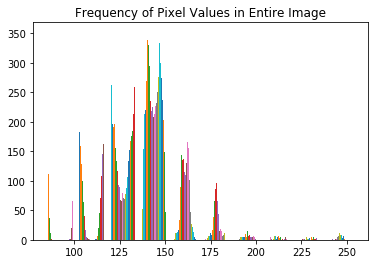

In [80]:
plt.hist(img_array_strong)
plt.title("Frequency of Pixel Values in Entire Image")
plt.show()

The distribution of pixel values over the entire image is similar to row 250. In this example image with strong diffraction, most of the pixel values are in between 120 and 150, which are medium gray. Only a few are brighter than a value of 185.

#### 2. Sample Image with Ice Rings

(1, 512, 512, 1)


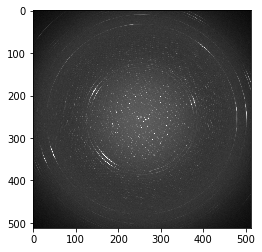

In [3]:
image_path_ice = "/data/hollatz/deep_learning/datasets/try2_gray_512_pgm/pgm/fake_00011.pgm"
img_array_ice = np.array(Image.open(image_path_ice))
img_0_ice = np.expand_dims(img_array_ice, axis=0)
img_ice = np.expand_dims(img_0_ice, axis=3)
print(img_ice.shape)
plt.imshow(img_array_ice.reshape(img_array_ice.shape[0], img_array_ice.shape[1]), cmap="gray")

Already by looking at the image, it becomes clear, that the pixel distribution in diffraction images highly depends on the quality of diffraction. Even though ice rings add additional bright pixel areas to the regular diffraction, here less bright pixels values above 180 are expected.

In [106]:
img_array_ice[250]

array([ 96,  97,  99, 100, 102, 100,  99,  98, 104, 111, 103, 100, 103,
       103, 100, 103, 102, 102, 100, 105, 104, 103, 101, 105, 106, 106,
       104, 104, 103, 104, 105, 104, 112, 104, 103, 103, 106, 105, 107,
       113, 107, 104, 107, 109, 105, 105, 105, 104, 102, 106, 106, 104,
       107, 106, 101, 104, 105, 104, 107, 104, 107, 103, 105, 107, 104,
       112, 105, 104, 107, 106, 104, 123, 114, 107, 108, 107, 101, 104,
       103, 105, 109, 108, 106, 107, 105, 108, 105, 108, 106, 103, 103,
       105, 116, 119, 105, 105, 107, 108, 117, 128, 108, 105, 106, 107,
       106, 110, 110, 109, 107, 109, 121, 131, 108, 108, 108, 112, 151,
       152, 110, 111, 110, 115, 141, 129, 116, 122, 111, 112, 119, 111,
       109, 110, 114, 118, 142, 113, 113, 119, 115, 114, 120, 112, 114,
       115, 113, 128, 120, 116, 117, 115, 119, 157, 118, 112, 116, 121,
       126, 124, 117, 117, 117, 121, 122, 119, 122, 121, 119, 123, 121,
       120, 121, 125, 122, 121, 123, 122, 124, 126, 125, 121, 12

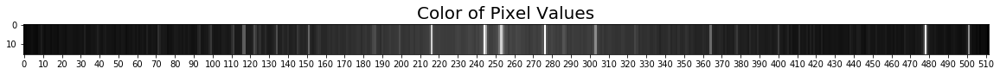

In [107]:
img_ice_stripe = [img_array_ice[250]] * 16
img_ice_stripe = np.array(img_ice_stripe)
plt.figure(figsize=(20,5))
plt.imshow(img_ice_stripe, cmap='gray')
plt.xticks(np.arange(0, 512, 10))
plt.title("Color of Pixel Values", fontsize=20)
plt.show()

The difference to regular diffraction images, that can be seen here, is that ice rings cause unusually bright pixel values close to the edge of the image. Ice rings are bright in general, and can overflow diffraction spots, so that less of them can be detected.

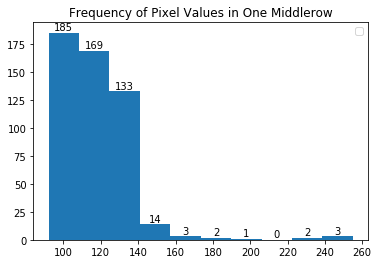

In [91]:
freq_row_ice, bins_row_ice, patches_row_ice = plt.hist(img_array_ice[250])
plt.title("Frequency of Pixel Values in One Middlerow")
annotate_hist(freq_row_ice, bins_row_ice, patches_row_ice)

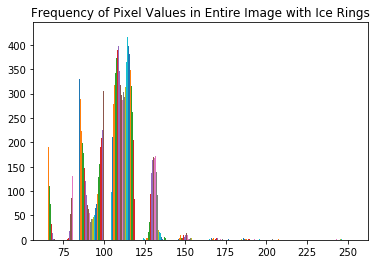

In [92]:
plt.hist(img_array_ice)
plt.title("Frequency of Pixel Values in Entire Image with Ice Rings")
plt.show()

The most pixels (95%) in the image with ice rings have a value between 90 and 140, which makes the image darker than the previous sample image with strong diffraction. Only 5-6 pixels have a value larger than 200. 

#### 3. Image with Smeared Spots (multilattice)

The overall pixel value distribution of the image with ice rings also shows that this image is darker and has only very few bright pixels.

(1, 512, 512, 1)


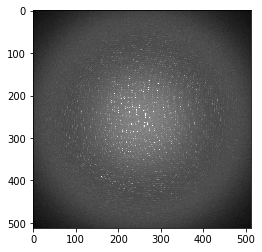

In [4]:
image_path_multi = "/data/hollatz/deep_learning/datasets/try2_gray_512_pgm/pgm/fake_00025.pgm"
img_array_multi = np.array(Image.open(image_path_multi))
img_0_multi = np.expand_dims(img_array_multi, axis=0)
img_multi = np.expand_dims(img_0_multi, axis=3)
print(img_multi.shape)
plt.imshow(img_array_multi.reshape(img_array_multi.shape[0], img_array_multi.shape[1]), cmap="gray")

In [109]:
img_array_multi[250]

array([128, 127, 127, 127, 124, 132, 130, 129, 130, 127, 132, 131, 137,
       131, 129, 130, 131, 132, 133, 137, 133, 135, 130, 136, 132, 131,
       133, 132, 132, 138, 138, 131, 137, 136, 133, 134, 136, 137, 138,
       134, 134, 138, 135, 133, 140, 135, 137, 136, 135, 133, 133, 141,
       136, 137, 139, 133, 136, 134, 133, 137, 140, 140, 139, 135, 141,
       136, 138, 145, 134, 136, 136, 135, 140, 136, 136, 130, 135, 137,
       133, 133, 133, 134, 137, 148, 137, 133, 135, 136, 138, 134, 140,
       136, 139, 131, 136, 137, 153, 139, 136, 137, 136, 145, 150, 139,
       139, 139, 143, 136, 138, 137, 138, 142, 140, 145, 156, 141, 141,
       147, 141, 140, 141, 143, 141, 142, 146, 141, 142, 144, 142, 142,
       145, 142, 145, 142, 146, 145, 143, 145, 145, 146, 147, 143, 149,
       150, 145, 147, 151, 148, 146, 149, 153, 147, 152, 155, 148, 150,
       151, 151, 153, 154, 156, 162, 161, 157, 158, 155, 153, 154, 149,
       158, 155, 155, 155, 192, 159, 161, 156, 156, 171, 177, 16

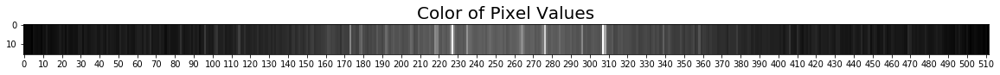

In [110]:
img_multi_stripe = [img_array_multi[250]]*16
img_multi_stripe = np.array(img_multi_stripe)
plt.figure(figsize=(20,5))
plt.imshow(img_multi_stripe, cmap='gray')
plt.xticks(np.arange(0, 512, 10))
plt.title("Color of Pixel Values", fontsize=20)
plt.show()

Here, a few bright spots can be seen in the middle of the image and some lines seem to be double. The double lines is an anticipated pattern in smeared or split spots.

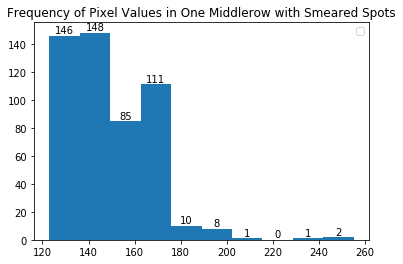

In [99]:
freq_row_multi, bins_row_multi, patches_row_multi = plt.hist(img_array_multi[250])
plt.title("Frequency of Pixel Values in One Middlerow with Smeared Spots")
annotate_hist(freq_row_multi, bins_row_multi, patches_row_multi)

The pixel values are brighter on average again with very few pixel values above ~175 (4%).

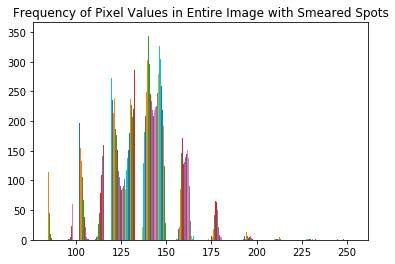

In [100]:
plt.hist(img_array_multi)
plt.title("Frequency of Pixel Values in Entire Image with Smeared Spots")
plt.show()

The pixel value distribution over the entire image with smeared spots looks similar. Most values are smaller than 180.

#### 4. Sample Image without Diffraction (blank)

(1, 512, 512, 1)


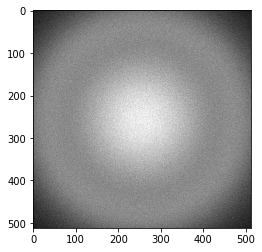

In [5]:
image_path_blank = "/data/hollatz/deep_learning/datasets/try1_original/png/fake_00010.png"
img_array_blank = np.array(Image.open(image_path_blank))
img_0_blank = np.expand_dims(img_array_blank, axis=0)
img_blank = np.expand_dims(img_0_blank, axis=3)
print(img_blank.shape)
plt.imshow(img_array_blank.reshape(img_array_blank.shape[0], img_array_blank.shape[1]), cmap="gray")

In [123]:
img_array_blank[250]

array([114, 112, 113, 114, 113, 117, 116, 116, 114, 115, 116, 116, 115,
       117, 117, 118, 118, 117, 117, 119, 119, 120, 119, 119, 116, 121,
       119, 117, 118, 119, 121, 120, 120, 118, 119, 123, 124, 121, 123,
       123, 119, 120, 122, 119, 120, 119, 123, 121, 120, 118, 120, 118,
       119, 118, 117, 120, 122, 118, 118, 121, 120, 119, 119, 122, 122,
       118, 121, 122, 120, 119, 120, 117, 119, 118, 119, 117, 120, 117,
       121, 121, 116, 118, 120, 120, 116, 119, 119, 120, 118, 117, 120,
       121, 119, 121, 121, 122, 120, 121, 121, 119, 118, 120, 119, 120,
       122, 121, 122, 123, 123, 127, 123, 123, 123, 123, 121, 127, 125,
       125, 122, 126, 126, 127, 126, 130, 129, 129, 127, 126, 127, 127,
       127, 127, 126, 127, 129, 127, 130, 129, 128, 131, 129, 130, 128,
       132, 129, 130, 128, 130, 135, 131, 133, 134, 135, 135, 133, 135,
       136, 135, 140, 136, 135, 133, 135, 137, 135, 138, 139, 135, 138,
       136, 139, 140, 141, 141, 136, 137, 139, 140, 139, 142, 14

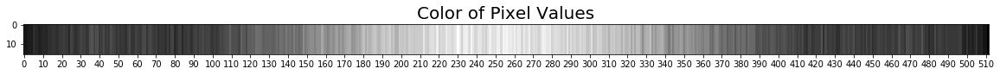

In [126]:
img_blank_stripe = [img_array_blank[250]] * 16
img_blank_stripe = np.array(img_blank_stripe)
plt.figure(figsize=(20,5))
plt.imshow(img_blank_stripe, cmap='gray')
plt.xticks(np.arange(0, 512, 10))
plt.title("Color of Pixel Values", fontsize=20)
plt.show()

The pixel values form more of a gradient from the middle to the edges, than sharply separated lines as before.

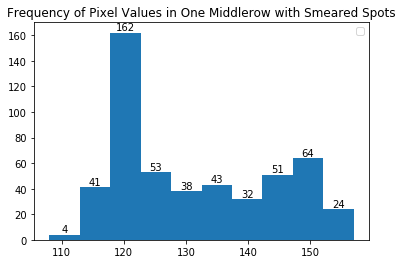

In [127]:
freq_row_blank, bins_row_blank, patches_row_blank = plt.hist(img_array_blank[250])
plt.title("Frequency of Pixel Values in One Middlerow with Smeared Spots")
annotate_hist(freq_row_blank, bins_row_blank, patches_row_blank)

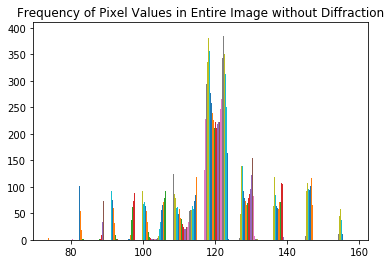

In [128]:
plt.hist(img_array_blank)
plt.title("Frequency of Pixel Values in Entire Image without Diffraction")
plt.show()

Both distributions of the blank smaple image are very different compared to the other images, even though the most values are around 120 on average. Here, the distributions are well balanced and not skewed to the right. No values are larger than 160. Based on these results, it can be concluded that the majority of the pixel values (between 80 to 160) in diffraction images belong to the background.

In summary, there are a few patterns I would expect to show up when displaying filters or feature maps of prediction models. In general, the most diffraction spots can be found in the middle of the image. Diffraction spots only occupy 1 to 3 or 4 pixels and are surrounded by a darker, contrasting shape of gray. Ice rings are often very bright values in larger areas of pixels next to each other and often occur closer to the edges of the image. Smeared or split spots show more pixels of similar brightness next to each other and may show a doubled or trippled pattern within a few pixels. However, analyzing 3 different diffraction images and their pixel value distributions made clear, that diffraction images in general are highly versatile within each category and the pattern that have the potential to distinguish categories are small. In the next two sections, I will introduce the used models and display samples of their convolutional filters and feature maps. 

### Previously Trained Classifiers

The key to successfully train models on this more complex dataset was to apply transfer learning with a model trained on a simpler dataset. To transfer those weights the architectures had to be the same. For that reason, all classifiers that will be analyzed here are based on the VGG16 architecture. The used optimizer is Adam, and the learning rates varied between 0.001 and 0.0001. The models were trained over 20 epochs with a batchsize of 32.
<br><br>
3 different models will be analyzed:
<ol>
<li>model_try2_multitask: <br>Multitask learning model that predicts the 6 categories (blank, photo1, photo2, multilattice, ice, badice) and the 2 continuous values (mosaic1, mosaic2)</li>
<li>model_binary_ice: <br>Binary classifier that predicts the occurence of ice diffraction in addition to protein diffraction. Particular patterns of ice rings may damage the detector, so that it is important to detect those.</li>
<li>model_binary_multi: <br>Binary classifier that predicts the occurence of smeared spots that can be a processing challenge for currently available chrystallographic software and jeoperdize the integrety of experimental results.</li>
</ol>
For reference purposes, the simple classifier whose weights were used for transfer learning, will be displayed first. The model is called model_try1_classifier.

In [119]:
# loading the models
model_try1_classifier = tf.keras.models.load_model("/home/hollatz/projects/deep_learning/development/CSCL4622/VGG16_categorical_try1.h5")

In [6]:
model_try2_multitask = tf.keras.models.load_model("/home/hollatz/projects/deep_learning/development/CSCL4622/multitask_VGG16_transfer.h5")

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use tf.cast instead.


In [3]:
model_binary_ice = tf.keras.models.load_model("/home/hollatz/projects/deep_learning/development/CSCL4622/VGG16_binary_ice_transfer_last_2_ConvBlock.h5")

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


In [116]:
model_binary_multi = tf.keras.models.load_model("/home/hollatz/projects/deep_learning/development/CSCL4622/multilattice_binary_cls_VGG16_transfer.h5")

### Visualization of Filters and Feature Maps

In each convolutional layer, small linear filters, called kernels, are applied to 2-d input images (or feature maps from previous convolutional layers) and the output is a feature map. I am interested in visualizing both, the kernels and the feature maps. 

In [7]:
# plotting the filters as 2d images by accessing each convolutional layer
# each convolutional layer has 2 sets of weights, 1 for filters and 1 for biases
# display first 5 filters in each convolutional layer
# dark squares have small pixel values / weights (0 is black)
# white squares have large pixel values / weights (255 is white)
def display_filter(model):
    for layer in model.layers:
    # check if conv layer
        if 'conv' not in layer.name:
            continue
        orig_filters, biases = layer.get_weights()
        
        f_min, f_max = orig_filters.min(), orig_filters.max()
        filters = (orig_filters - f_min)/(f_max-f_min)
        fig = plt.figure(figsize=(20,4))
        plt.title(str(layer.name) + " " + str(orig_filters.shape), fontsize=20)
        n_filters, ix = 5, 0
        for i in range(n_filters):
            # get the filter
            fig.add_subplot(1,5,ix+1)
            f = filters[:,:,:, ix]
            plt.imshow(f[:,:,0], cmap='gray')
            ix+=1
    plt.show()

In [8]:
def display_featureMaps(model, img, block, fig):
    maps = model.predict(img)
    square = 8
    jx = 1
    print("block: ", block+1)
    print(model.summary())
    for _ in range(square):
        for _ in range(square):
            # specify subplot and turn of axis
            fig.add_subplot(8, 8, jx)
            # plot filter channel in grayscale
            plt.imshow(maps[0, :, :, jx-1], cmap='gray')
            jx += 1
    # show the figure
    plt.show()

In [9]:
def display_mapsPerBlock(model, img):
    # display feature maps after each block of convolutional layers
    model_block1 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[2].output)
    model_block2 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[5].output)
    model_block3 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[9].output)
    model_block4 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[13].output)
    model_block5 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[17].output)

    models = [model_block1, model_block2, model_block3, model_block4, model_block5]
    for k in range(len(models)):
        fig = plt.figure(figsize=(20, 20))
        display_featureMaps(models[k], img, k, fig)

To extract the feature maps, an input image needs to pass through the network. I chose 3 different sample images to analyze their pixel distribution and to gain some insights of potential differences for regular diffraction, smeared spots and ice rings that I expect to find some representation in the convolutional filters.

#### Reference Classifier with 5 Categories (blank, no-crystal, weak, good, strong) whose weights were used for transfer learning

In [20]:
# The VGG16 architecture consists of 13 convolutional layers, bundled in 5
# separate blocks.
model_try1_classifier.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0         
__________

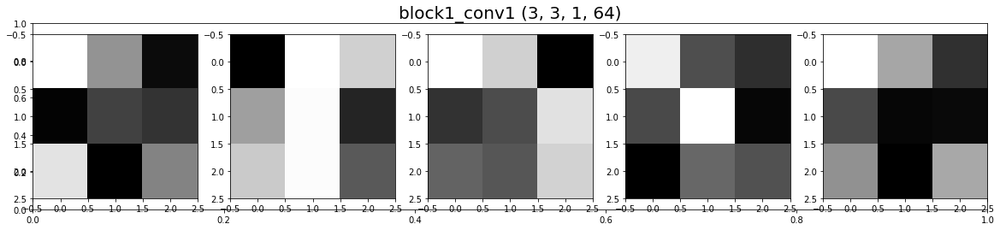

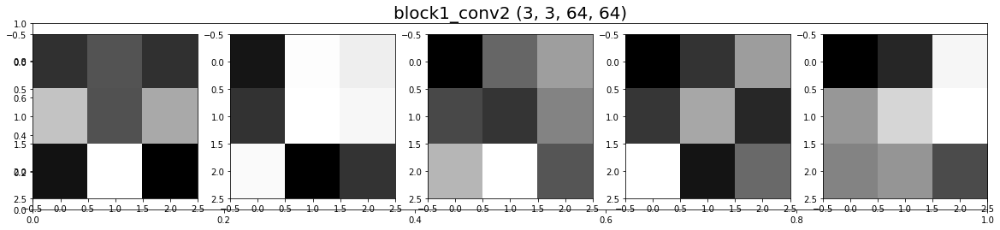

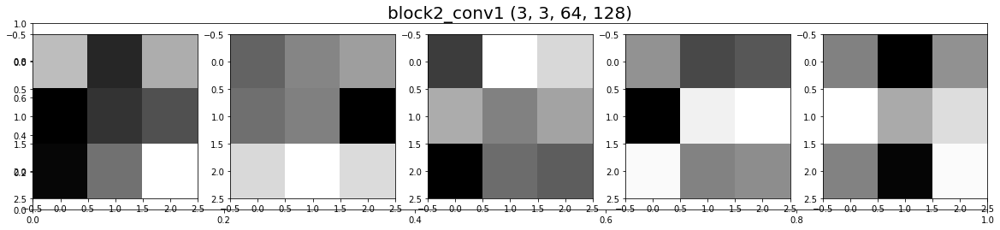

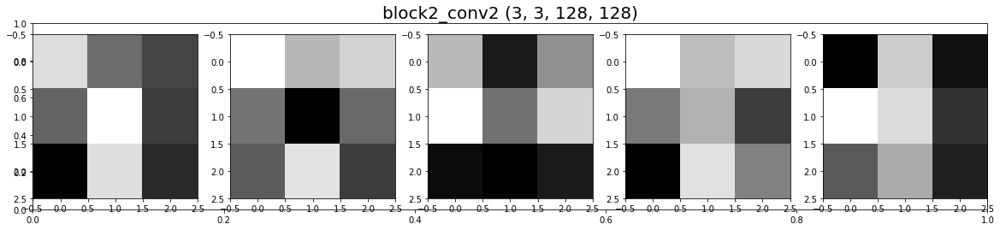

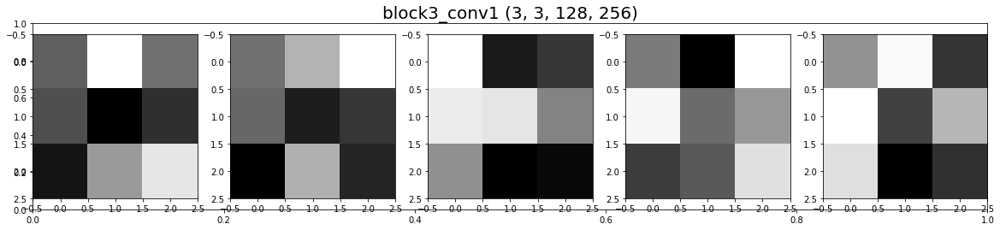

...

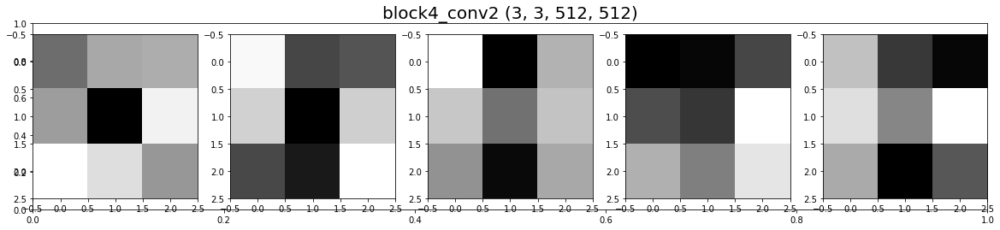

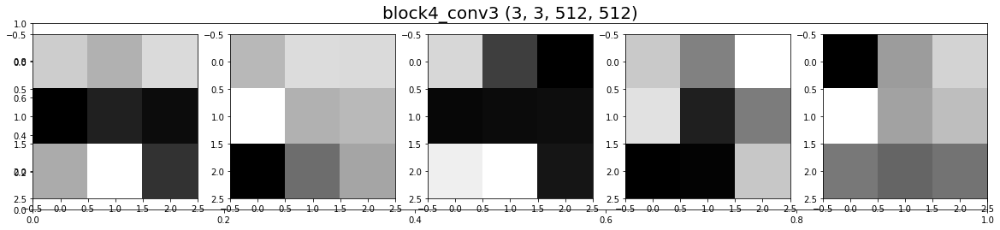

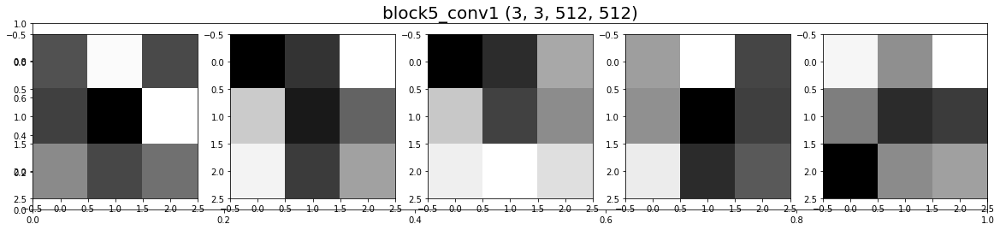

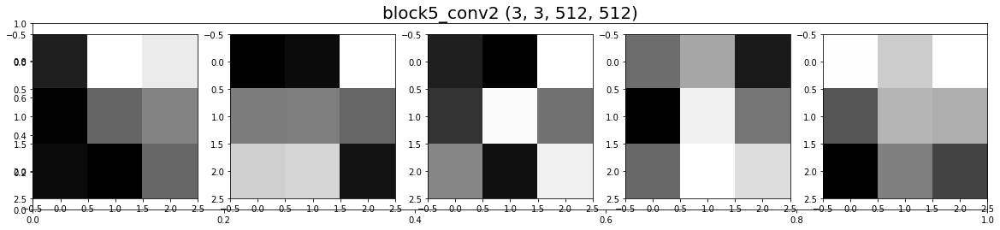

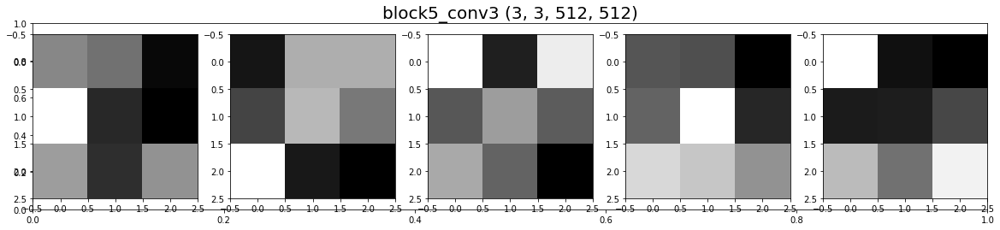

In [35]:
display_filter(model_try1_classifier)

Only 5 filters out of 64, 128, 256 and 512 are displayed, so that it is important to notice that the model is a lot more complex than displayed here. In total, 65 filters are displayed, the first 5 for each convolutional layer. Usually, the filters become more elaborate with layer depth, but I find it difficult to determine an evolution in detail. 

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 37,568
Non-trainable params: 0
_________________________________________________________________
None


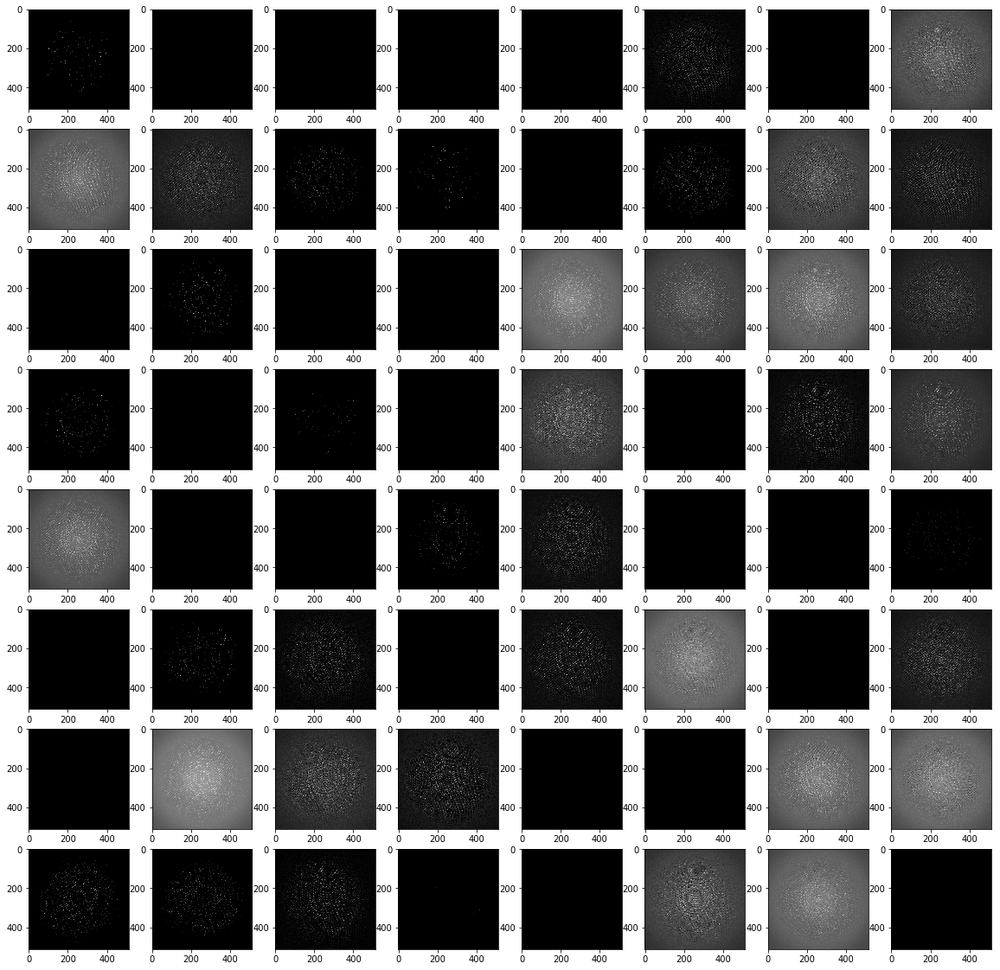

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 259,008
Non-trainable params: 0
_______________________________________________________

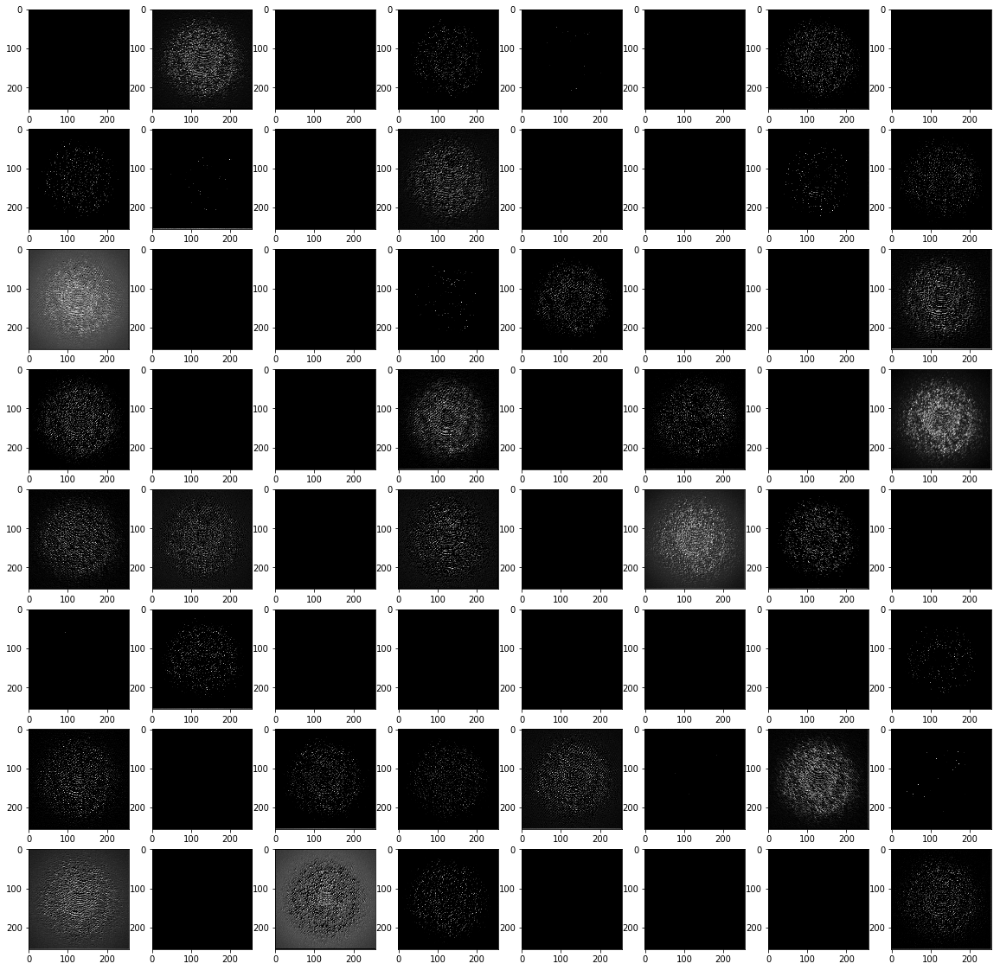

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

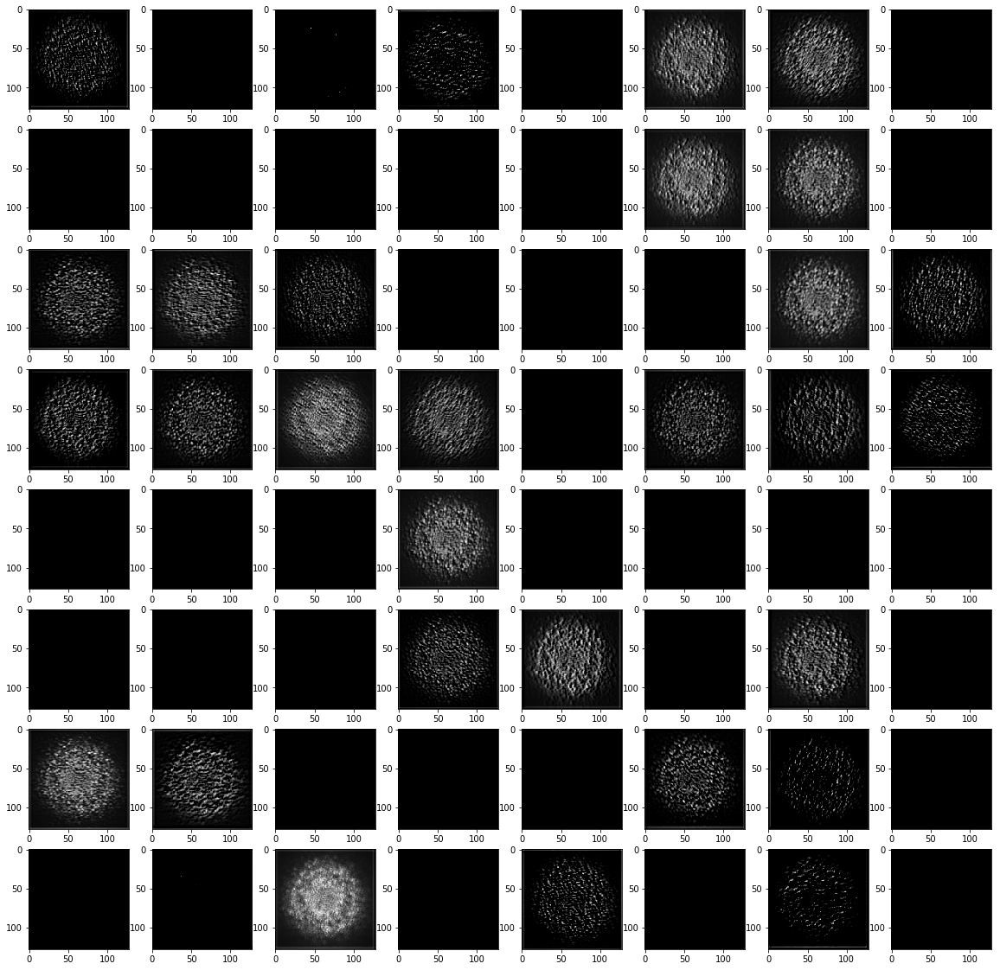

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

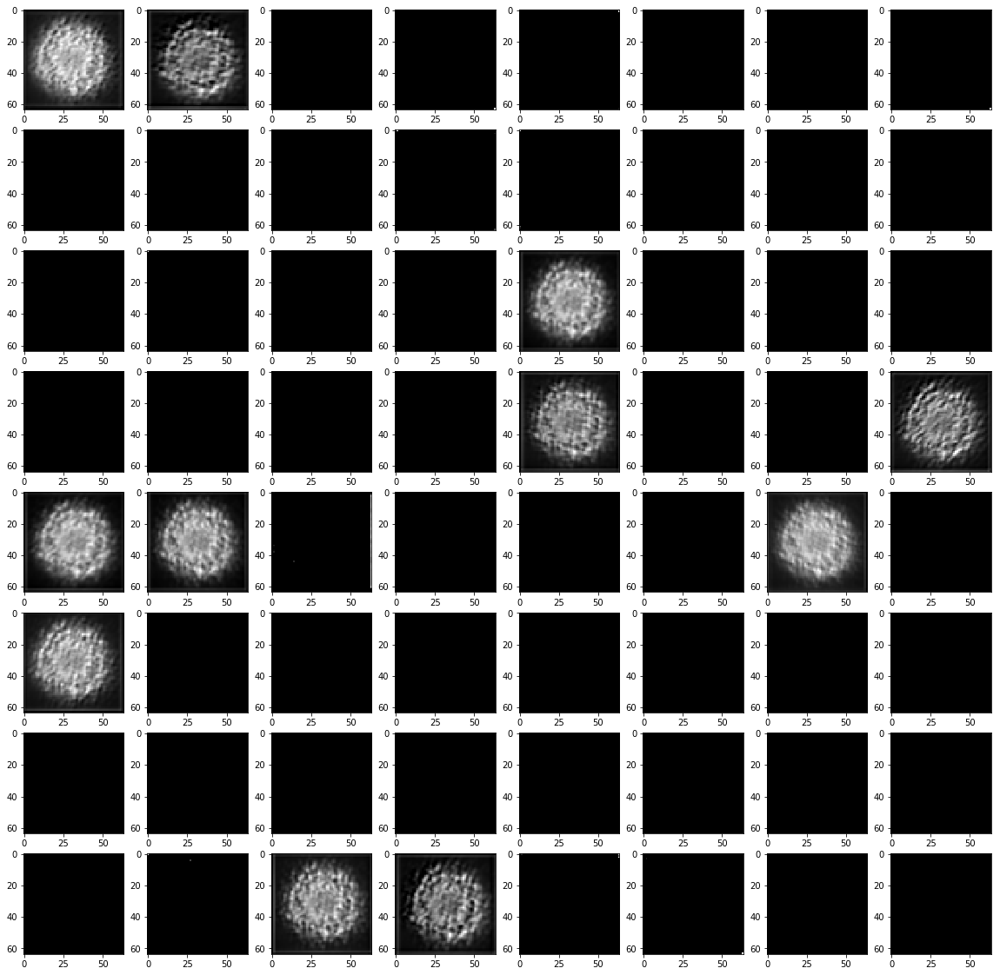

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

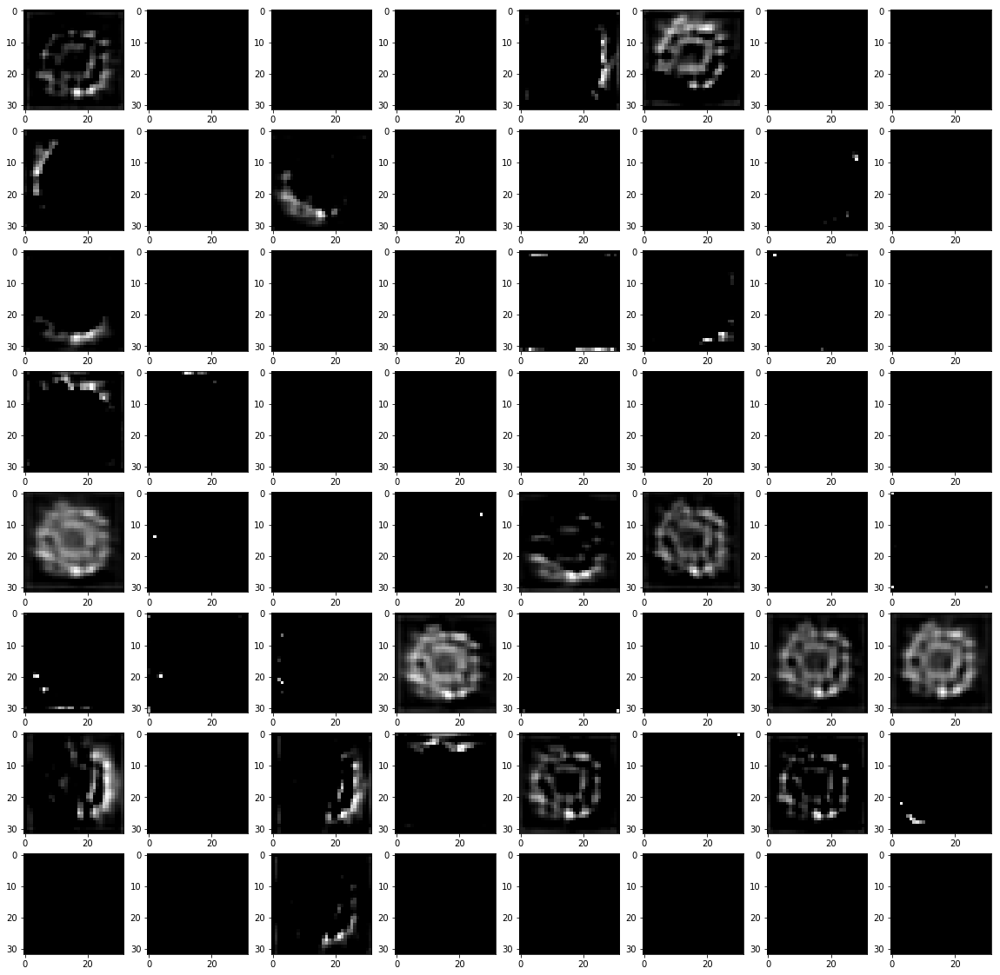

In [120]:
display_mapsPerBlock(model_try1_classifier, img_strong)

The first 64 features maps of each of the 5 convolutional blocks are downsampled and displayed. They resulted from inputting an image with strong diffraction pattern, and show more and more elaborate structures. The black feature maps can represent dead weights that do not influece the prediction.

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 37,568
Non-trainable params: 0
_________________________________________________________________
None


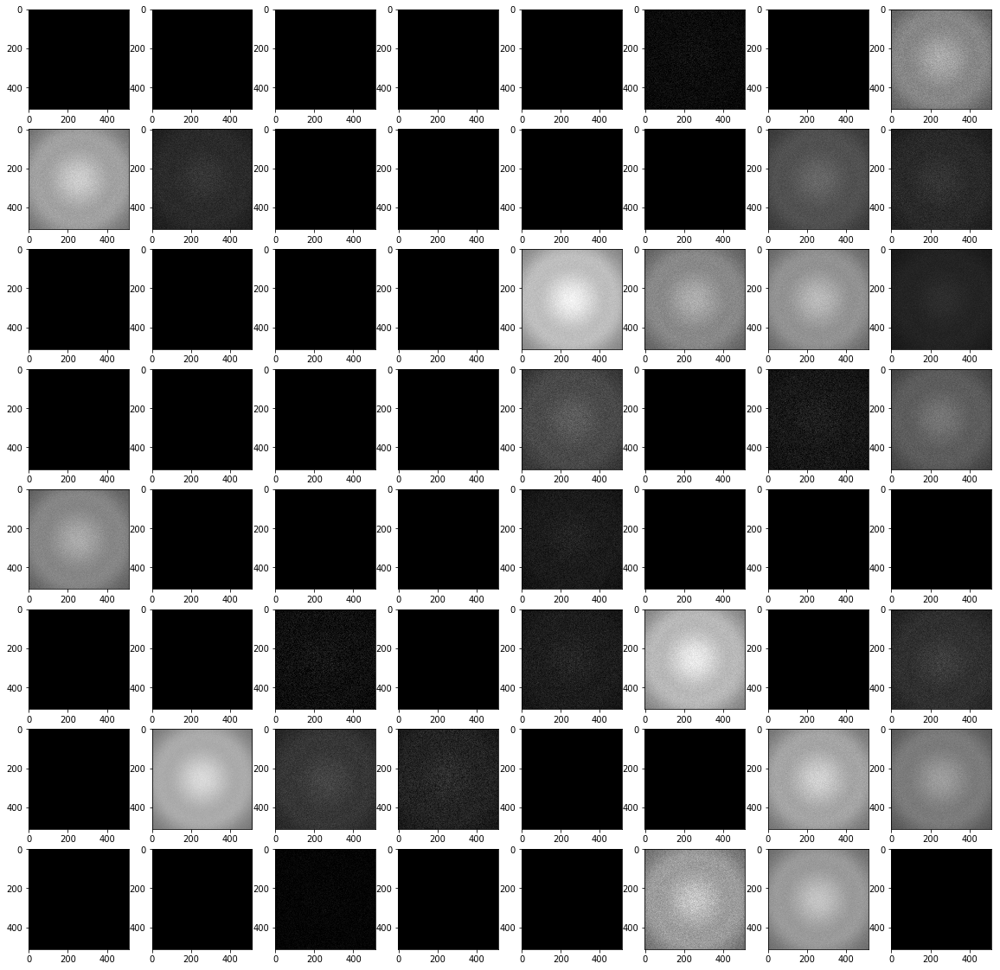

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 259,008
Non-trainable params: 0
_______________________________________________________

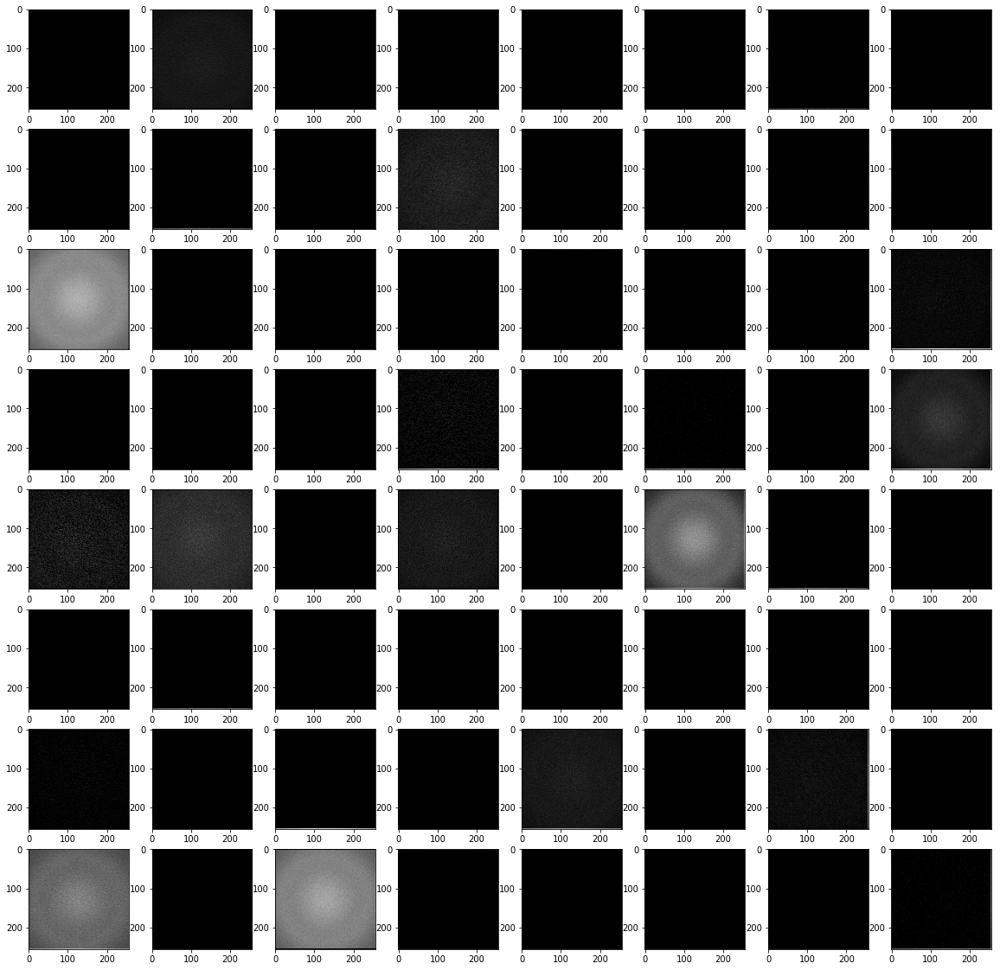

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

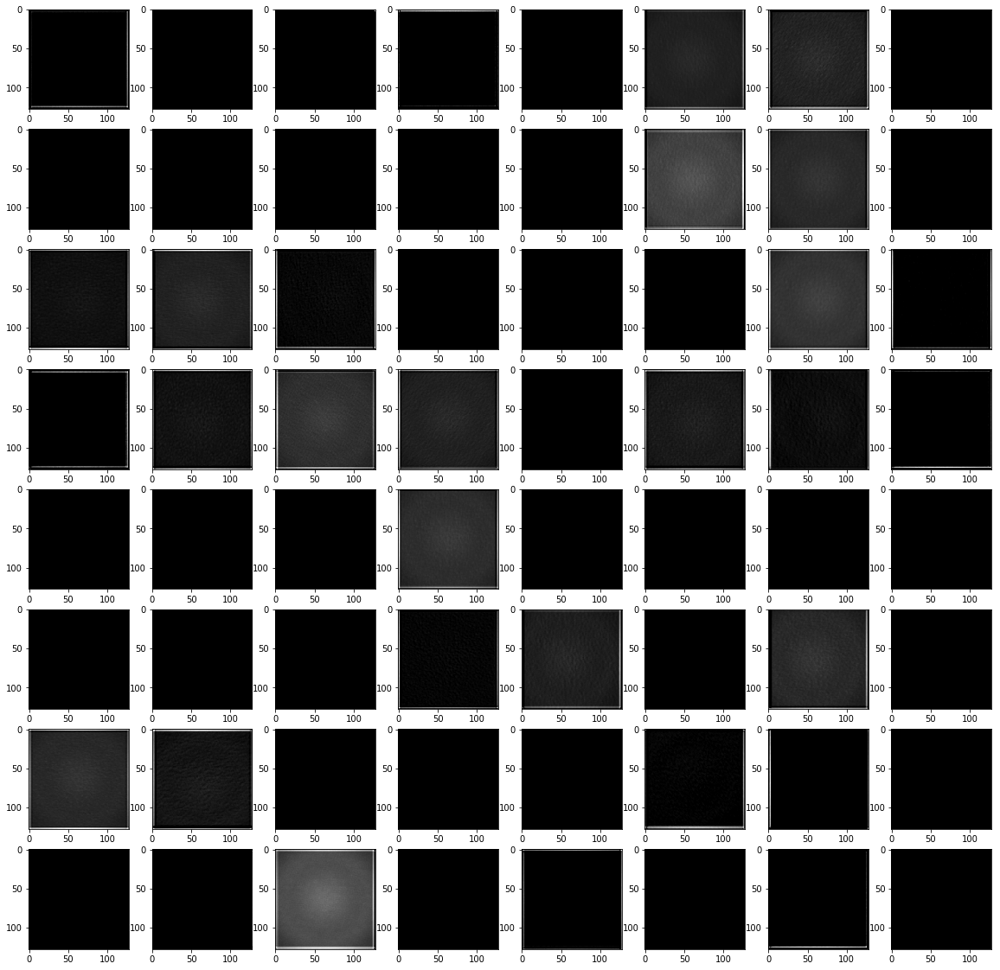

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

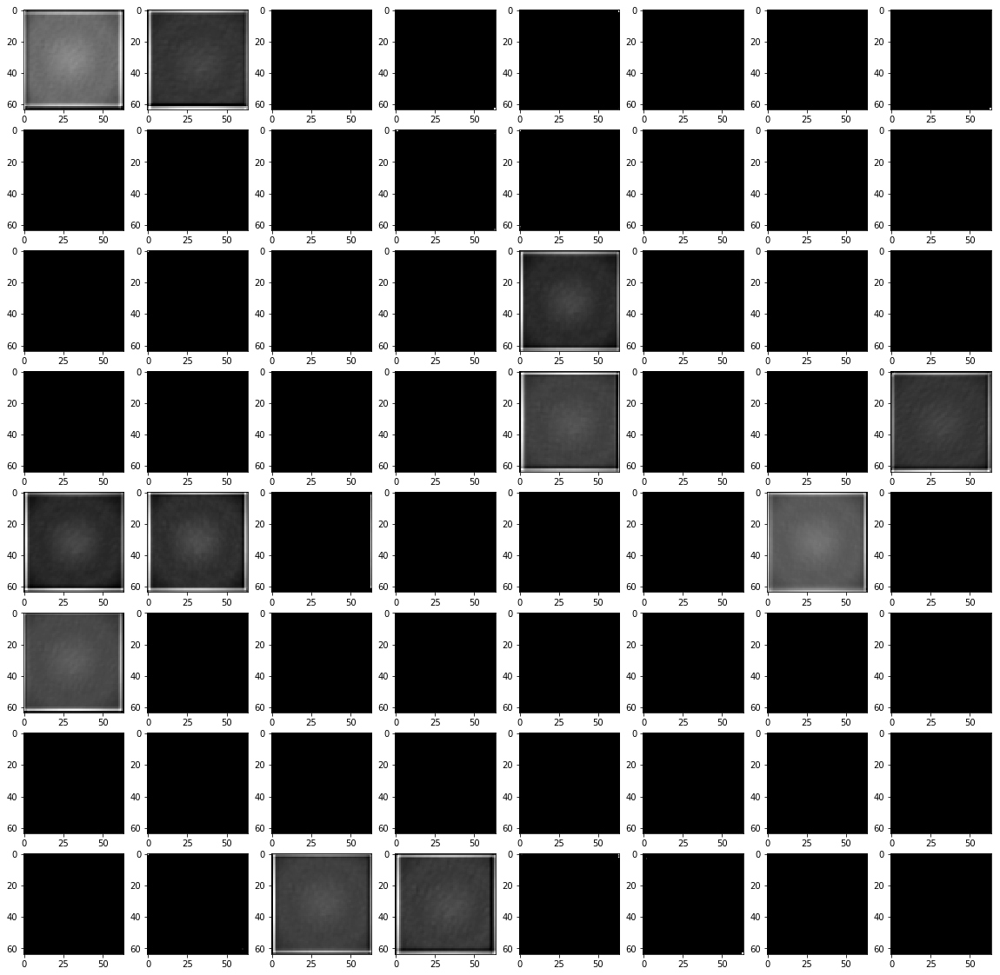

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

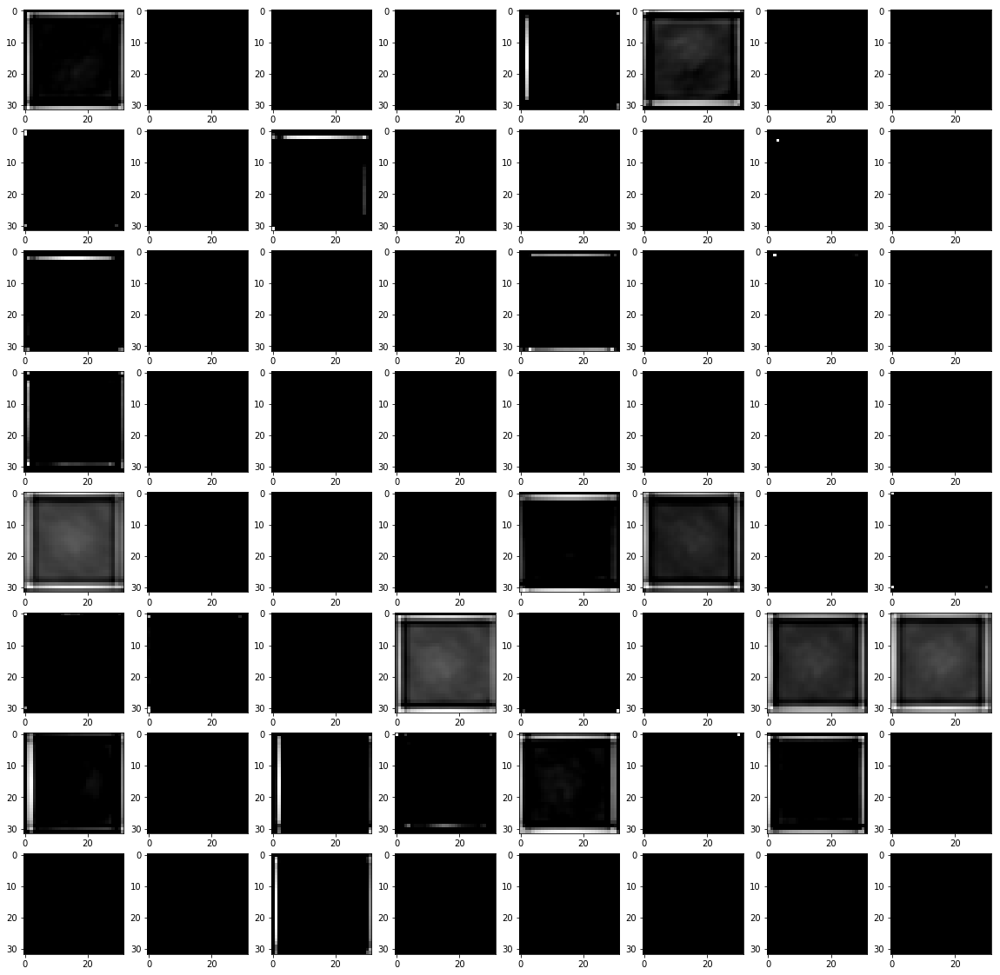

In [129]:
display_mapsPerBlock(model_try1_classifier, img_blank)

Here, the same classifier is fed a blank image, which resulted in very different feature maps. After the final block the feature maps are eiser black or show different shades of gray within a brighter frame. There is no diffraction displayed which matches the input image.

#### 1. Multitask Model with 6 Categories (blank, photo1, photo2, multilattice, ice, badice) and 2 continuous values (mosaic1, mosaic2)

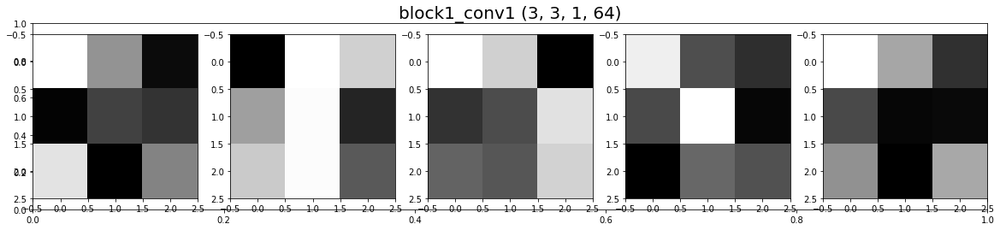

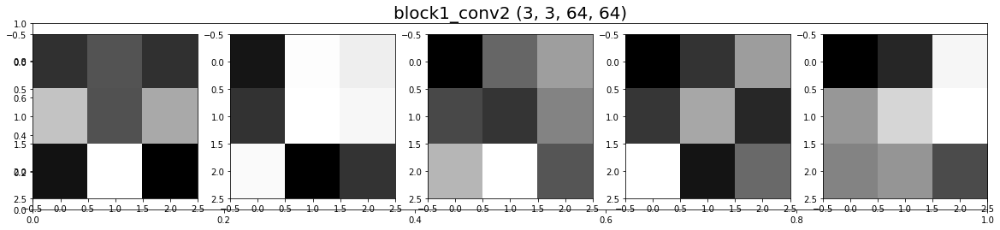

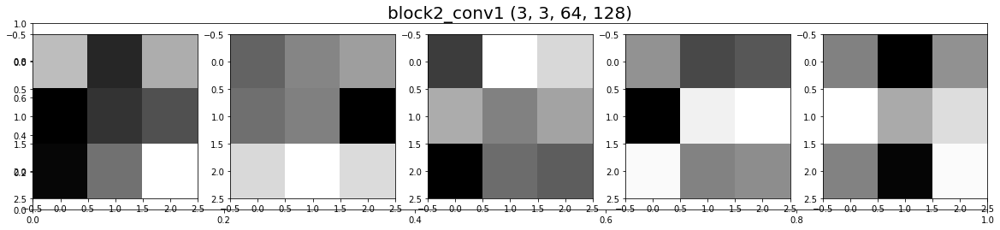

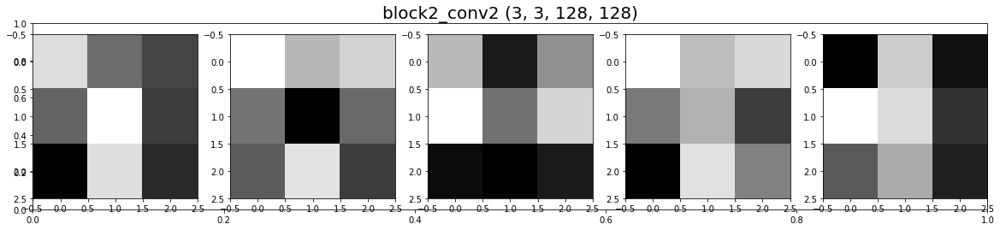

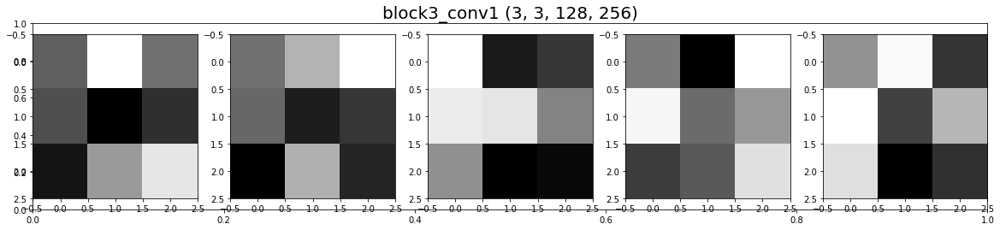

...

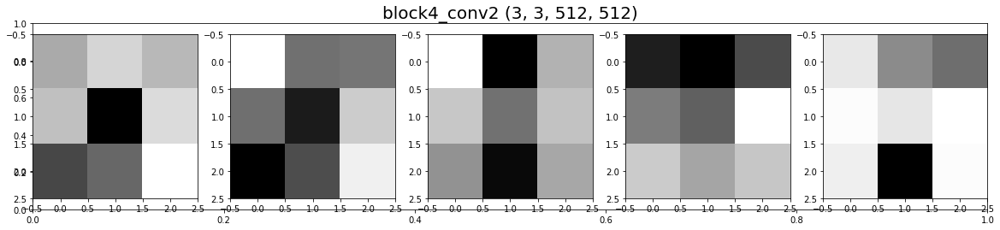

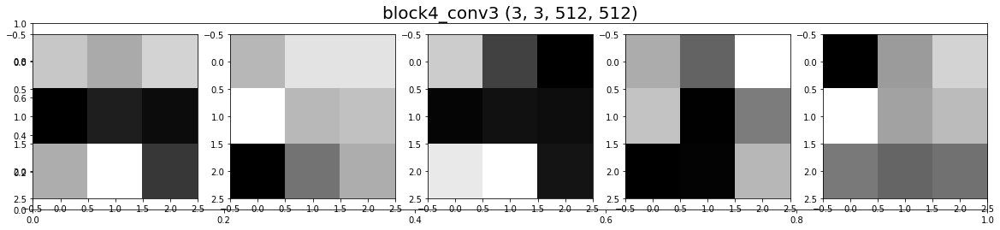

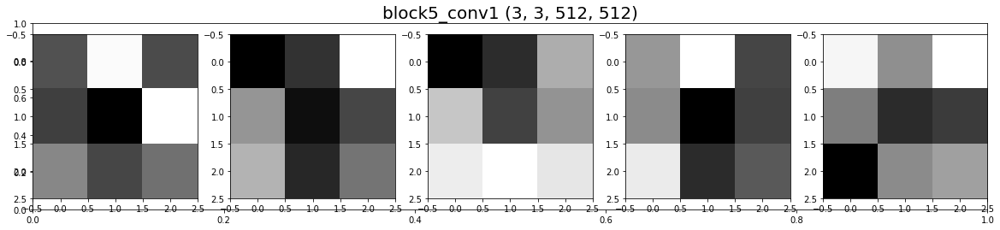

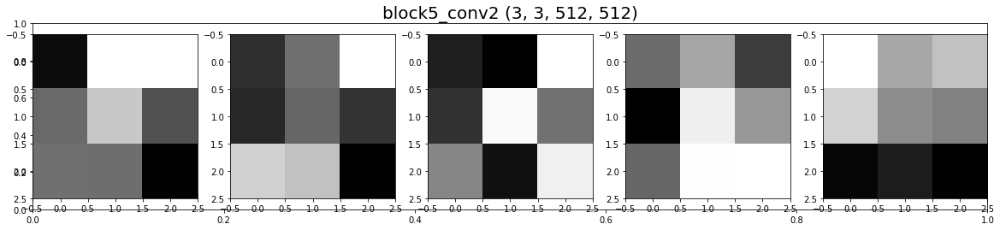

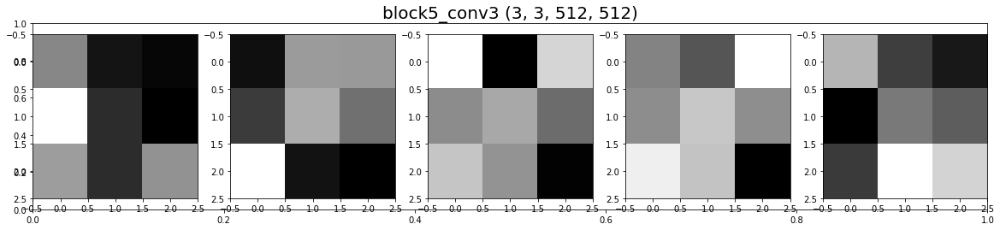

In [42]:
display_filter(model_try2_multitask)

The filters, again, are difficult to interpret and look very similar in each layer and also compared with the previous reference model.

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


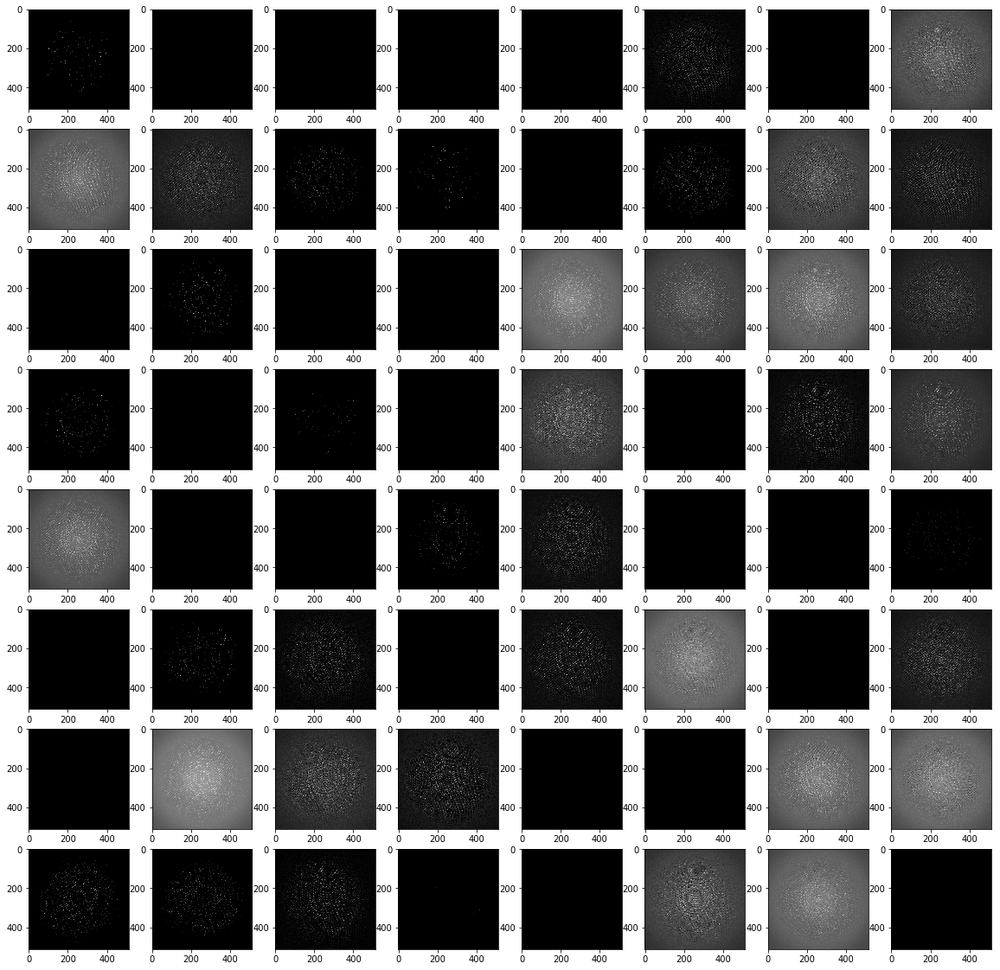

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

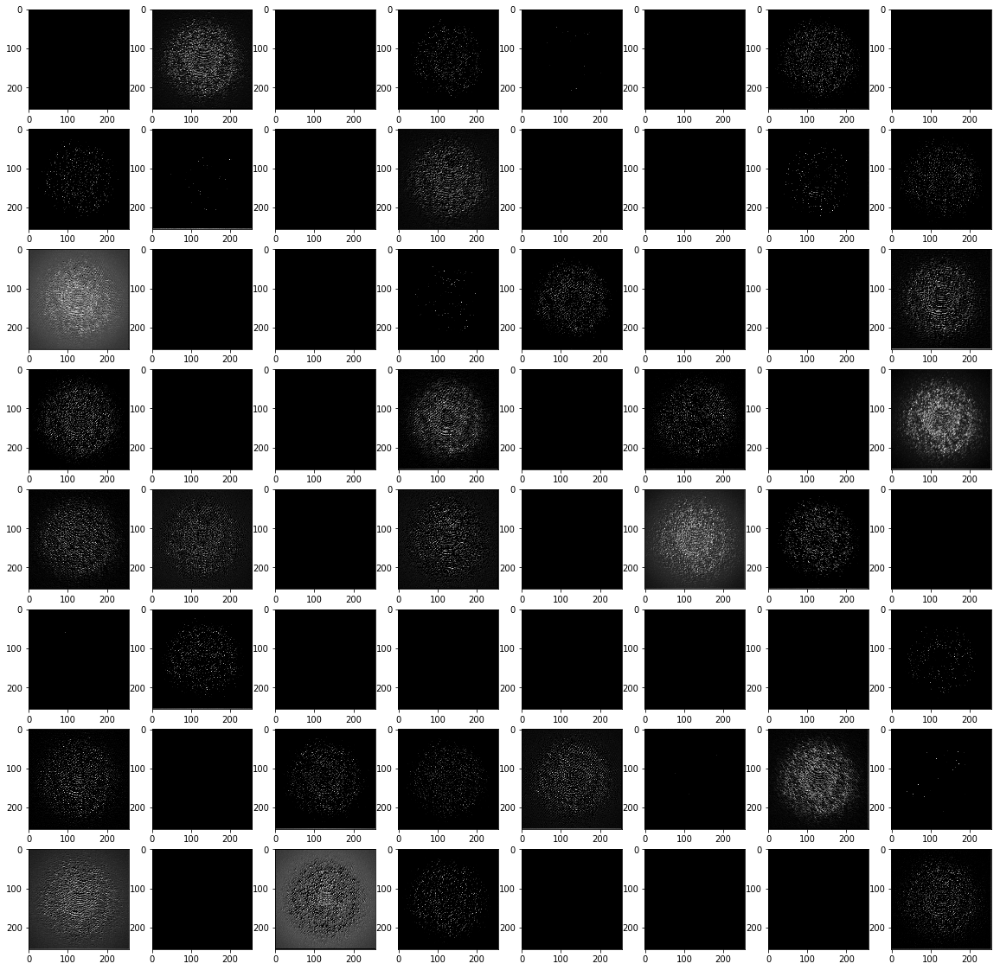

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

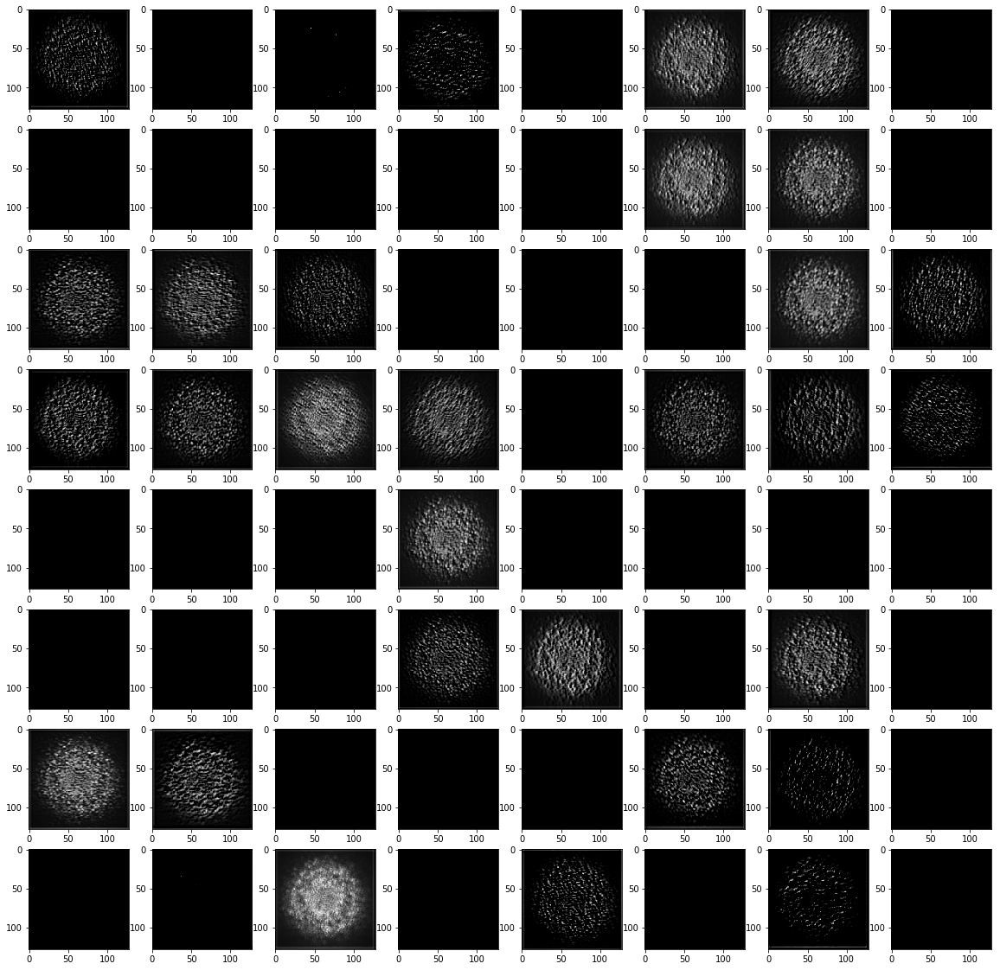

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

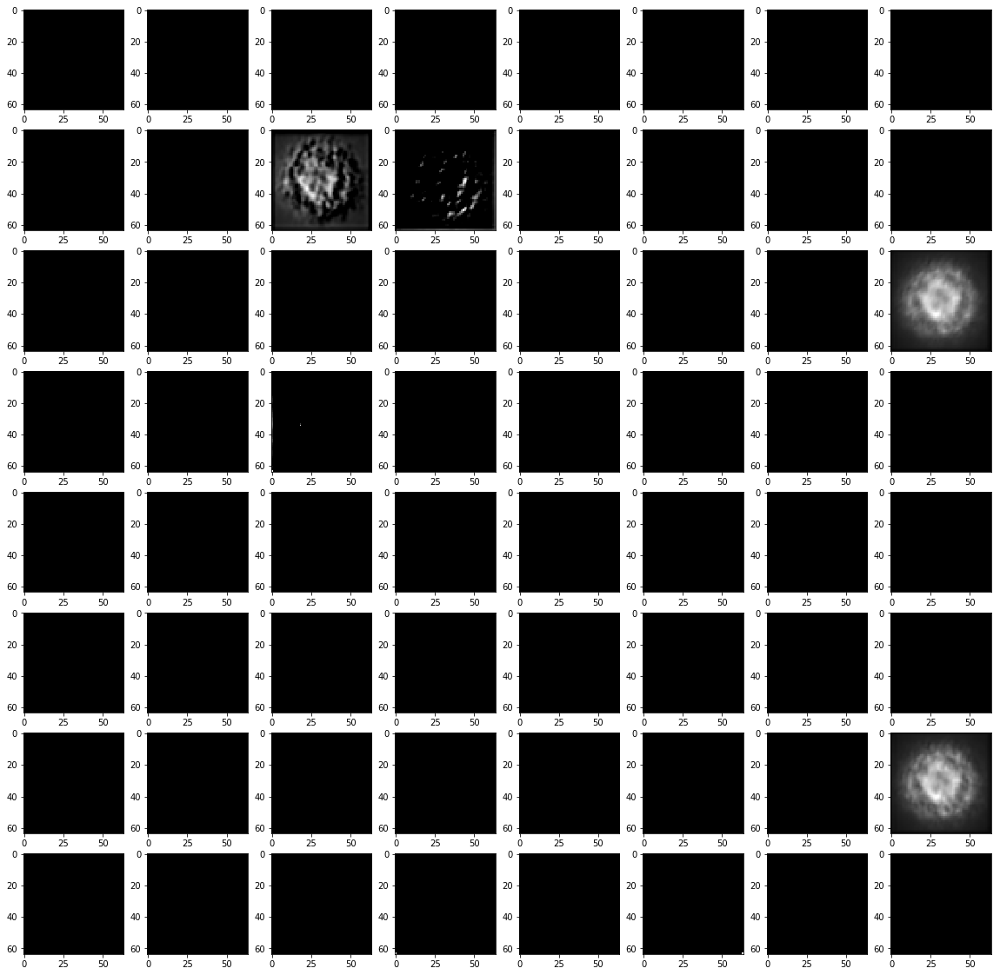

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

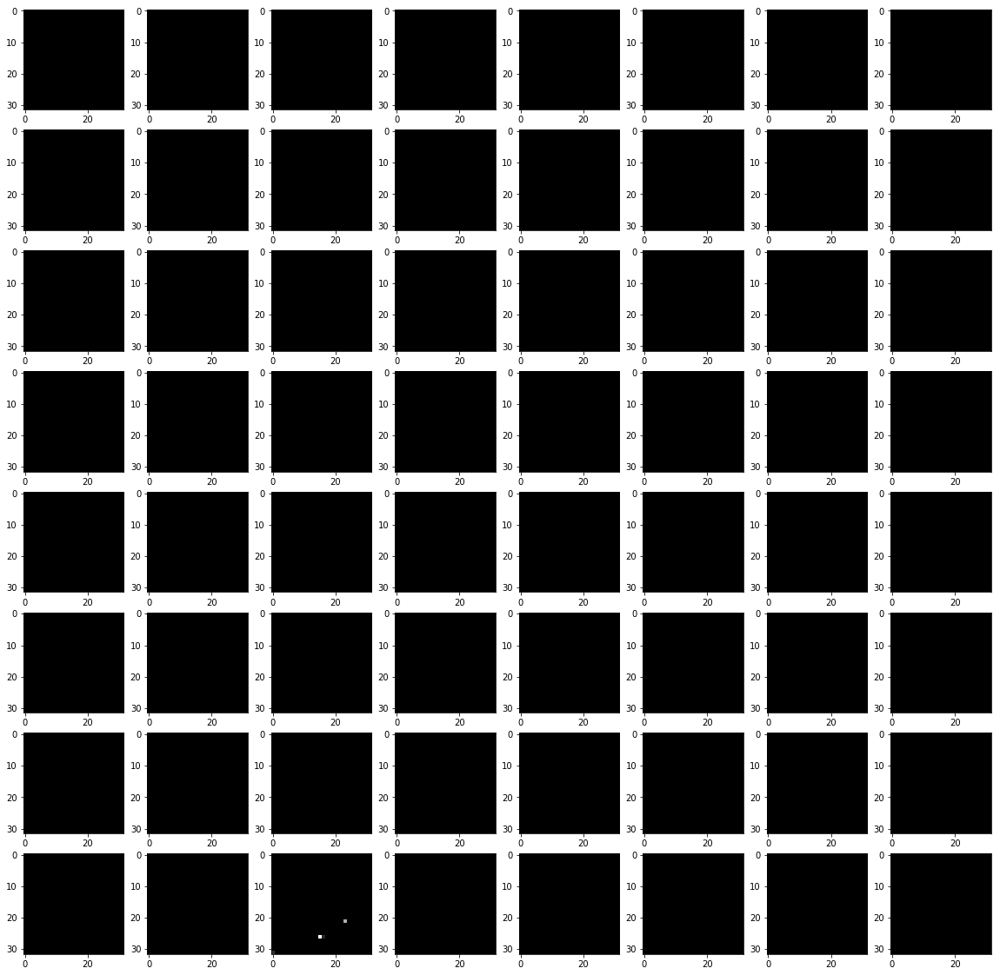

In [10]:
display_mapsPerBlock(model_try2_multitask, img_strong)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


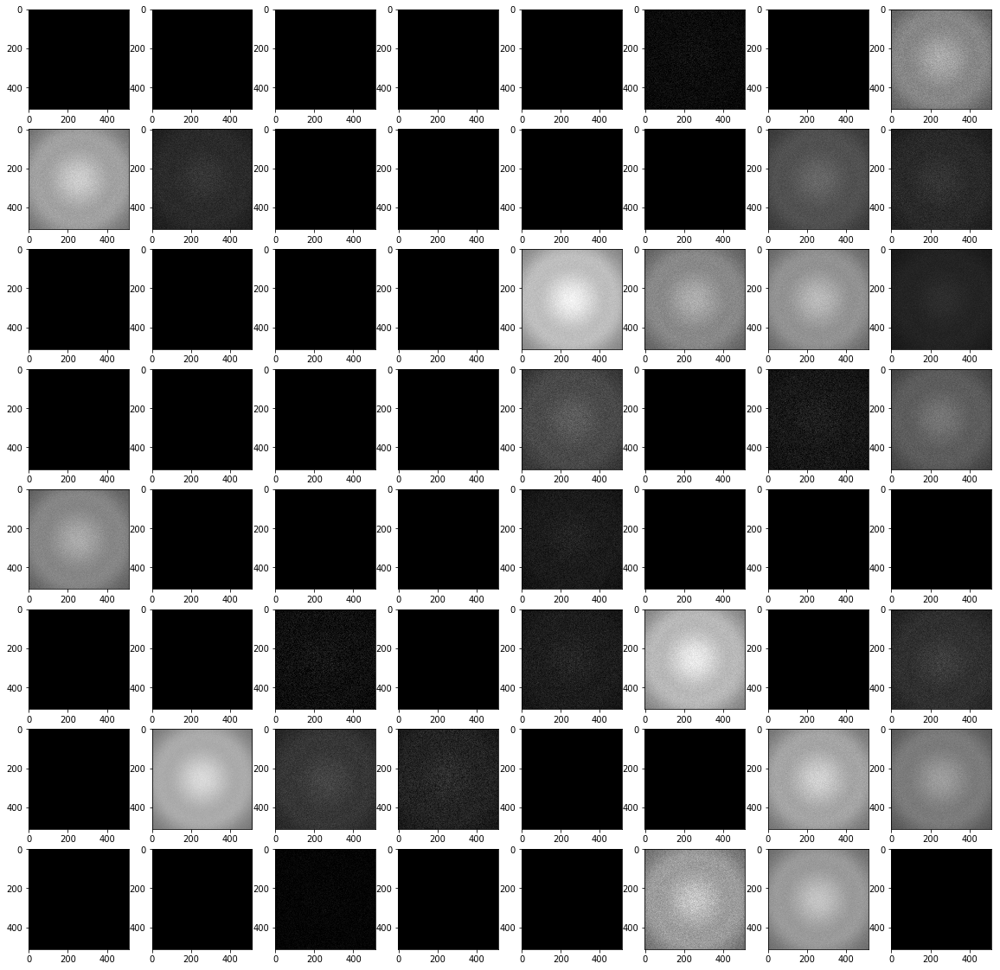

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

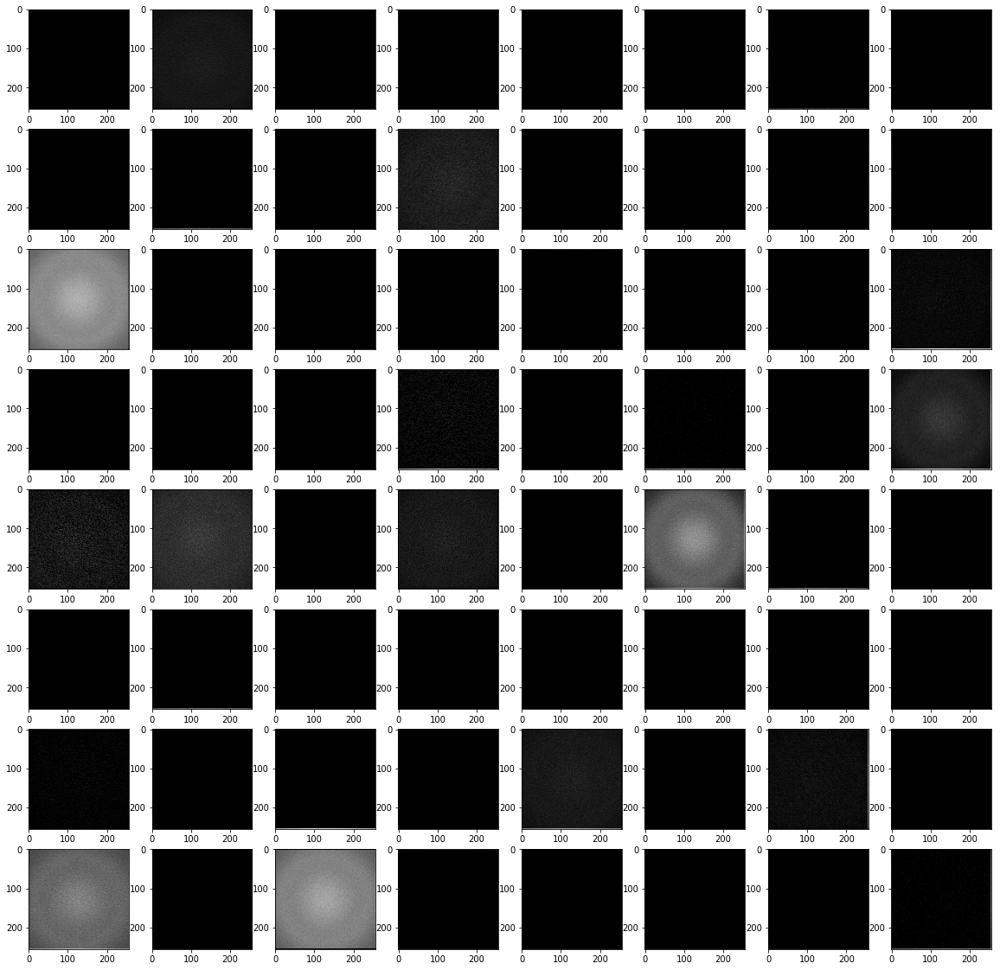

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

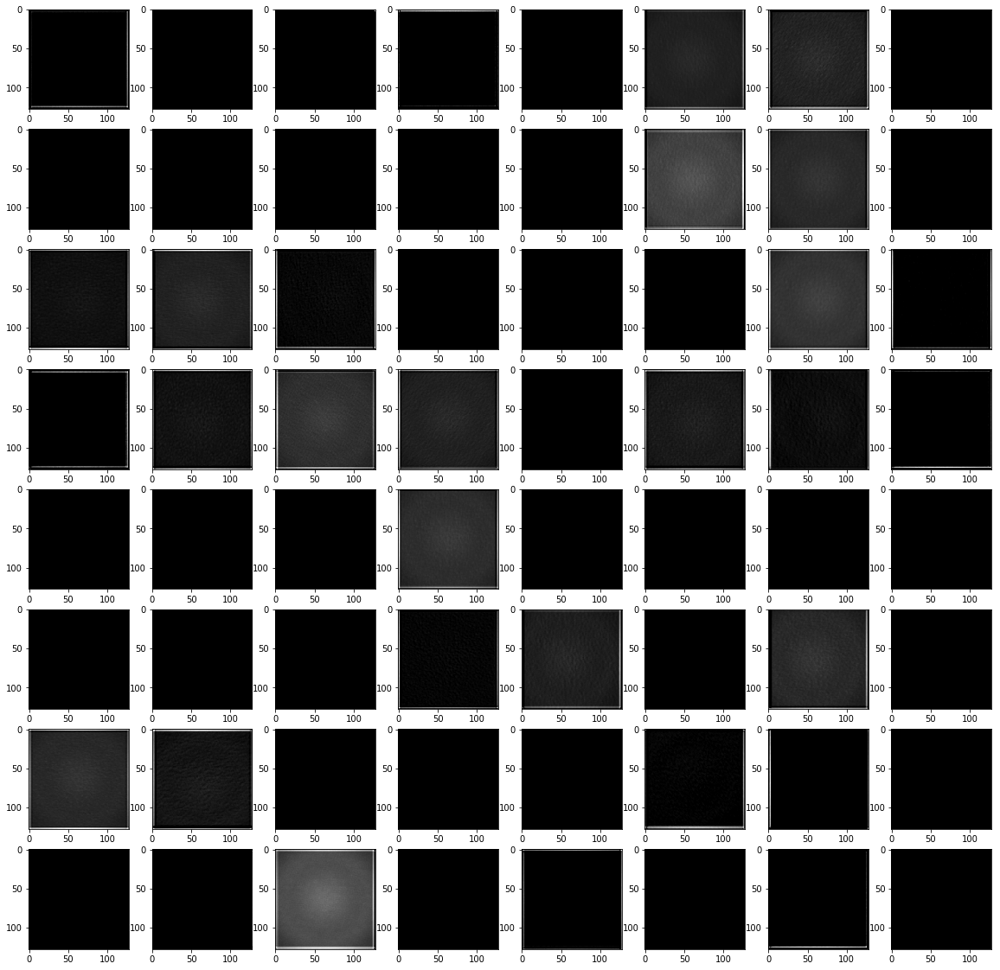

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

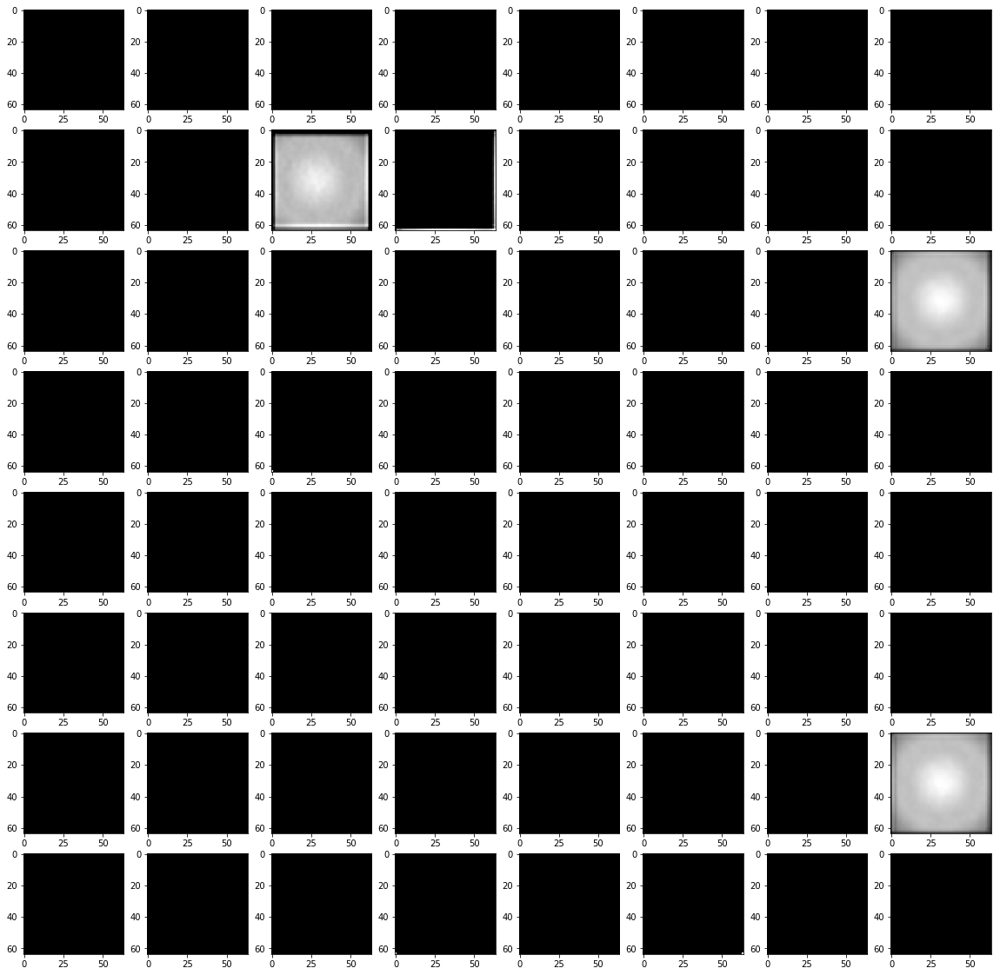

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

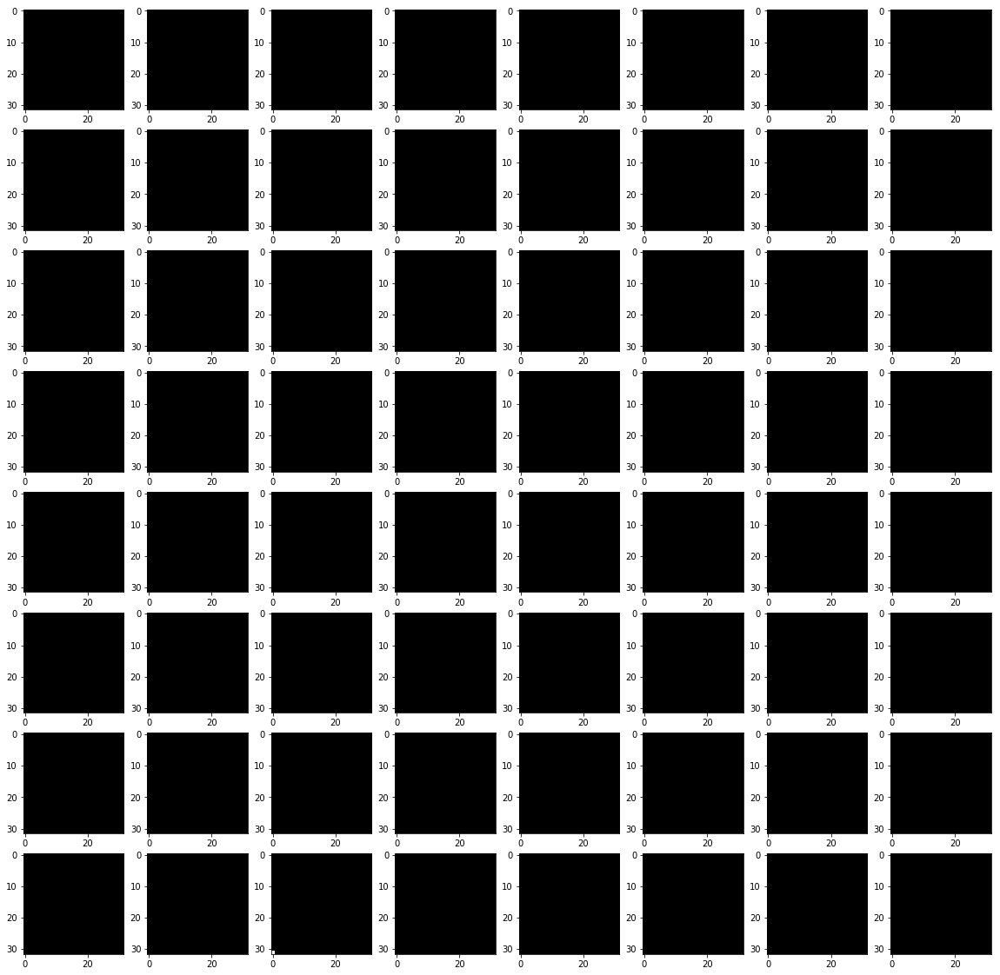

In [11]:
display_mapsPerBlock(model_try2_multitask, img_blank)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


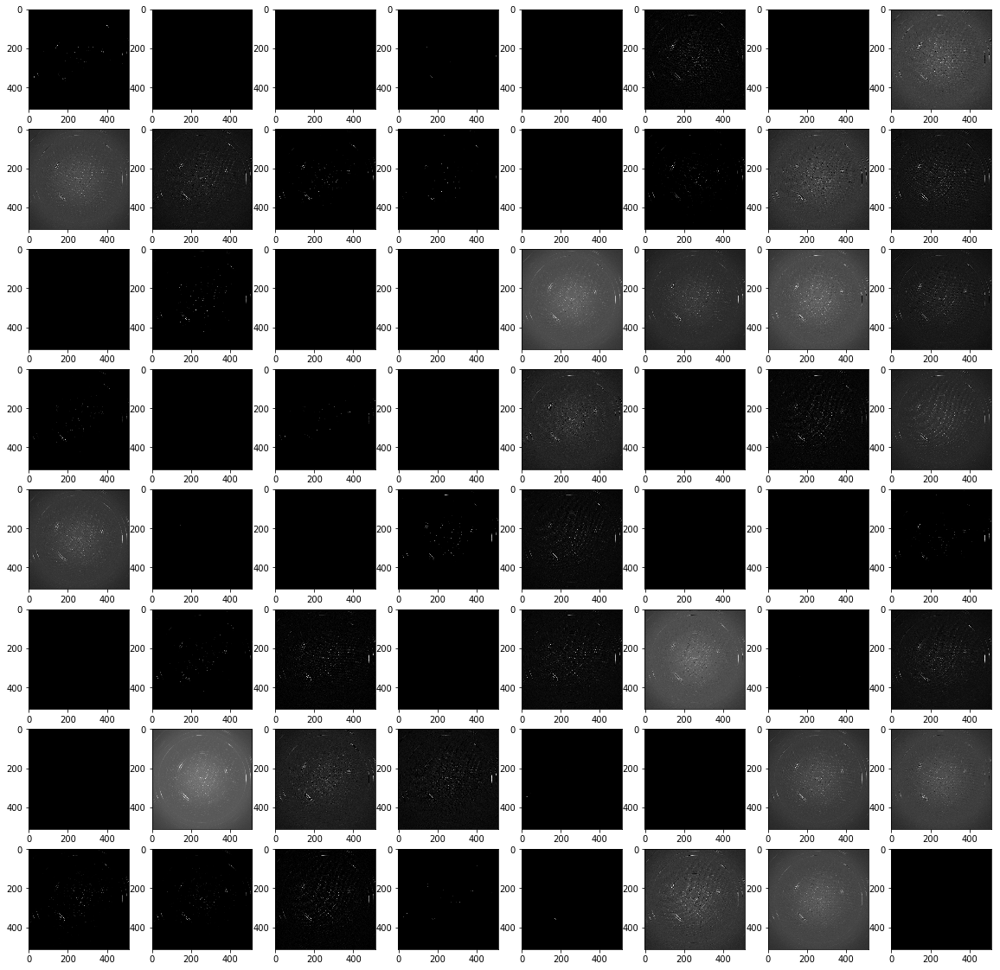

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

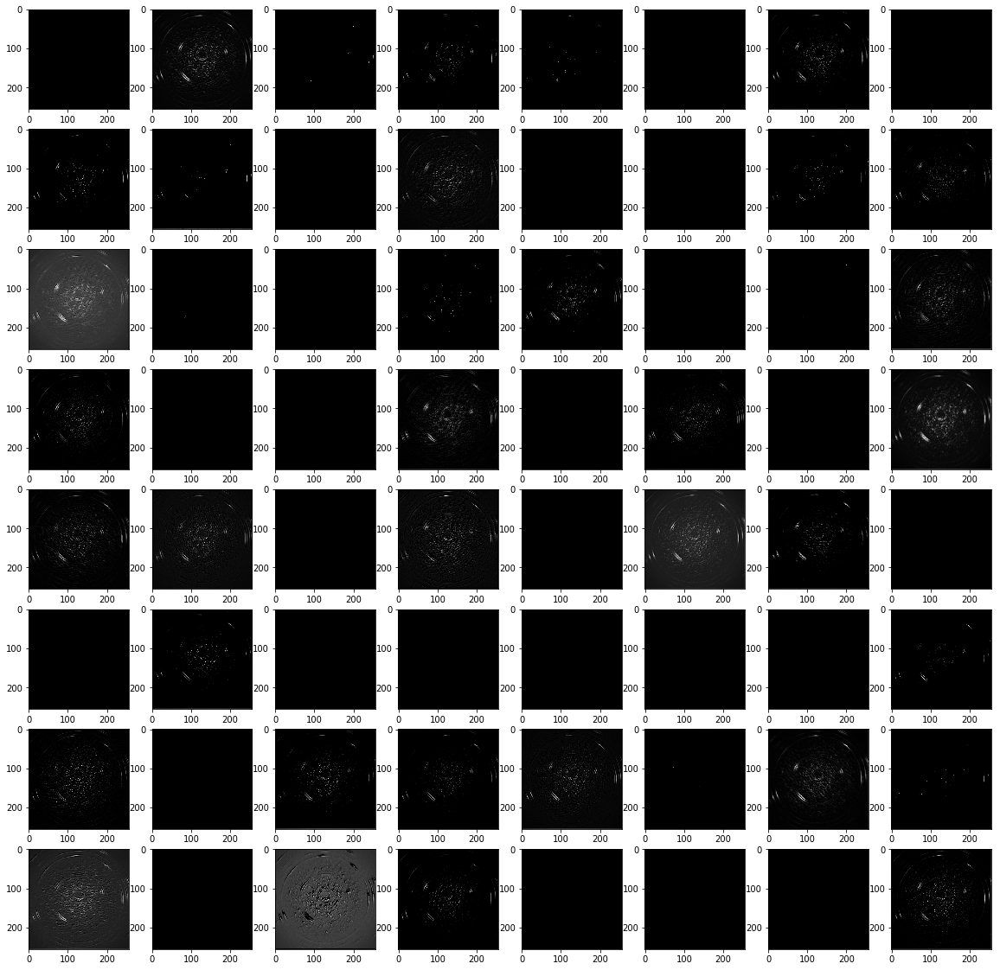

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

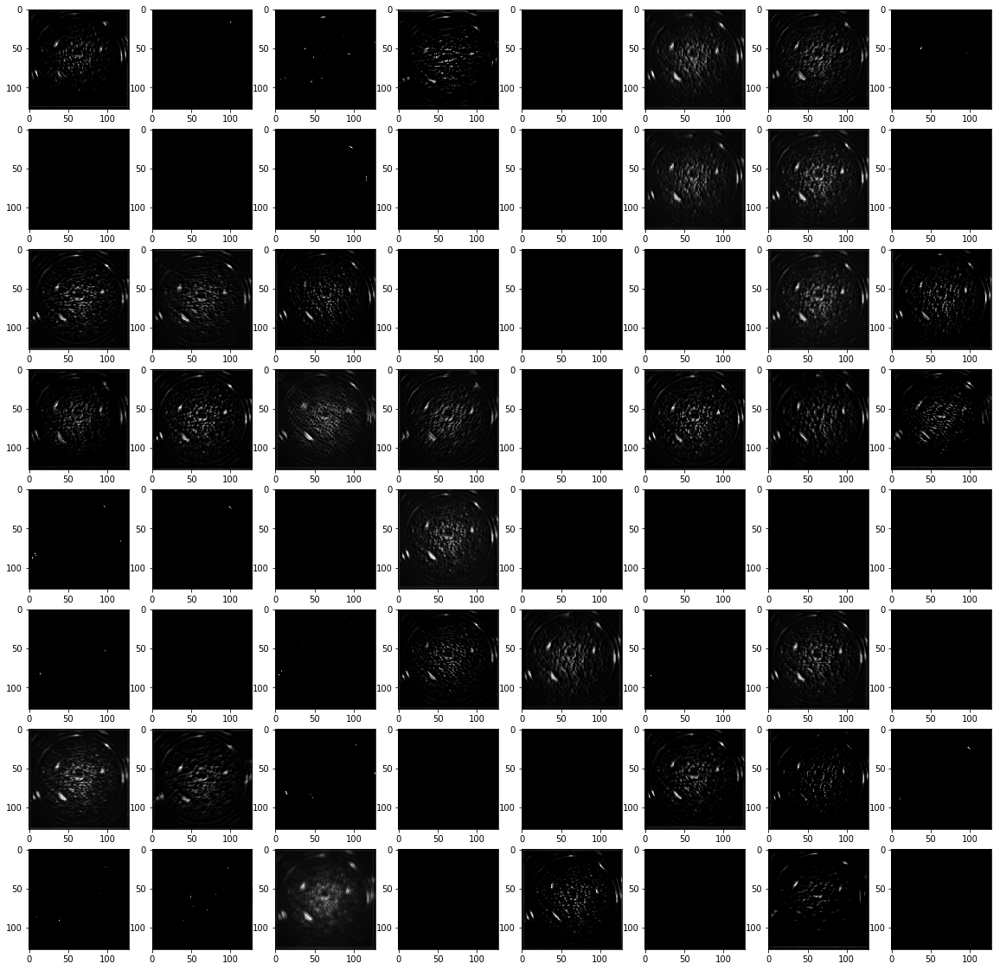

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

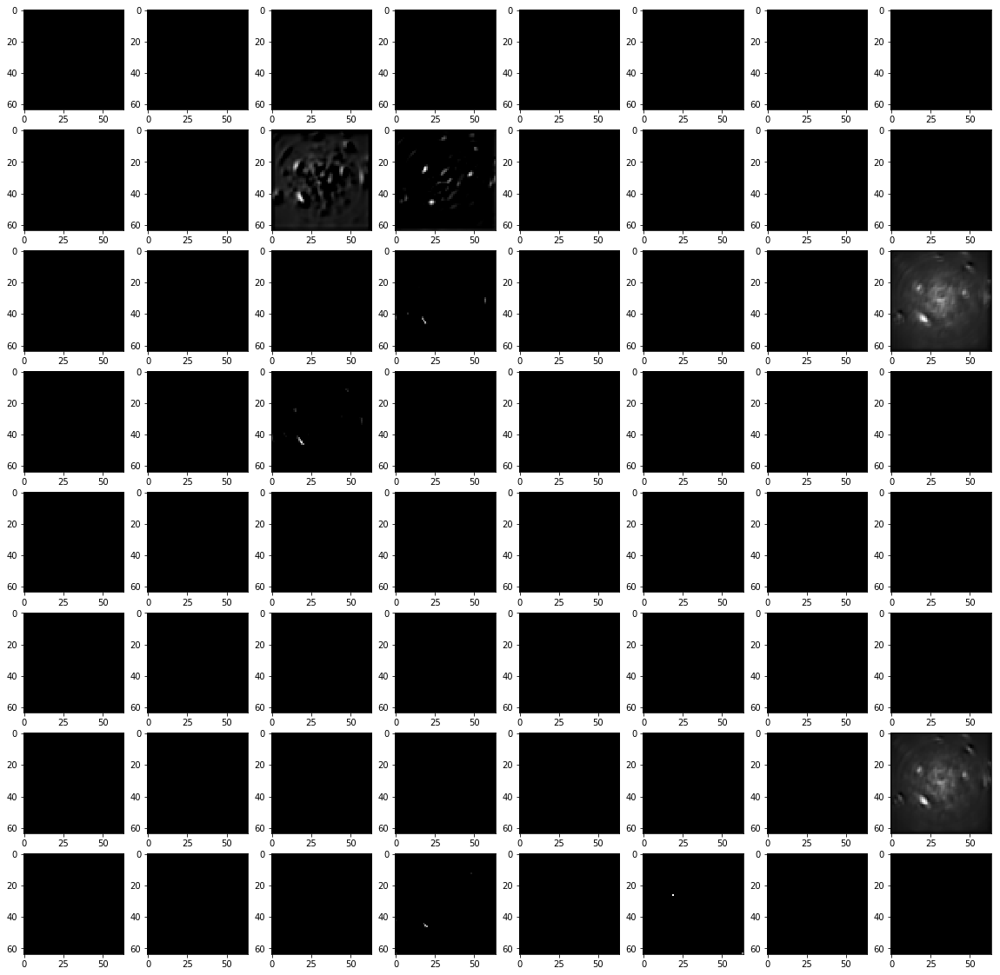

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

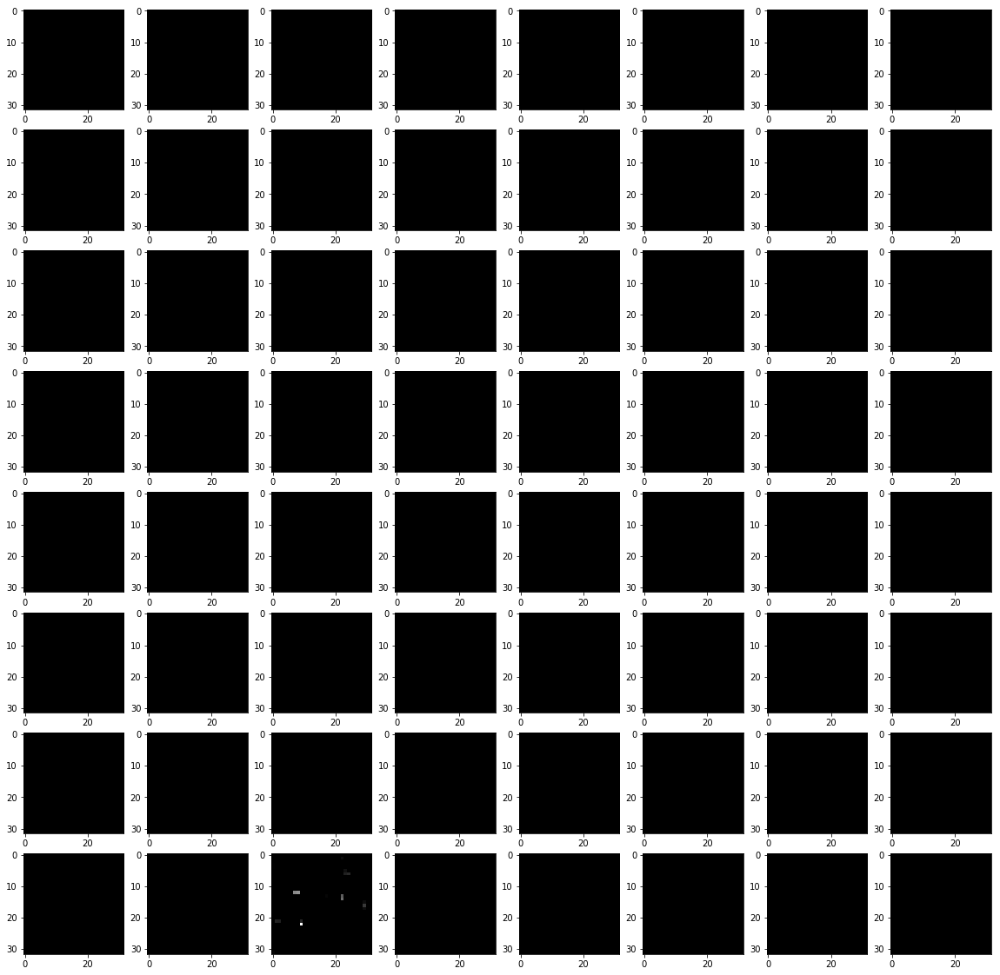

In [12]:
display_mapsPerBlock(model_try2_multitask, img_ice)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


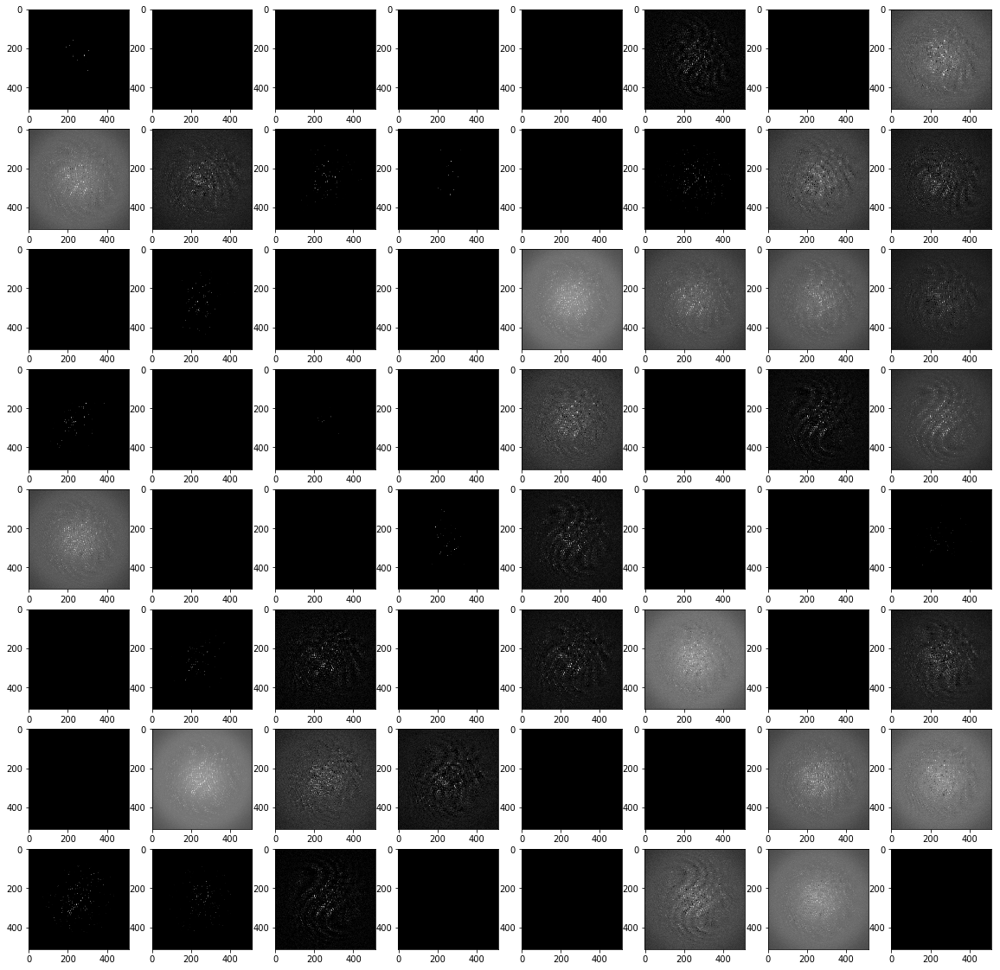

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

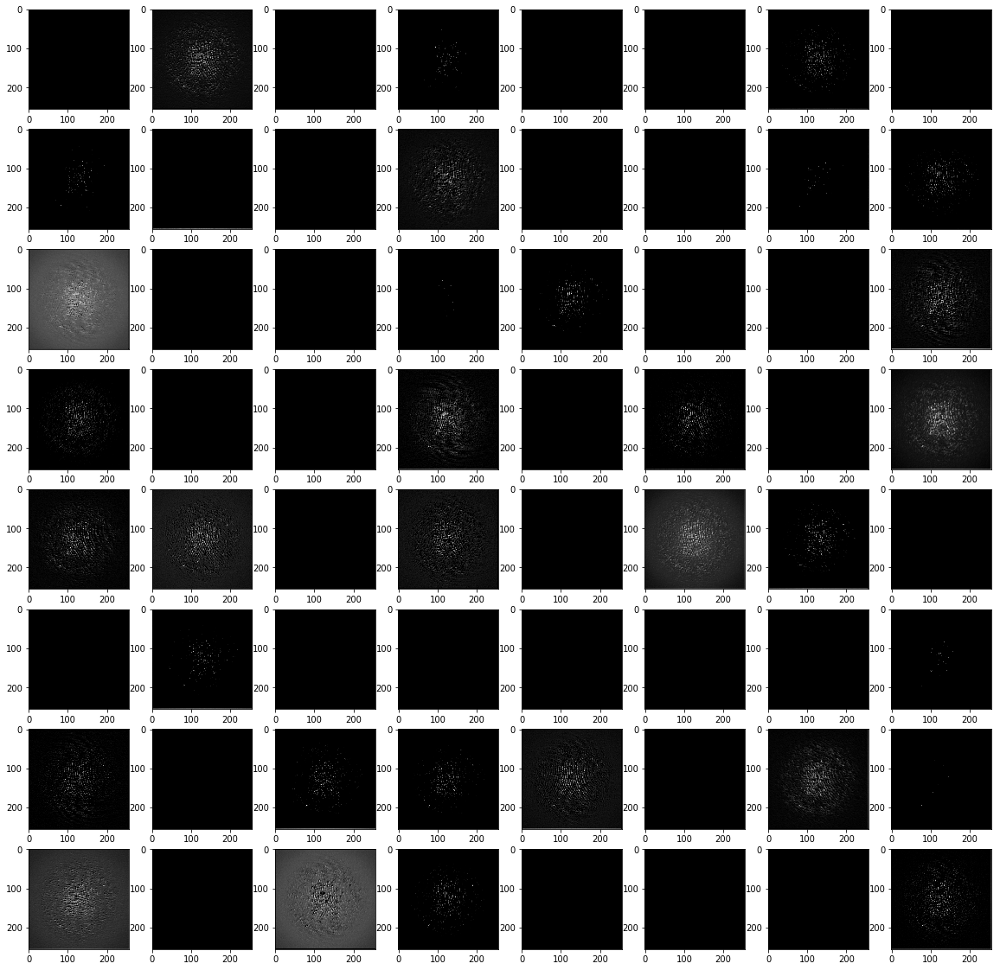

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

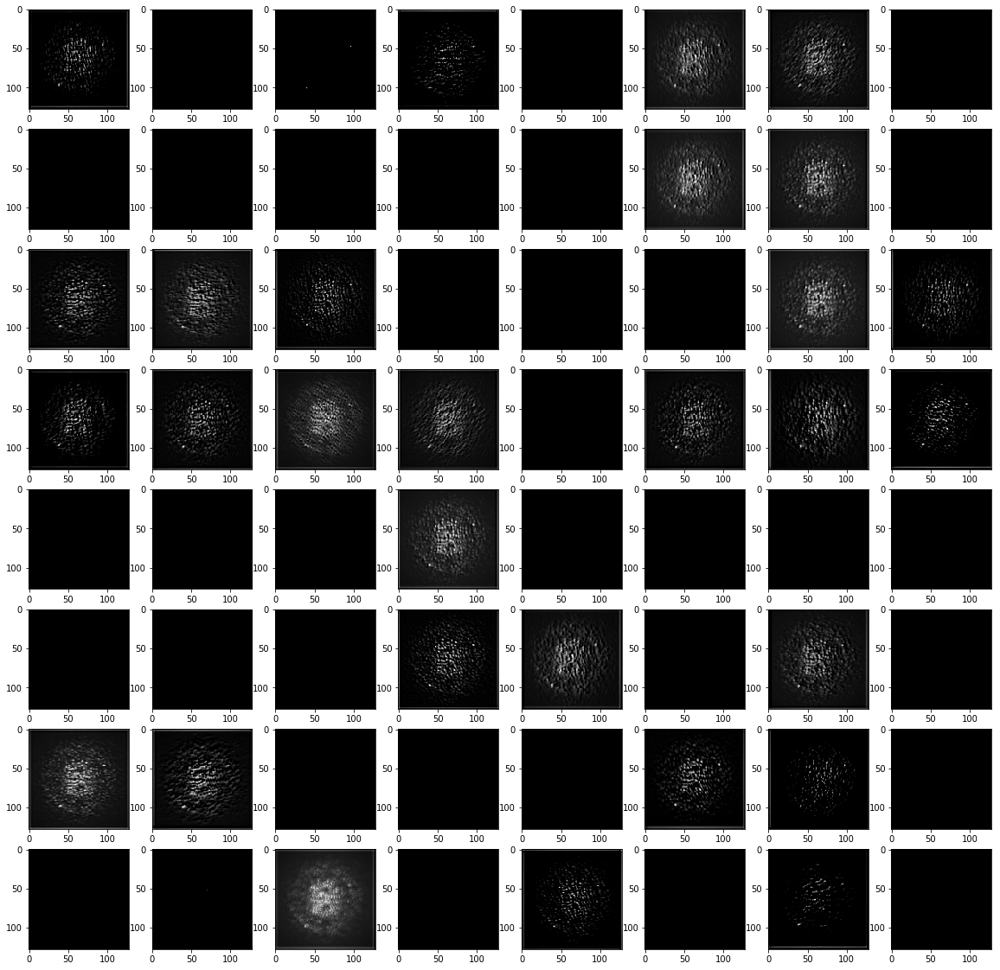

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

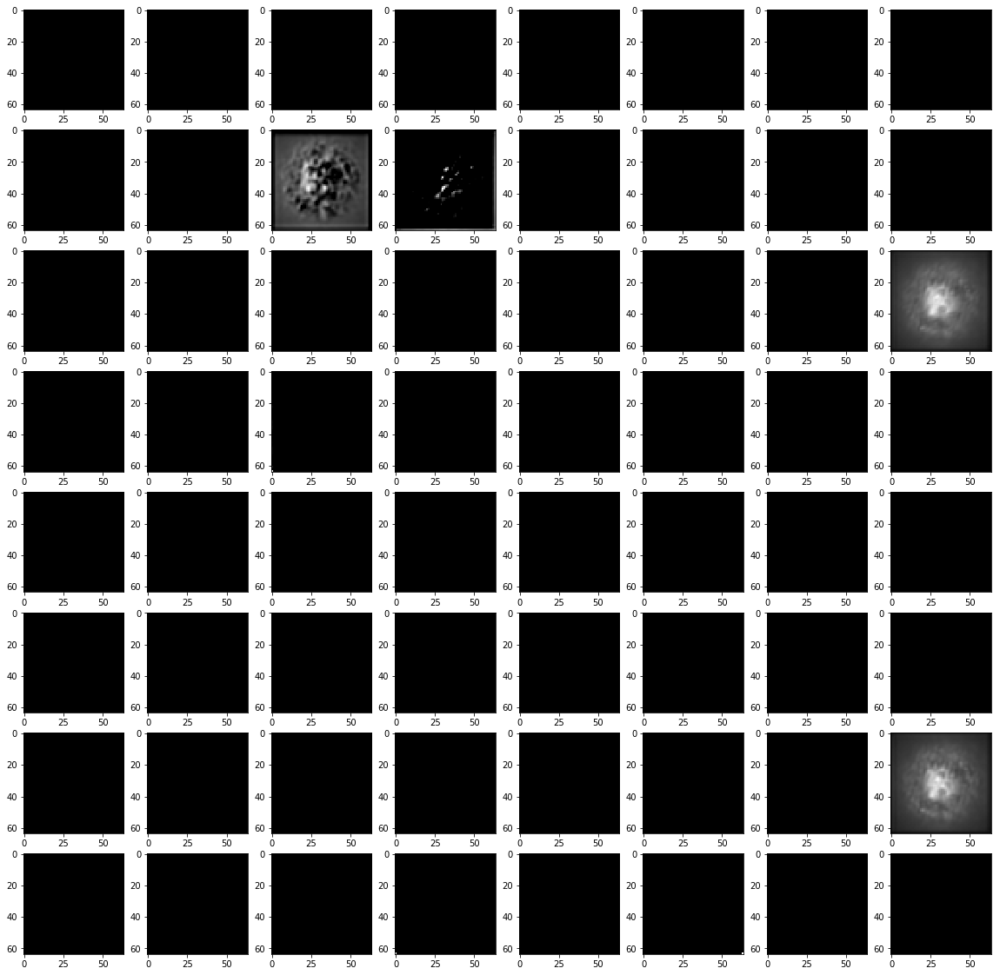

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

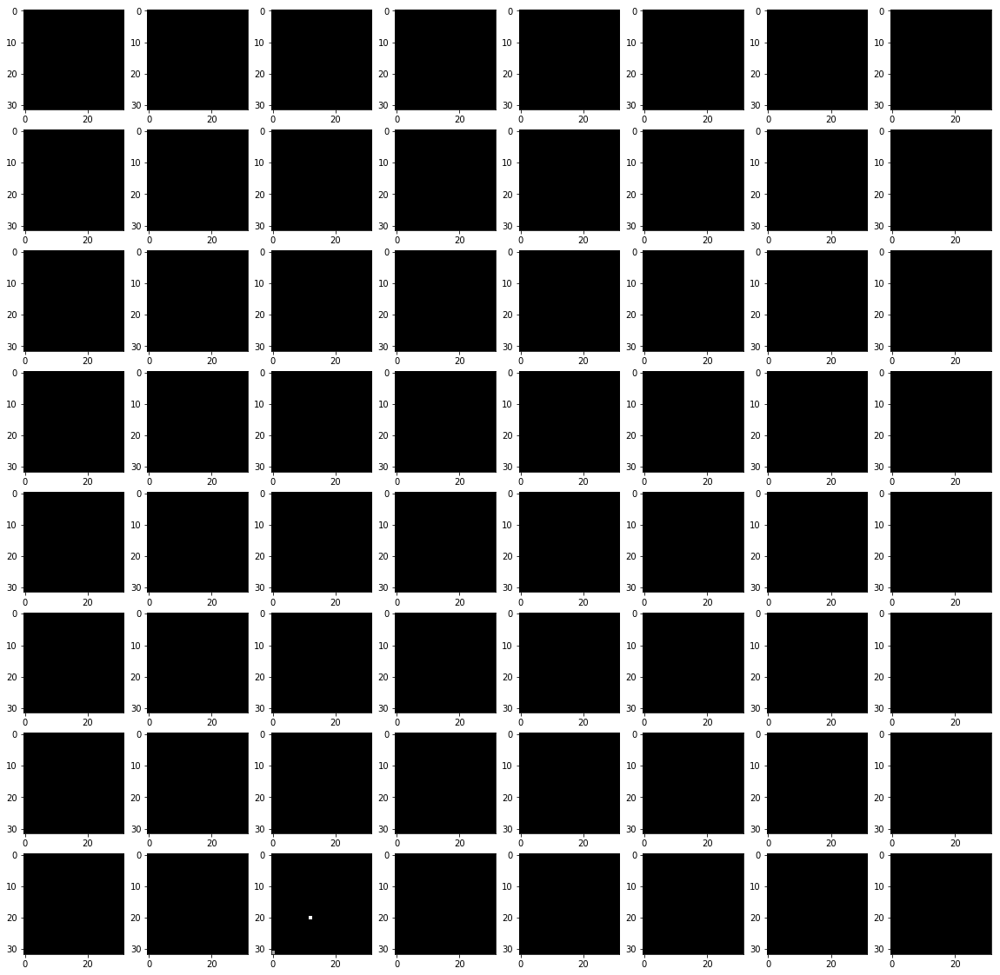

In [13]:
display_mapsPerBlock(model_try2_multitask, img_multi)

These results are very interesting. The weights of this multitask model were initialized with the weights from the previous reference model. Only the final 2 blocks were retrained, the weights of the first 3 blocks were kept the same. Regardless which input image was used to get the feature maps, the final block seems to have lost all weights instead of relearning them based on the new dataset. 

#### 2. Binary Classifier to Predict Ice

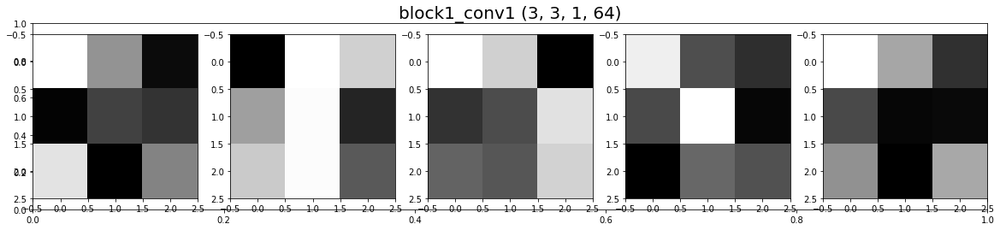

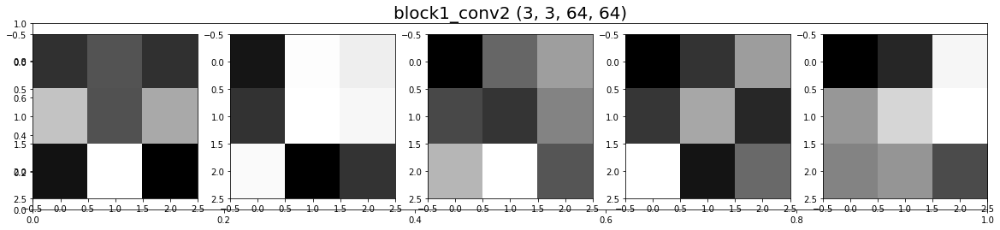

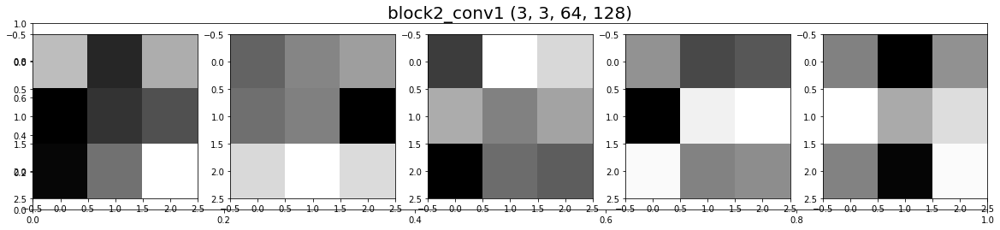

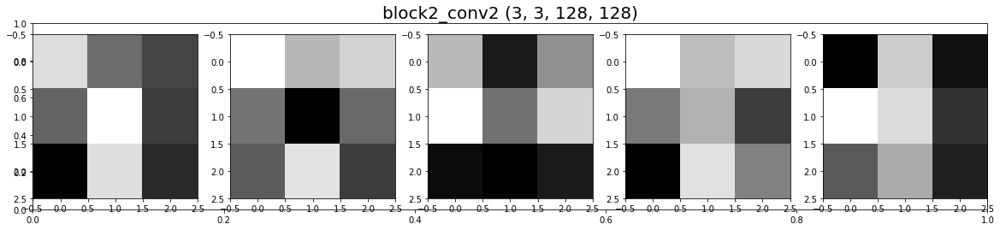

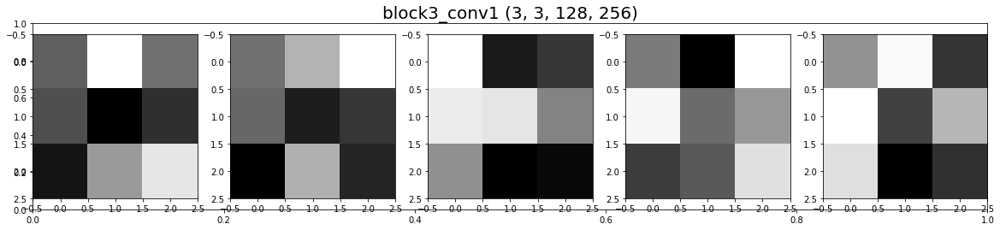

...

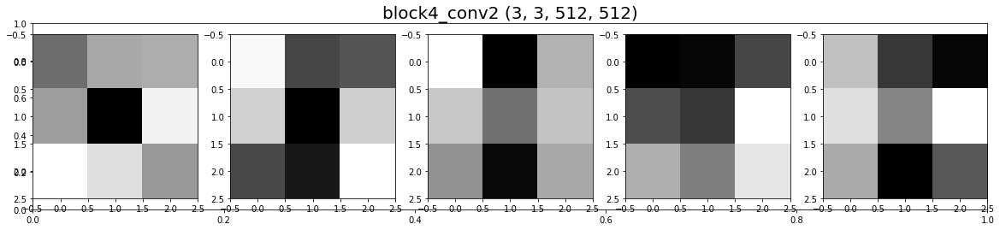

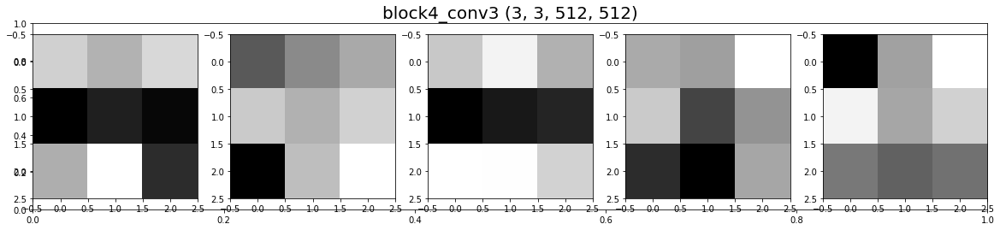

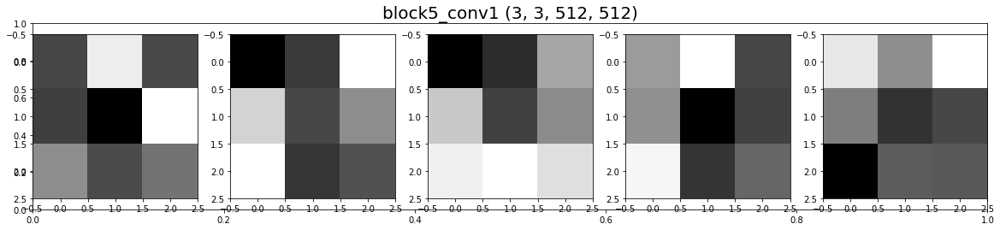

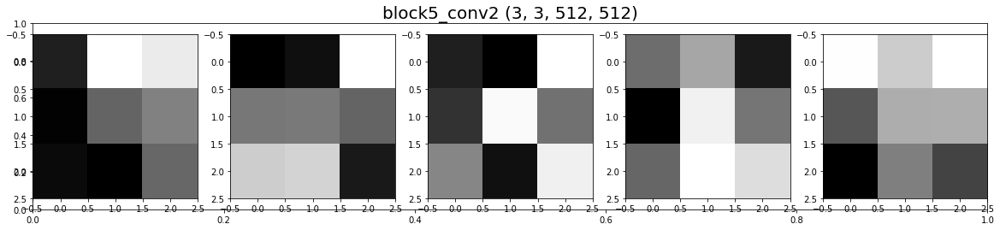

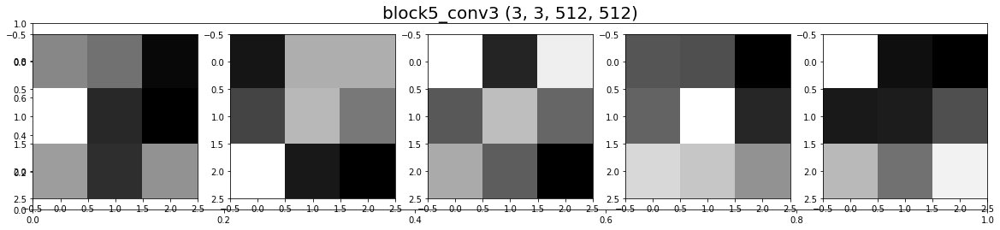

In [8]:
display_filter(model_binary_ice)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


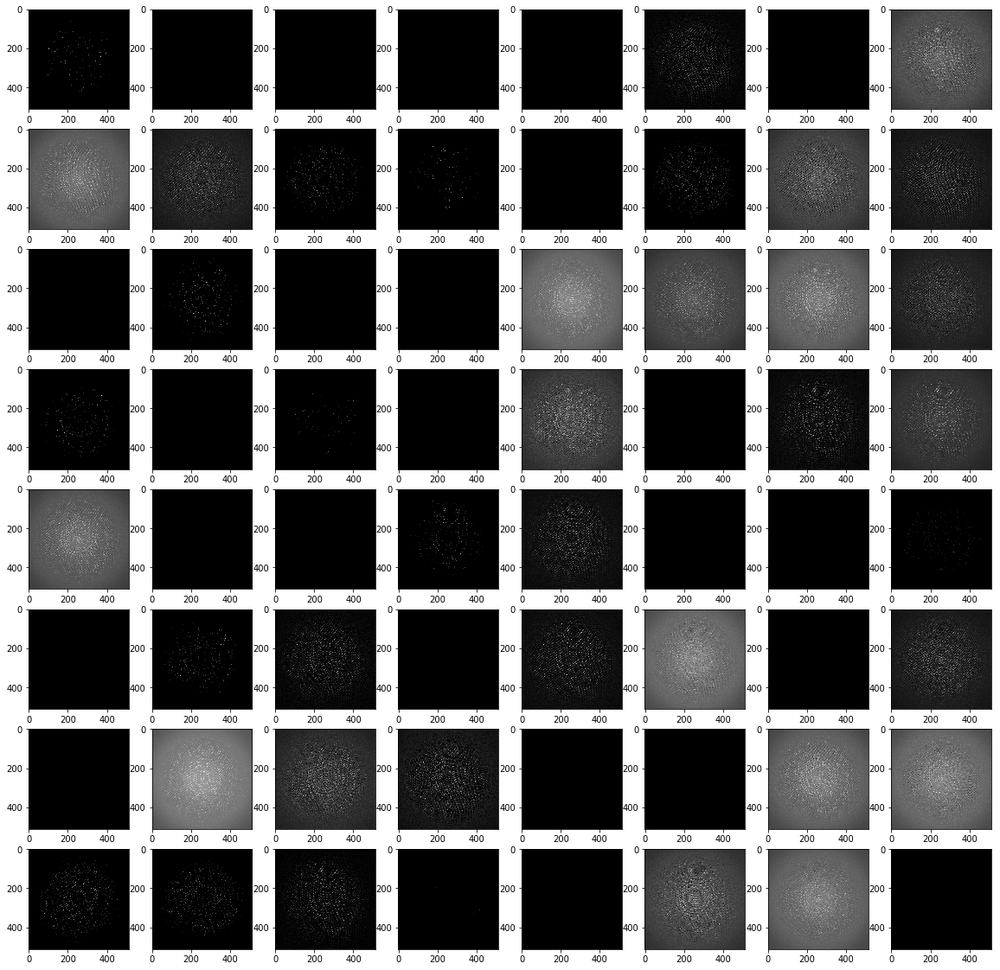

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

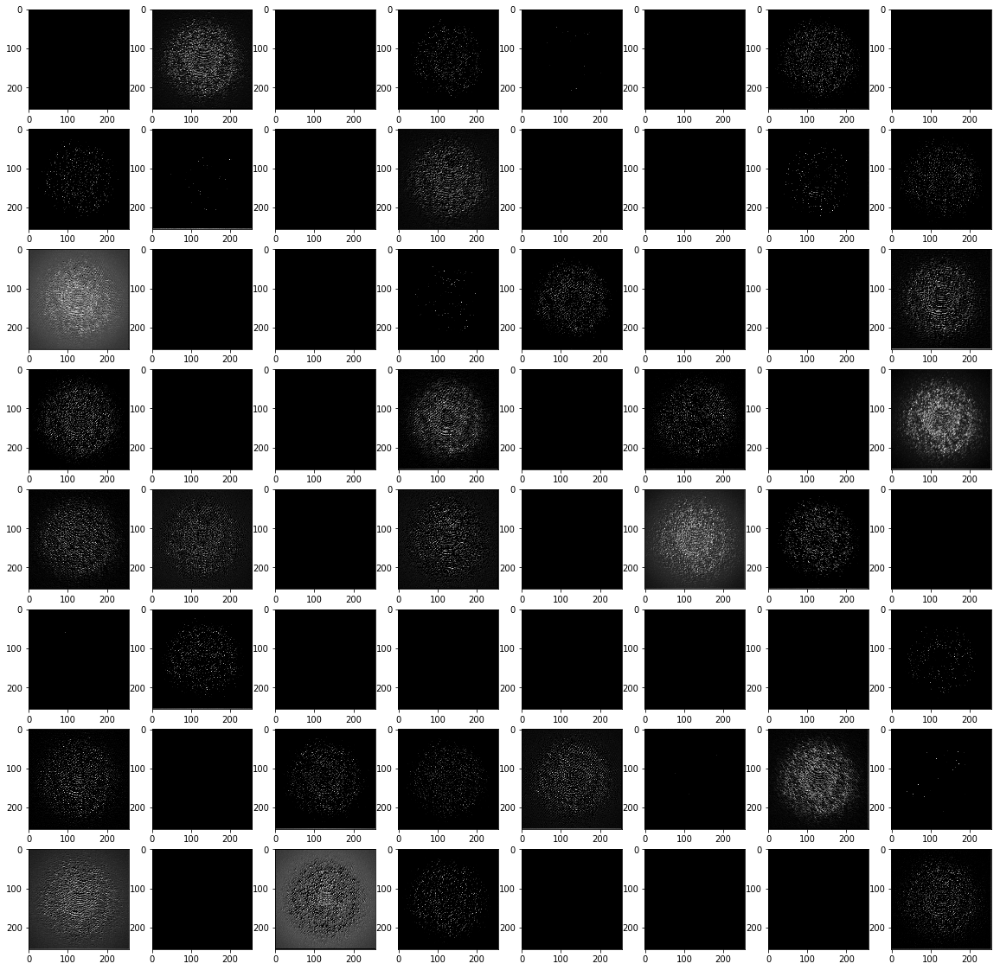

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

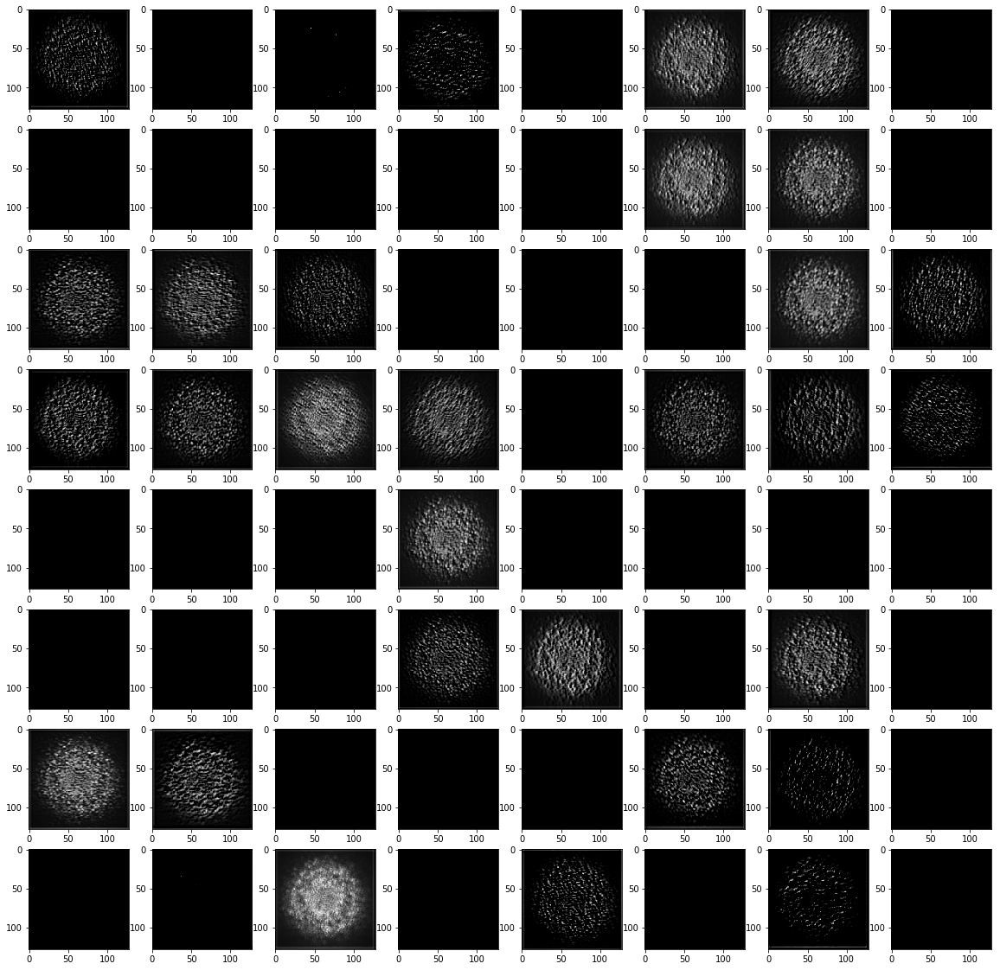

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

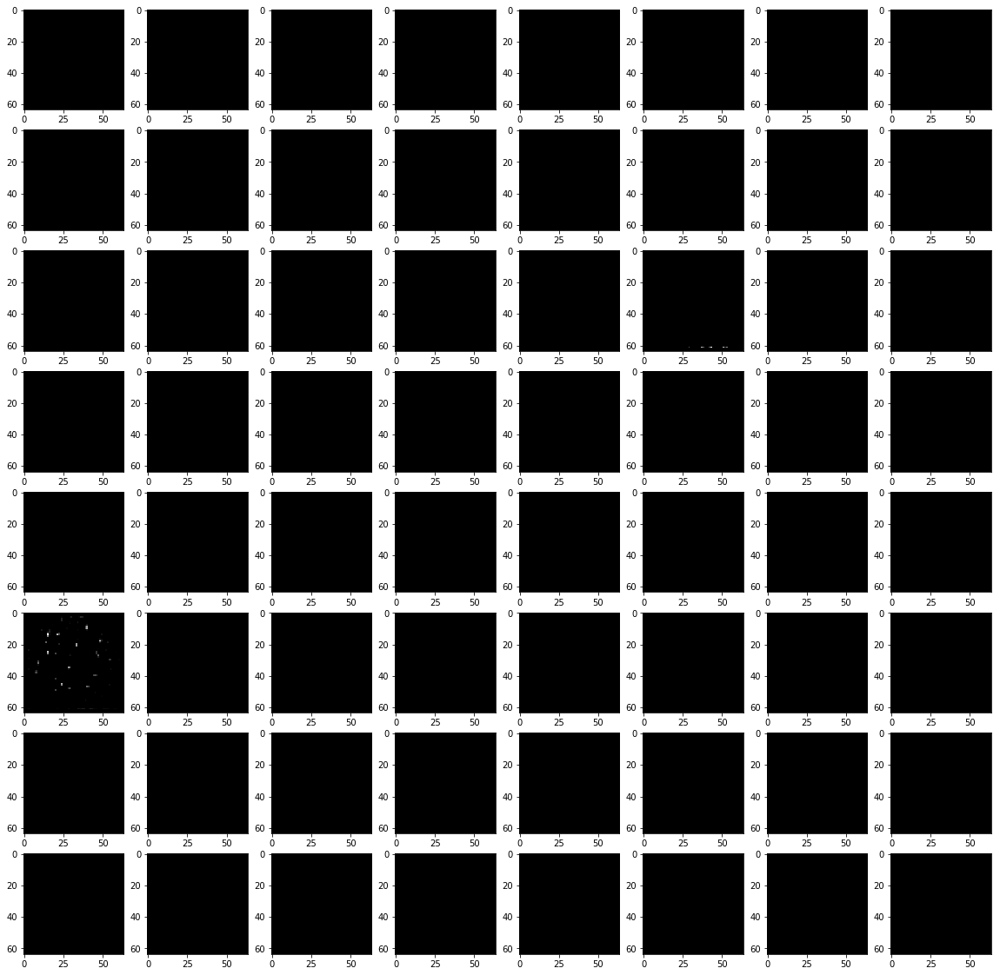

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

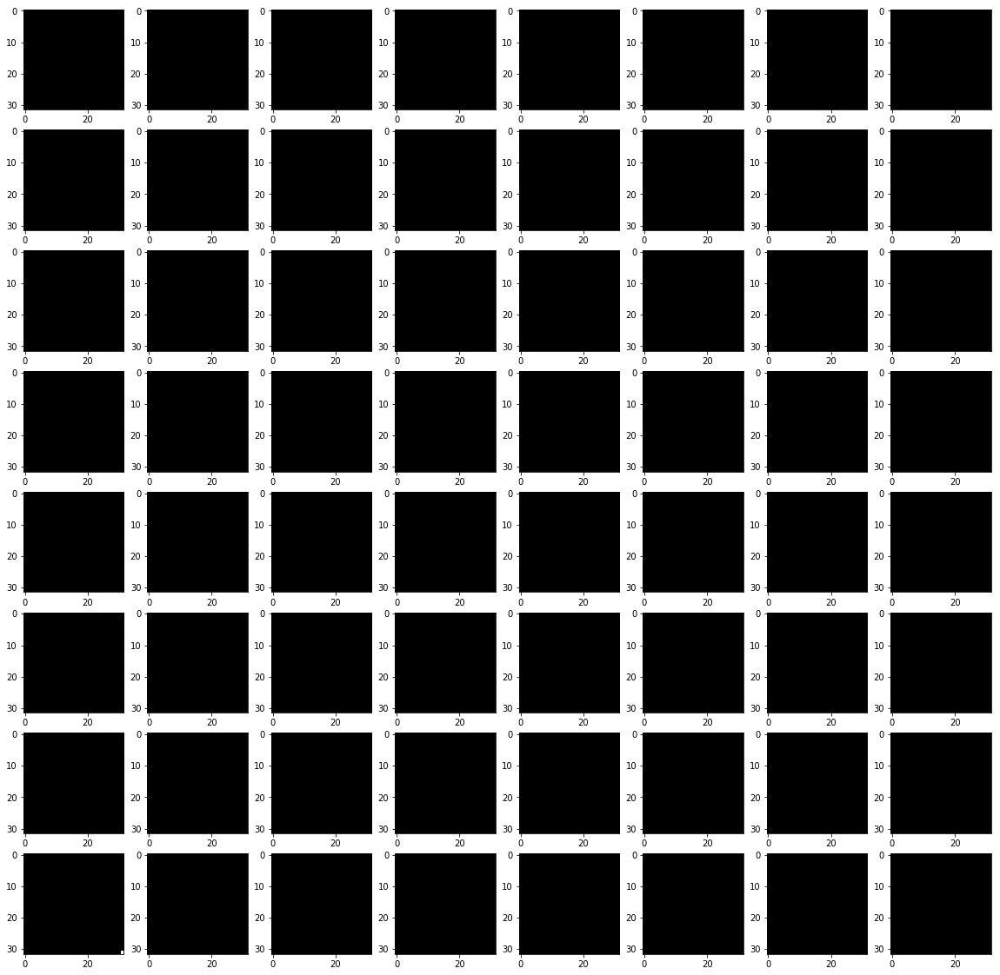

In [114]:
display_mapsPerBlock(model_binary_ice, img_strong)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


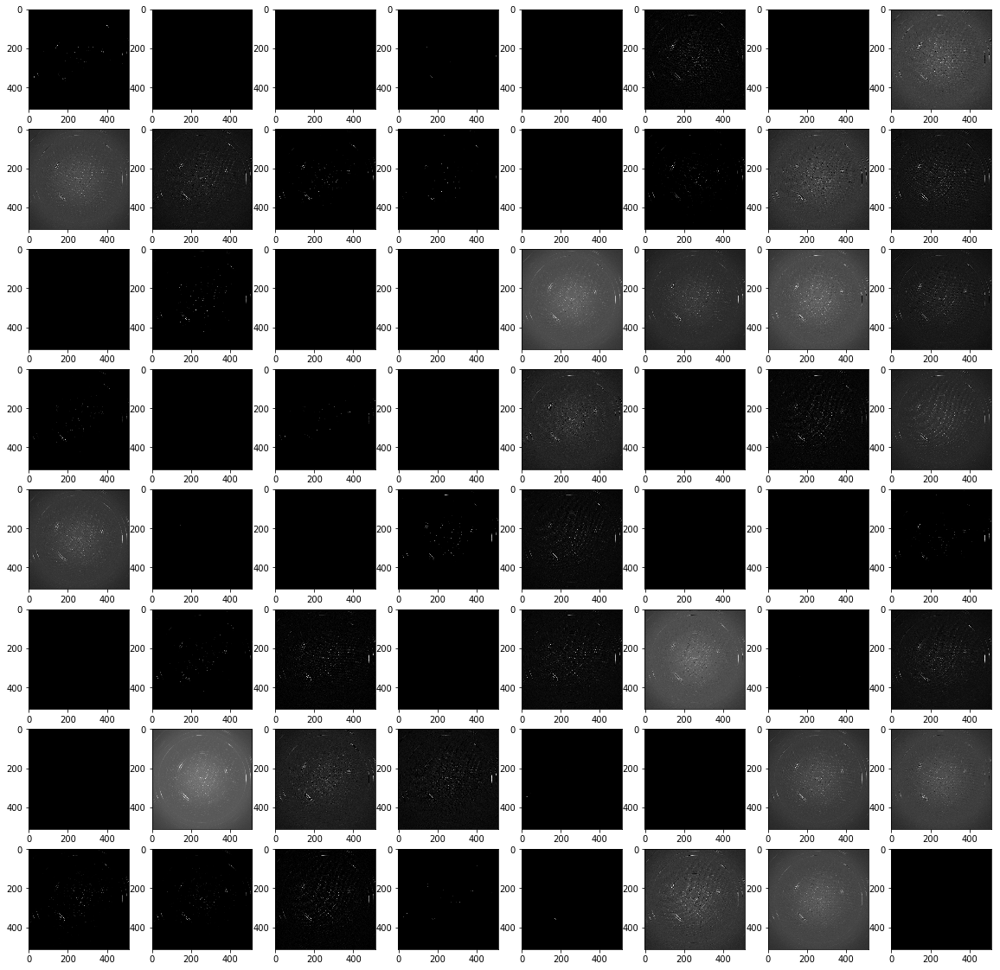

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

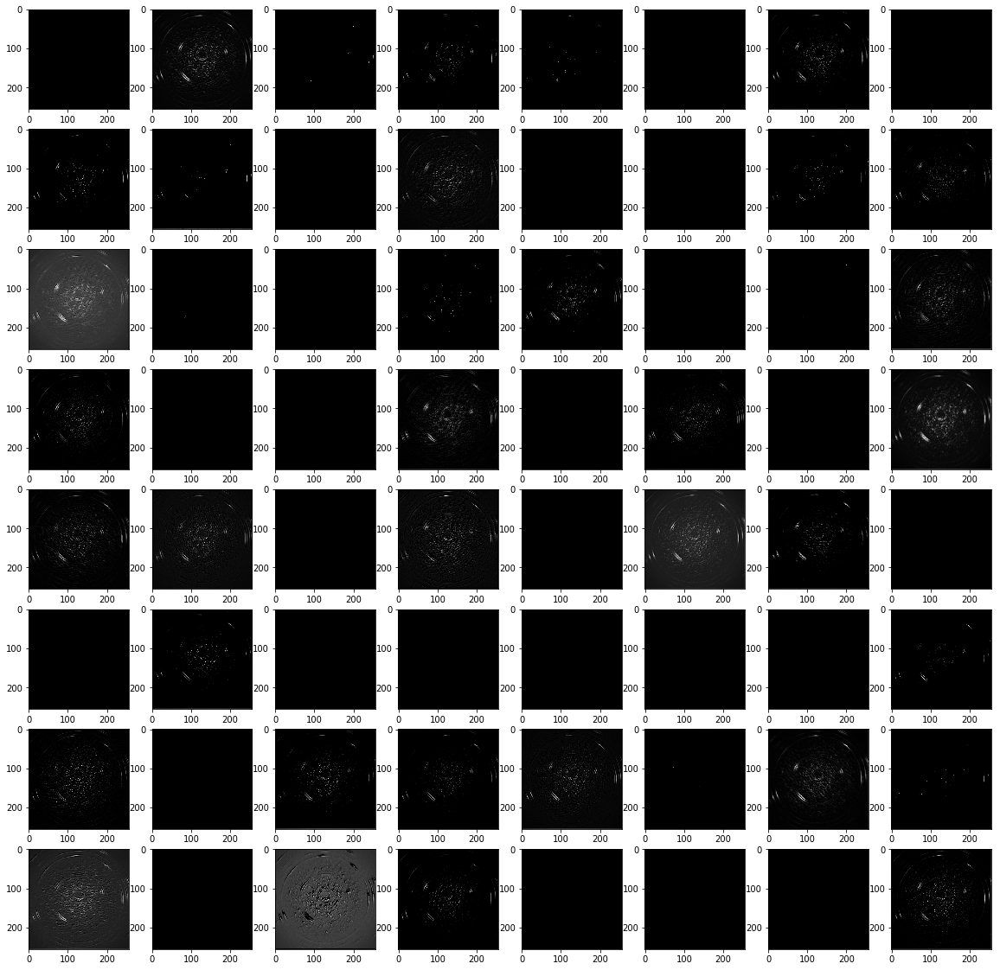

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

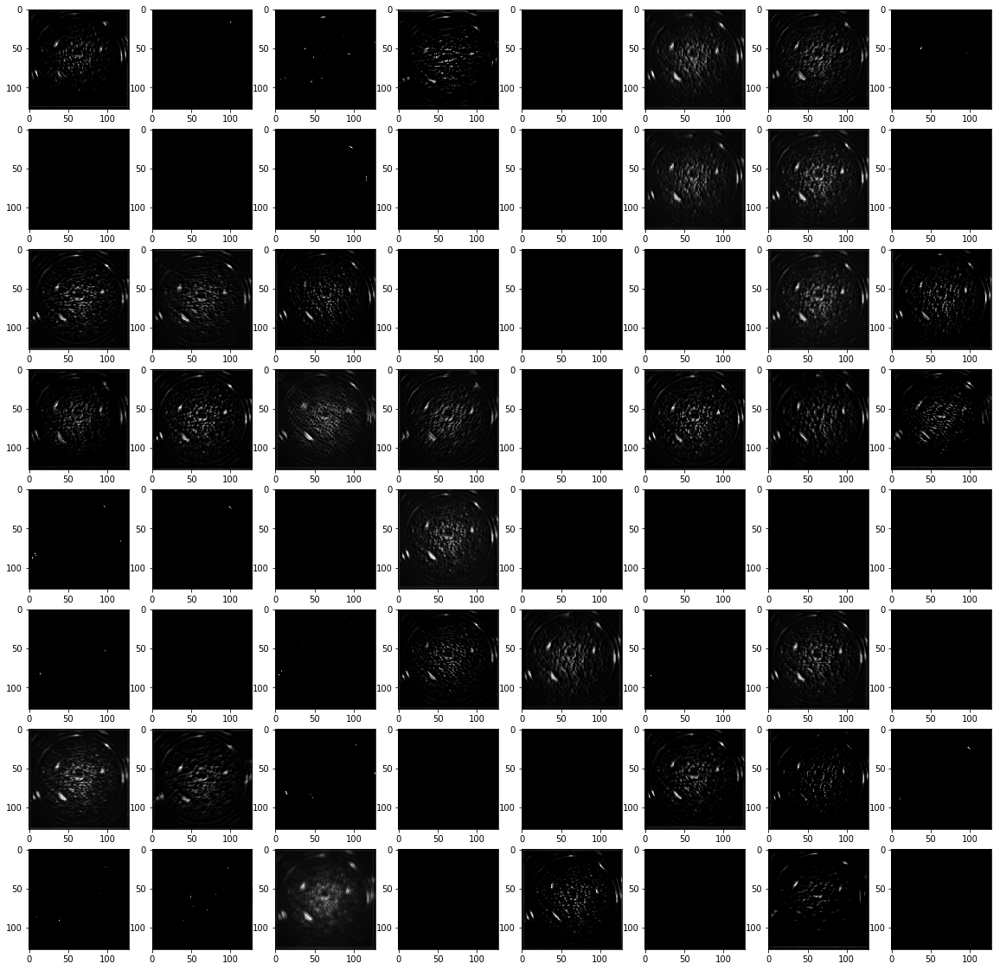

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

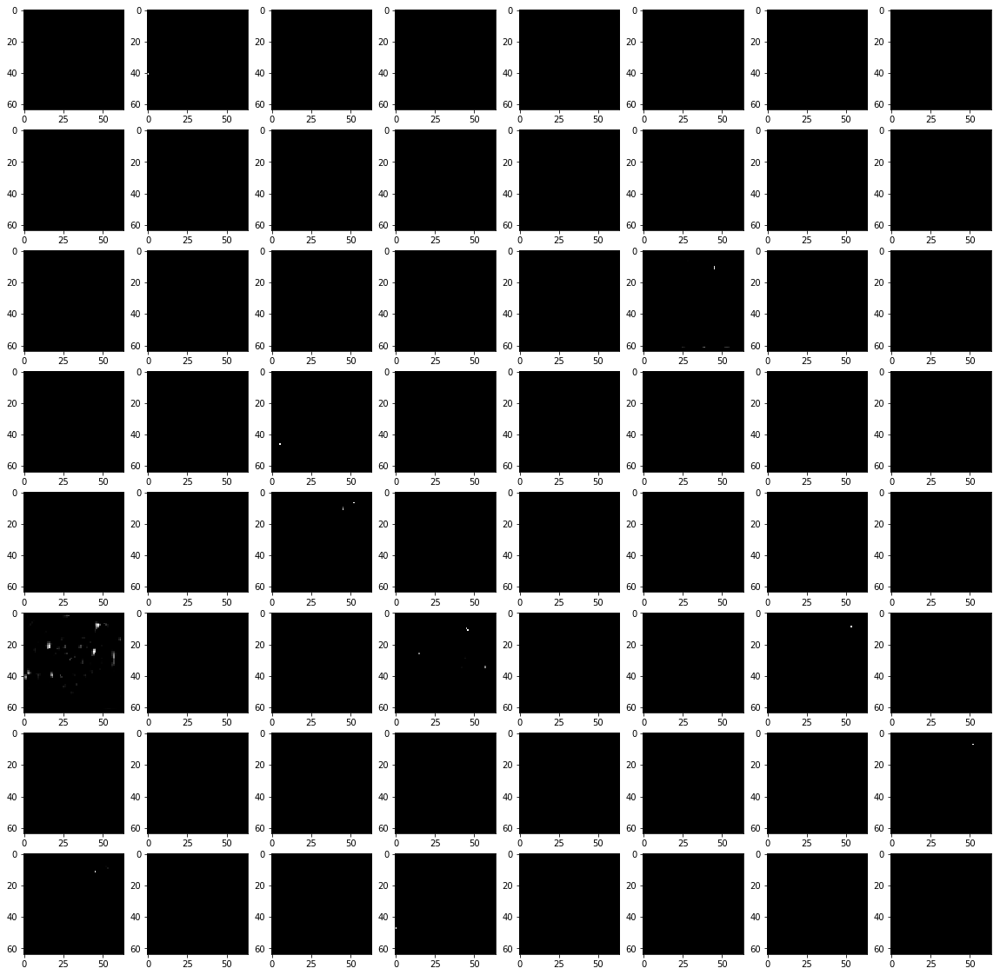

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

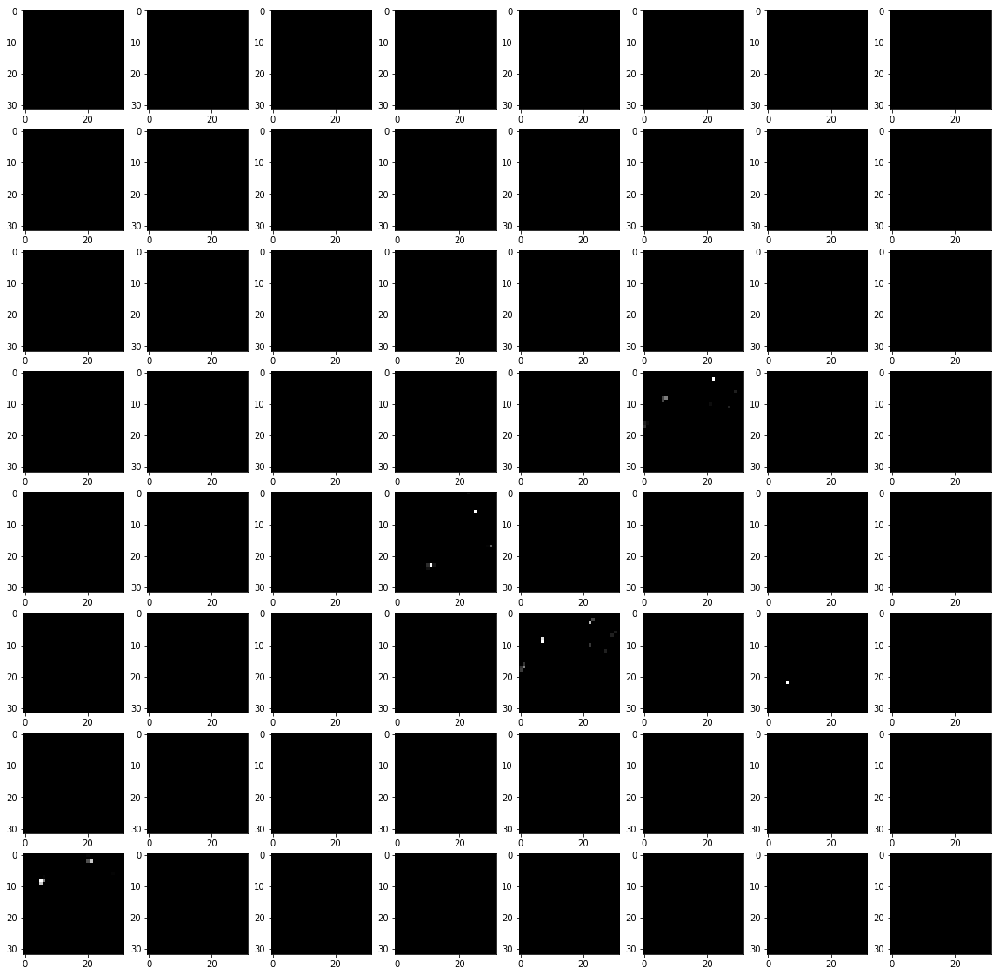

In [115]:
display_mapsPerBlock(model_binary_ice, img_ice)

The binary ice classifier seems to have lost most image information in the final block as well.

#### 3. Binary Classifier to Predict Smeared Spots (multilattice)

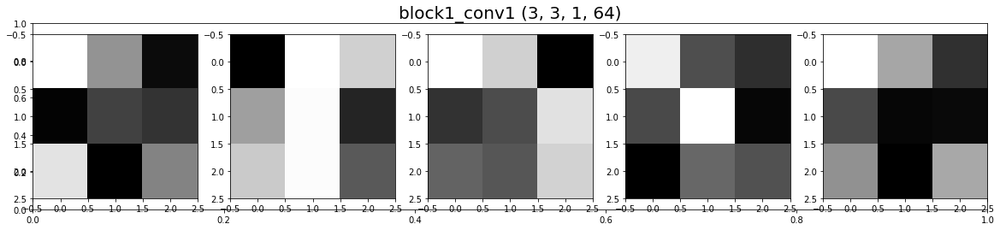

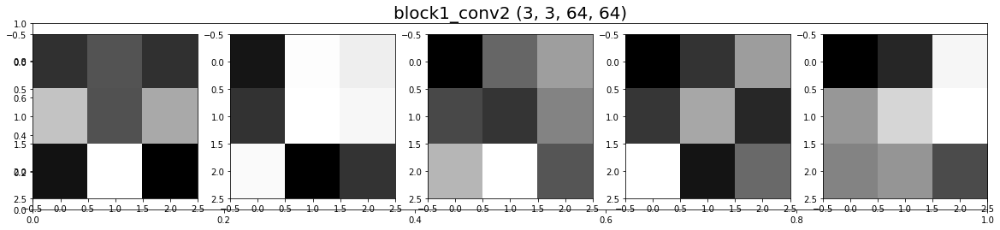

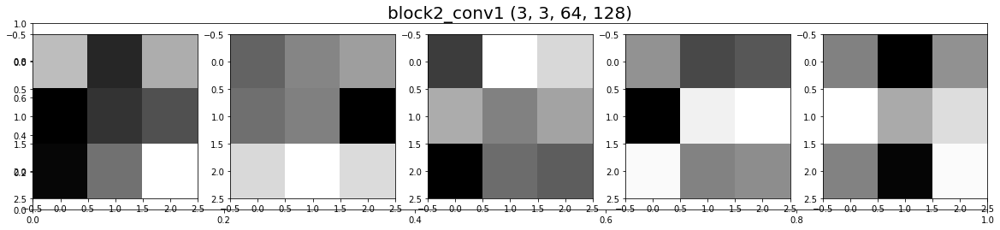

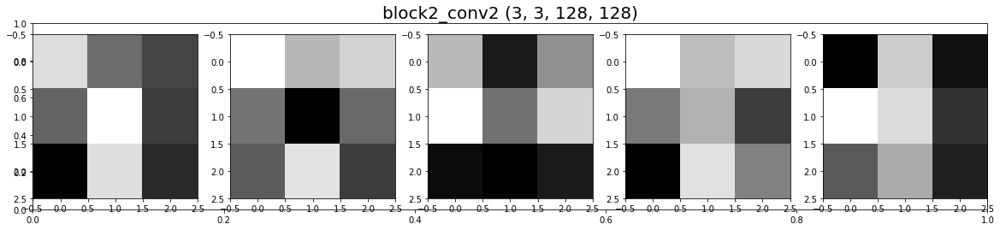

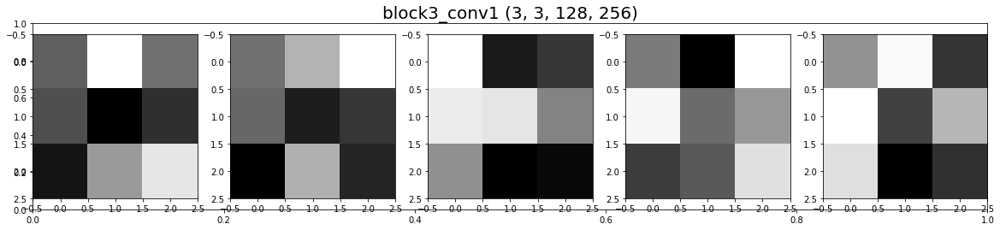

...

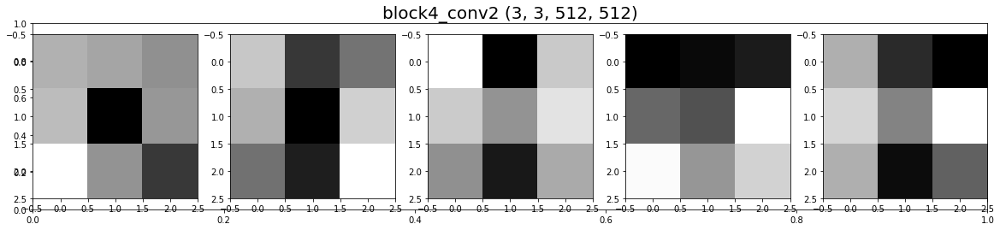

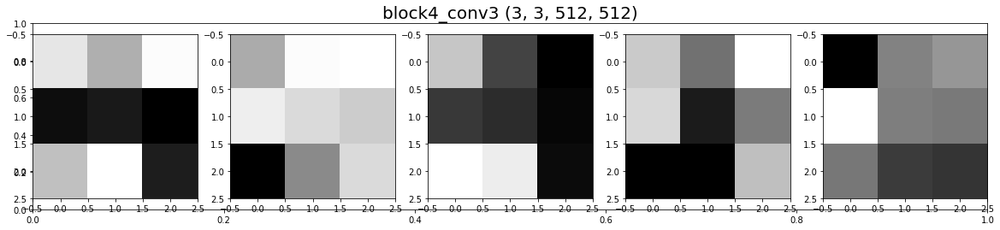

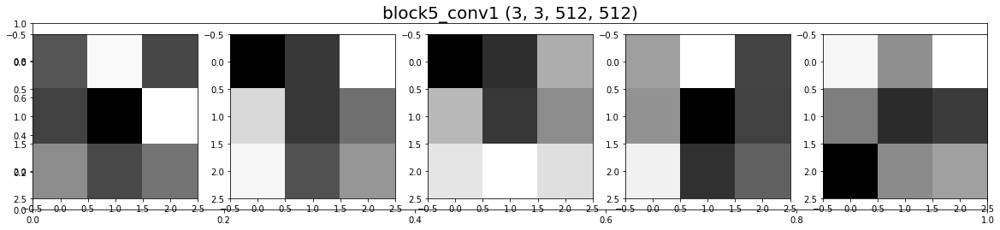

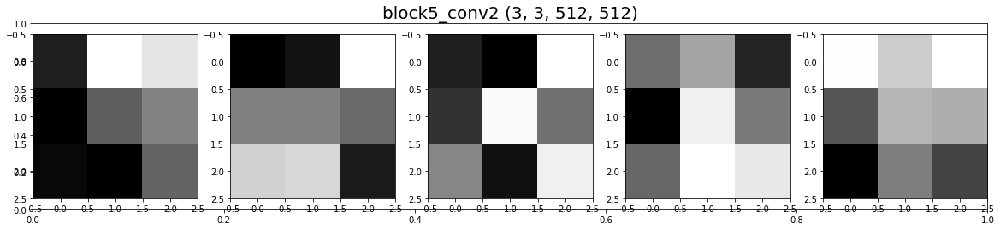

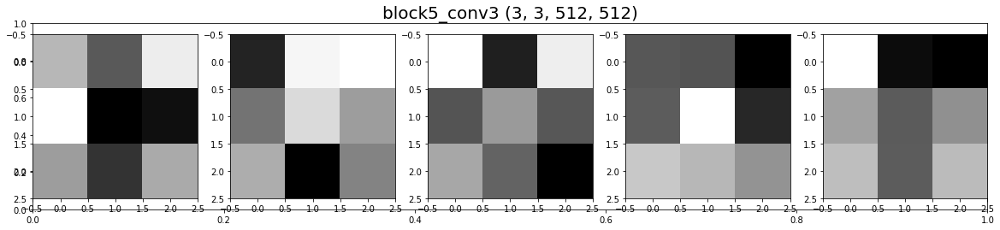

In [39]:
display_filter(model_binary_multi)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


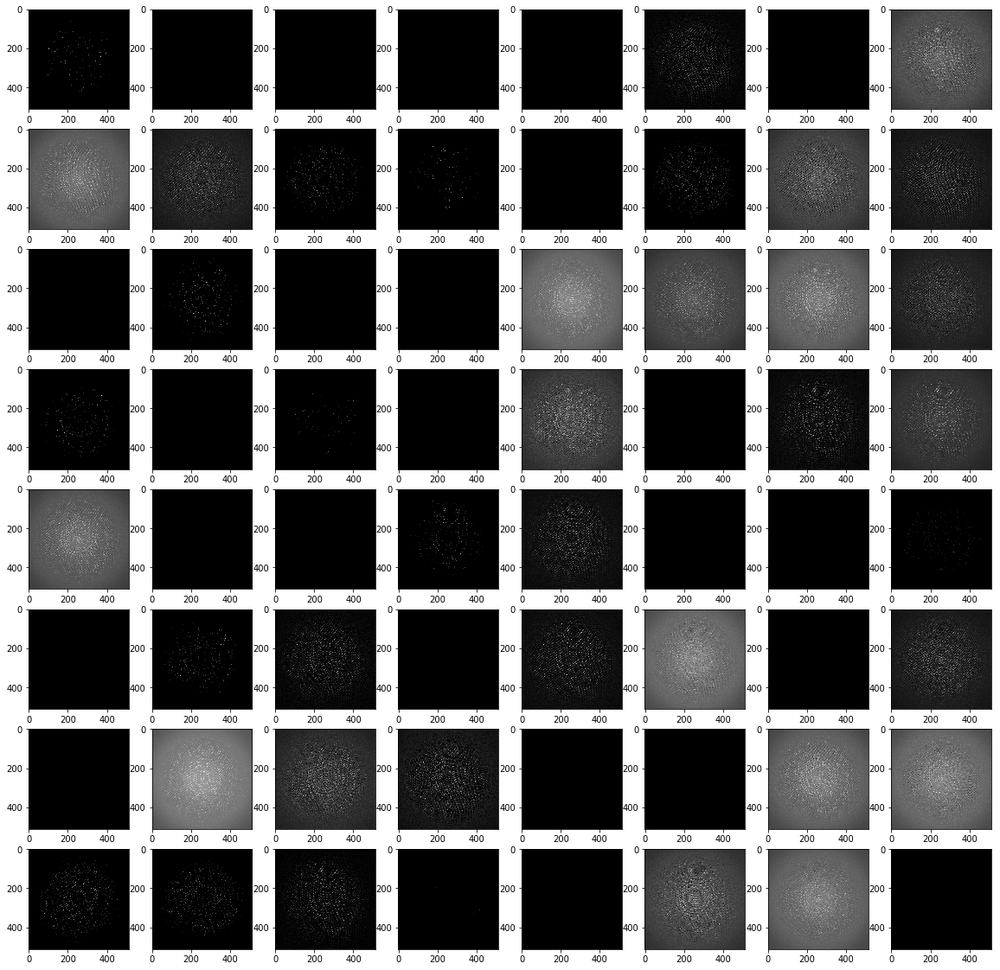

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

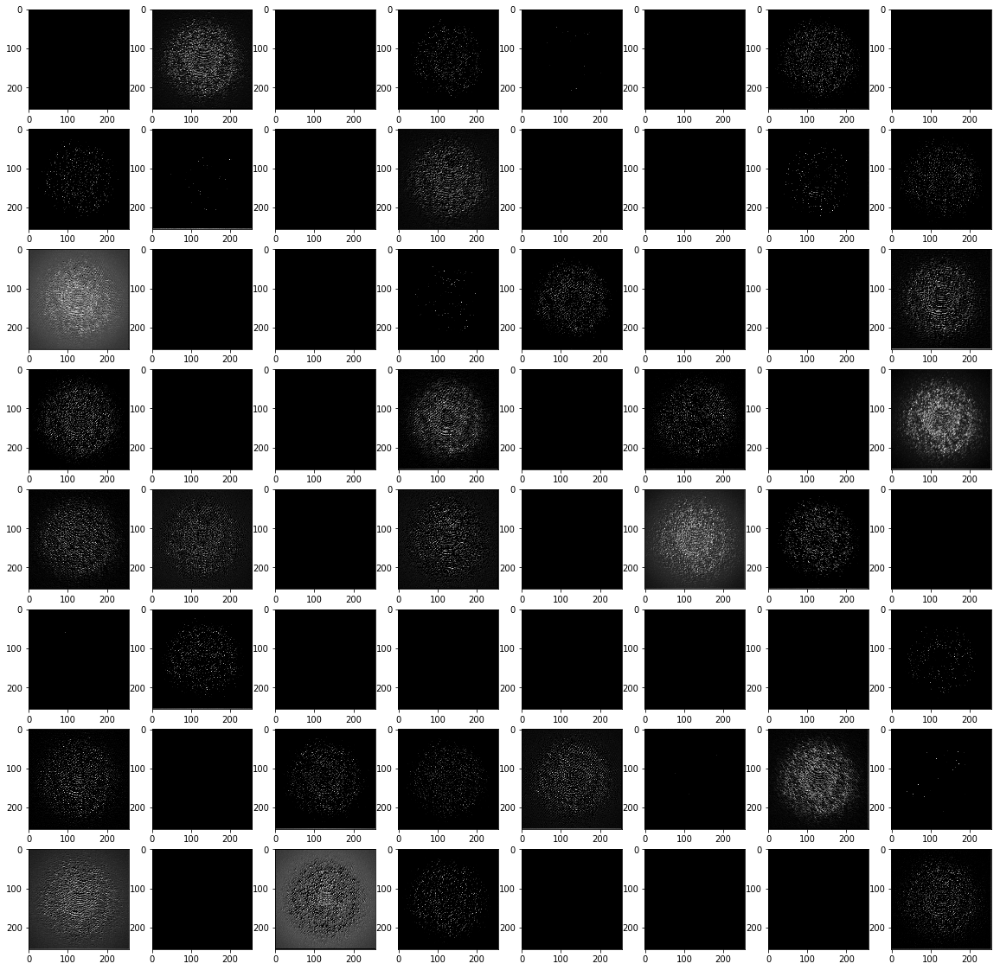

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

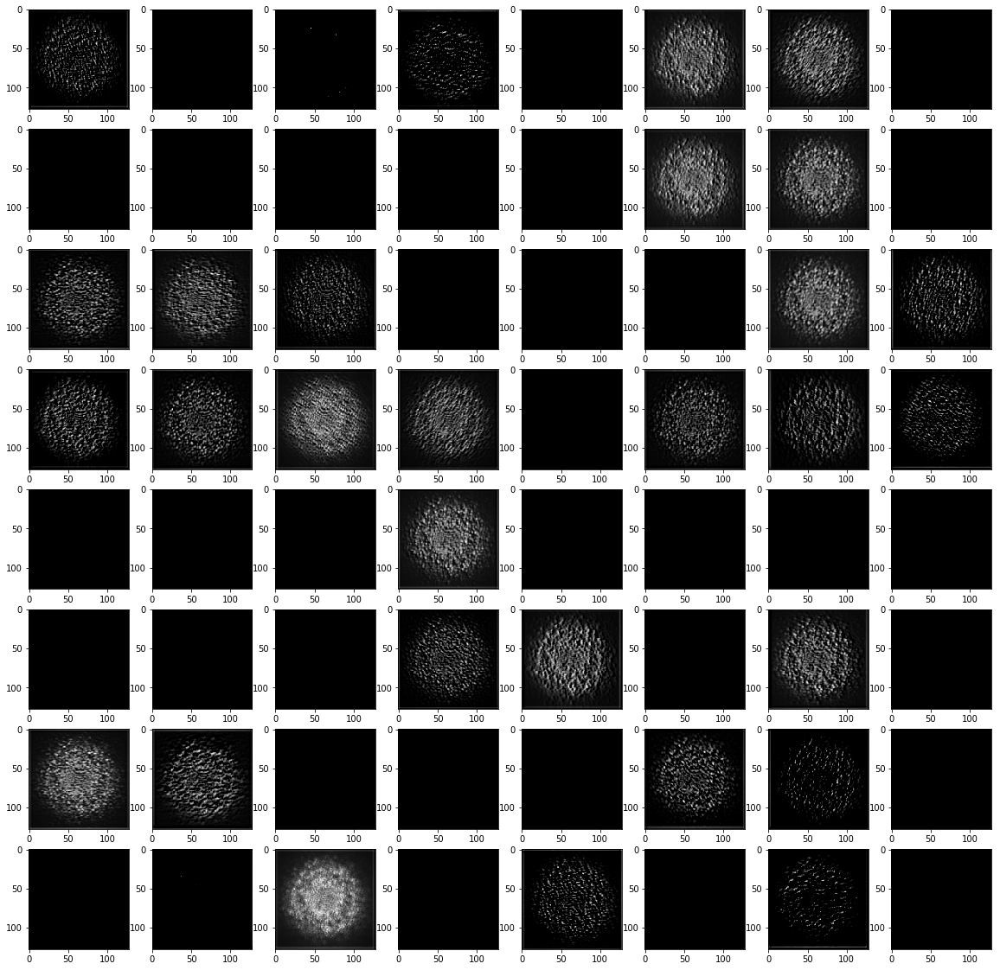

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

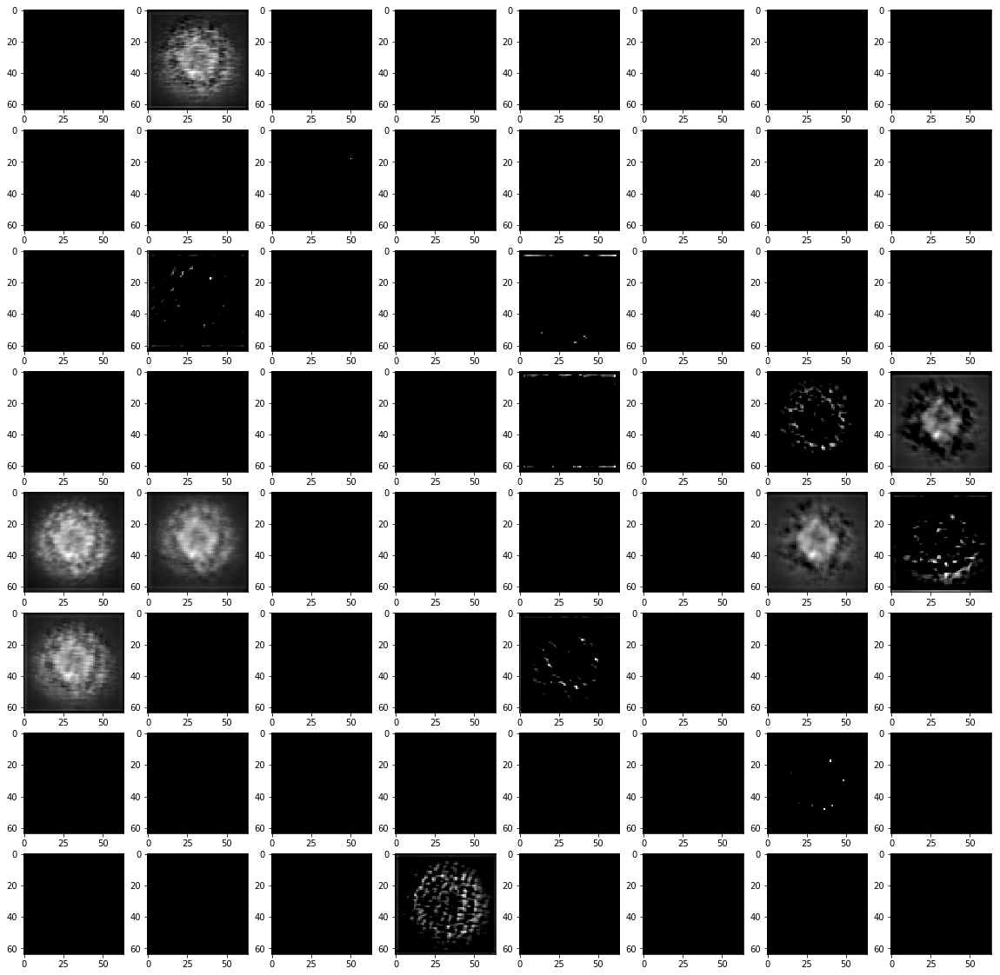

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

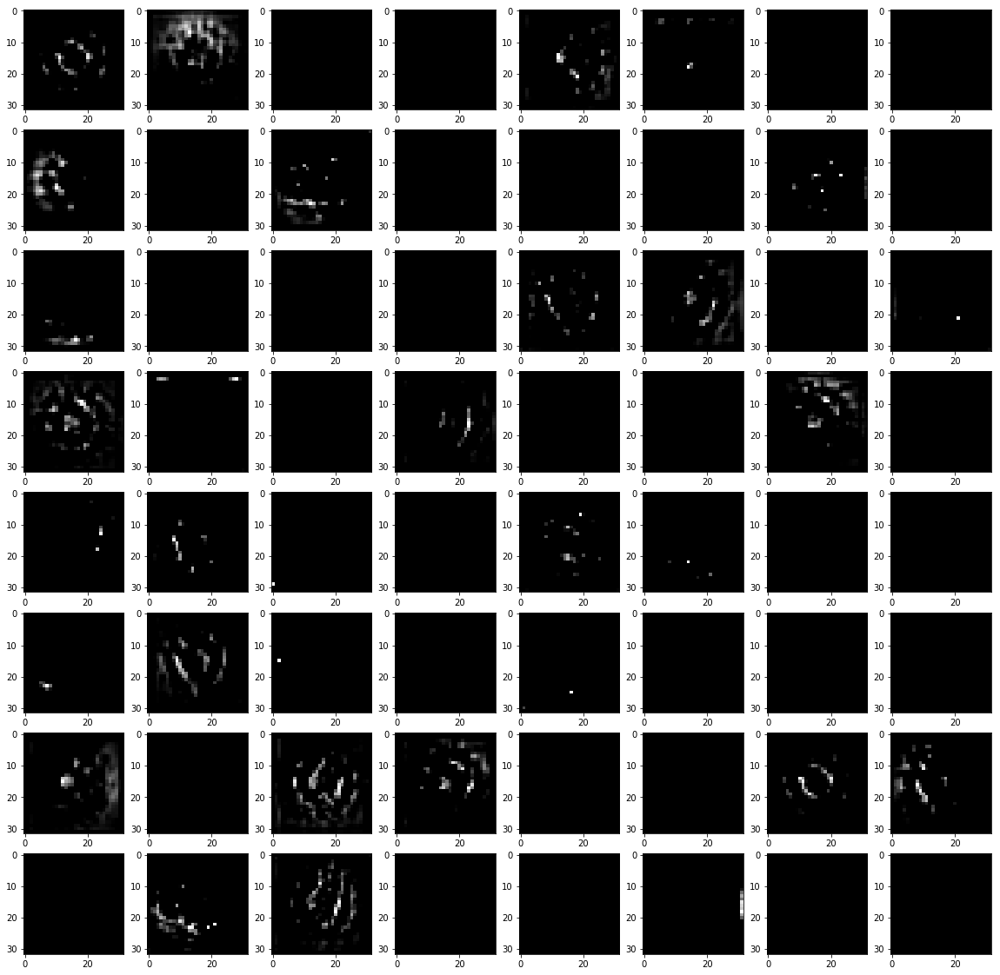

In [117]:
display_mapsPerBlock(model_binary_multi, img_strong)

('block: ', 1)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
Total params: 37,568
Trainable params: 0
Non-trainable params: 37,568
_________________________________________________________________
None


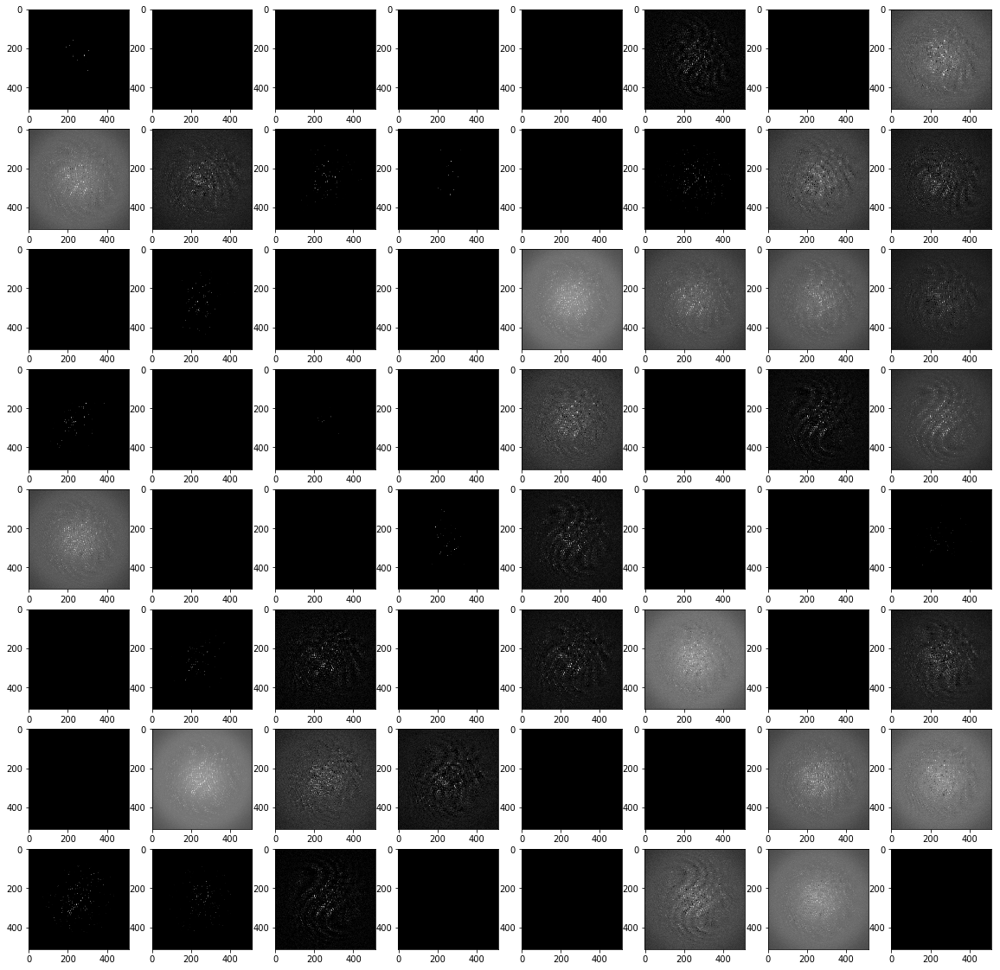

('block: ', 2)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
Total params: 259,008
Trainable params: 0
Non-trainable params: 259,008
_______________________________________________________

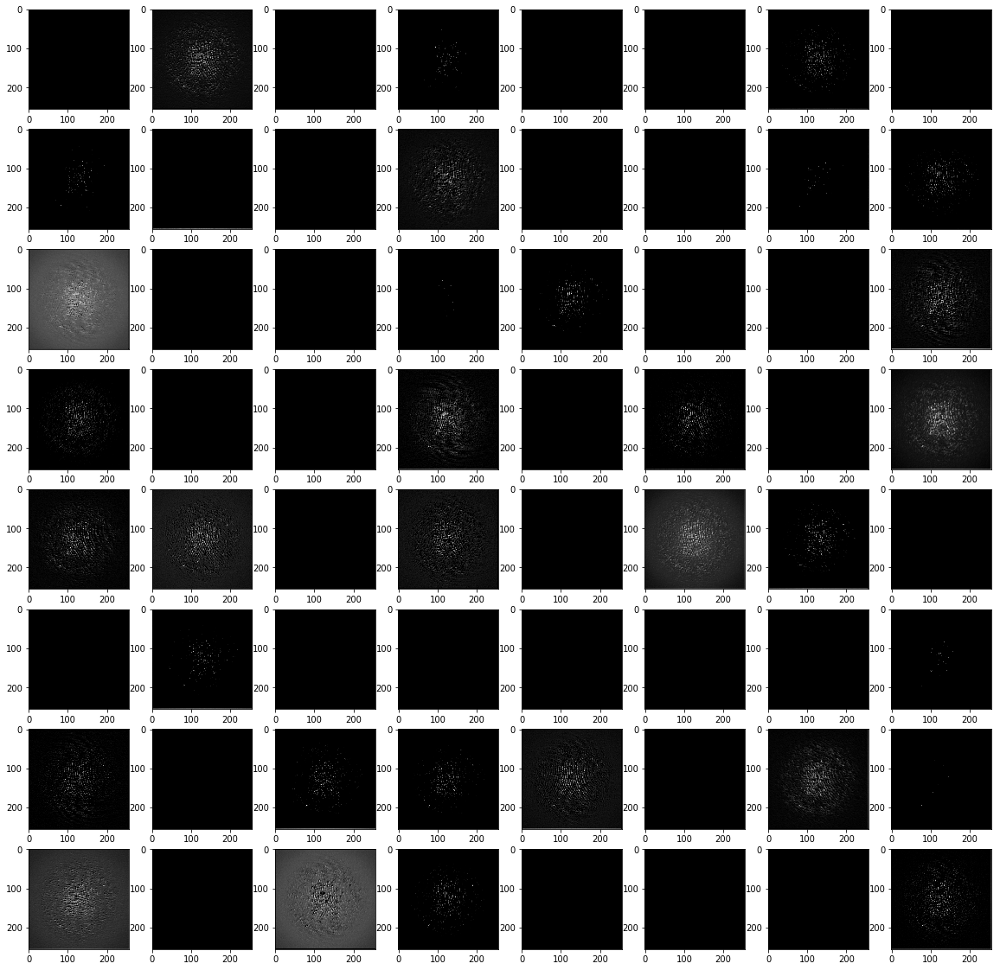

('block: ', 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

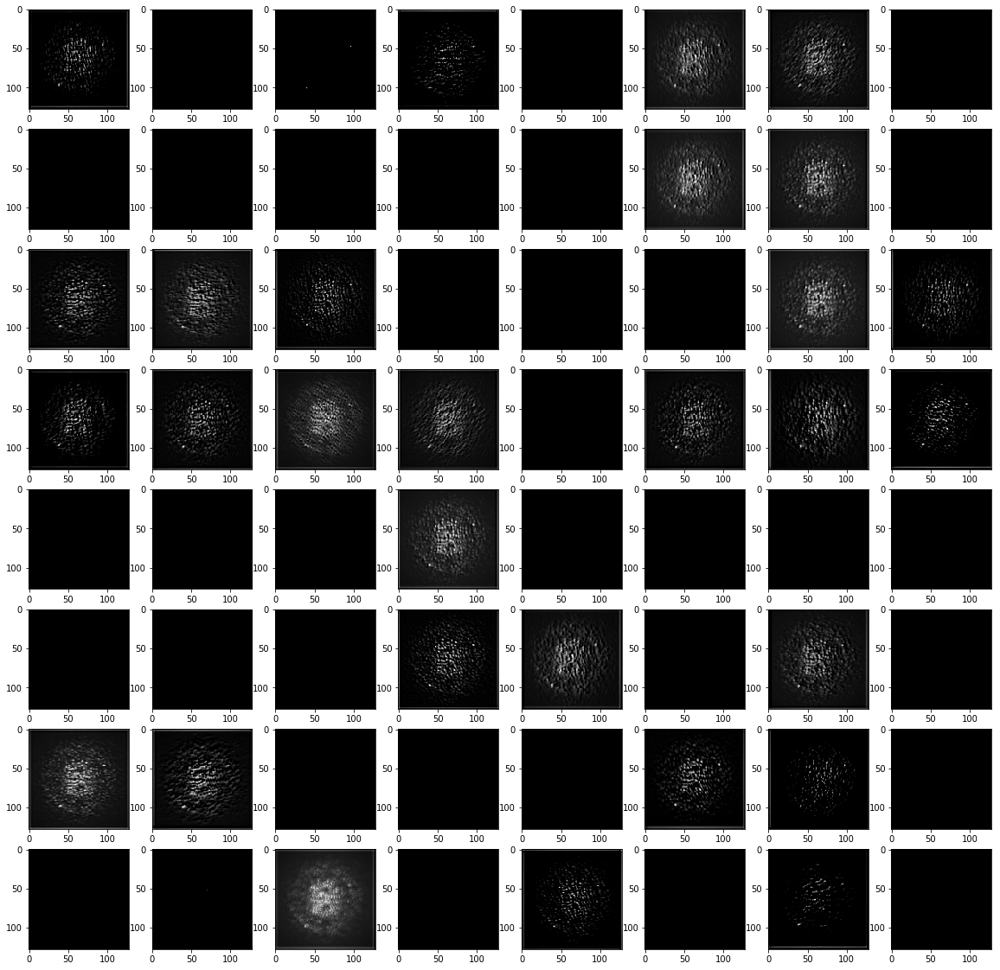

('block: ', 4)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

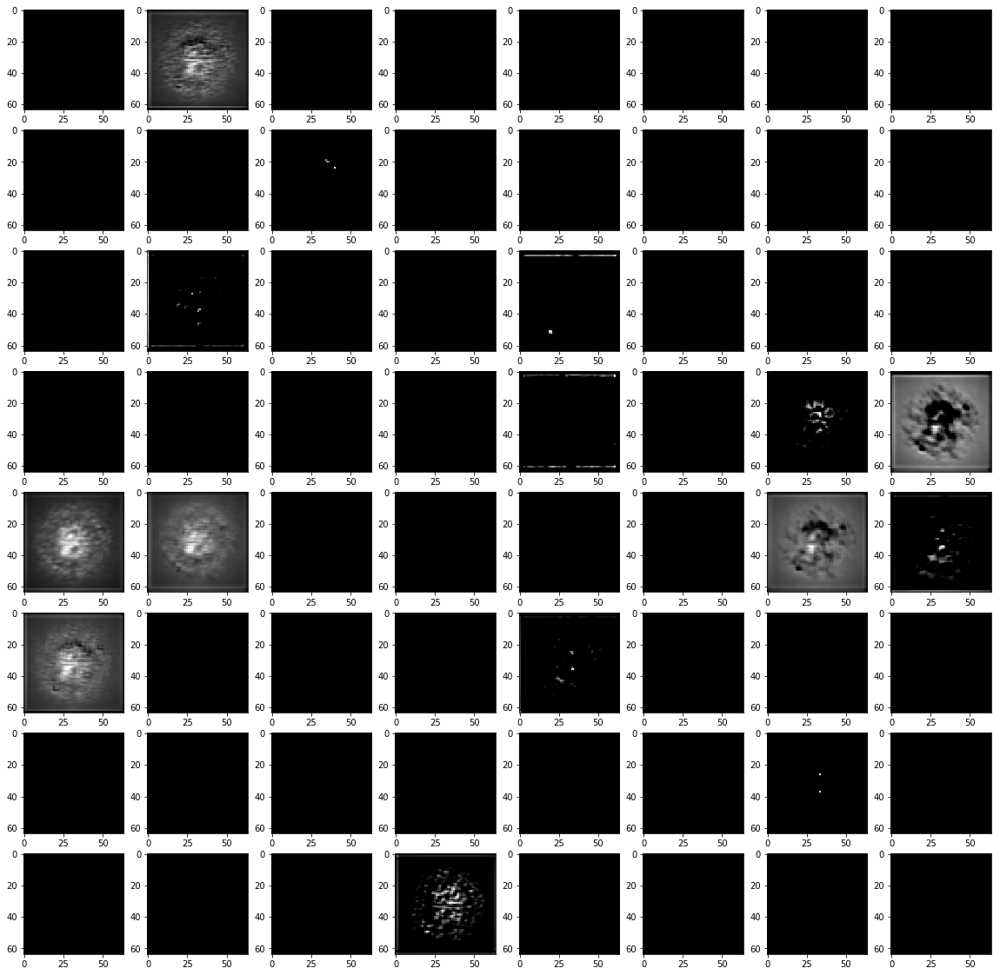

('block: ', 5)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 512, 512, 1)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 512, 512, 64)      640       
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 512, 512, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 256, 256, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 256, 256, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 256, 256, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 128, 128, 128)     0     

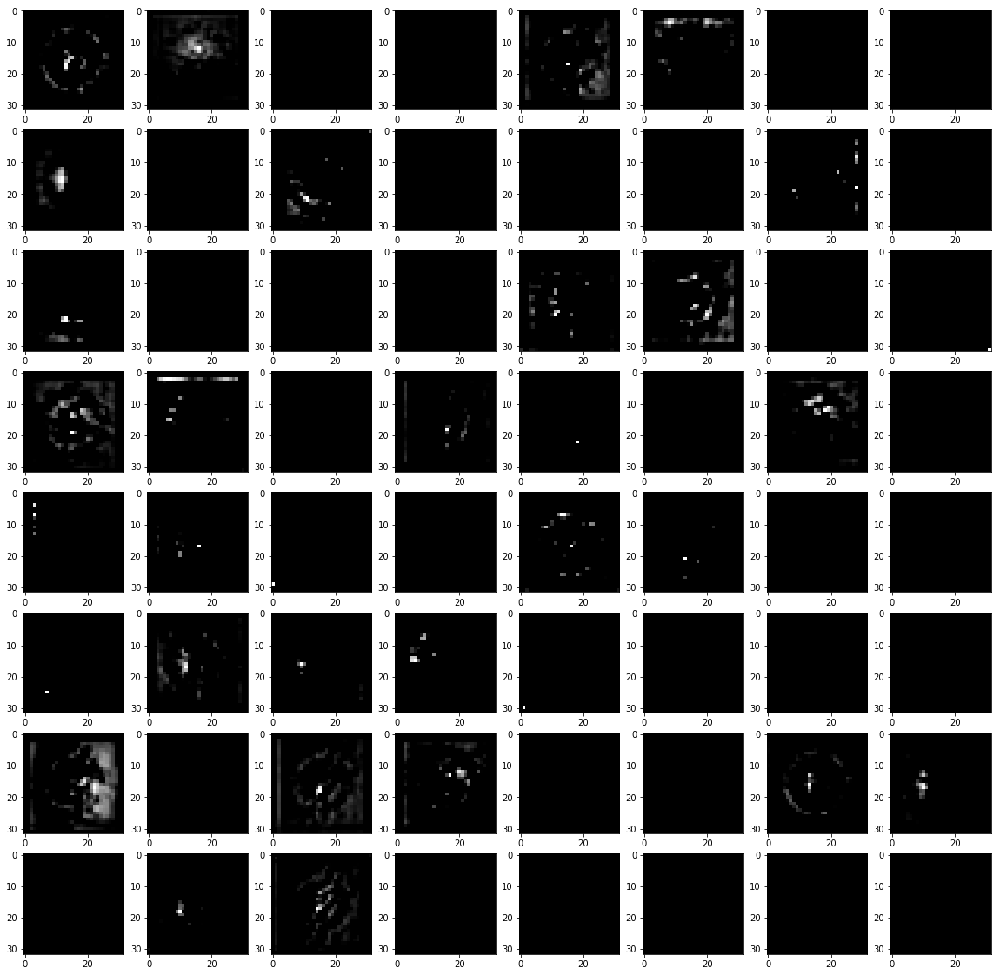

In [118]:
display_mapsPerBlock(model_binary_multi, img_multi)

The binary classifier for smeared spots is the only of the 3 models that shows some structures in feature maps from the retrained, final two convolutional blocks. However, it is difficult to determine if learned structures for predicting smeared or split spots are significant.

### Discussion

In general, gaining interpretable information about a model's decision process from the display of its convolutional filters and resulting feature maps is difficult. Within the filters for each model, I cannot detect any distinguashible differences that would lead me to the conclusion that models with different prediction emphasis have picked up on certain patterns, such as larger bright areas close to the edges of images for ice rings. This might be partially caused by the small fiter size of 3x3 even though they add up to a filter size of 7x7 for each convolutional block. <br>
However, the feature maps show a few promising trends as well as providing some insight into the low prediction accuracy of the multitask model. Promising is that in feature maps of the middle layers of the multitask learning model and the binary ice classifier, brighter areas closer to the image edges seems to have been picked up on, even though the information was lost again in deeper layers. Furthermore, the binary classifier for smeared spots kept structural information in the last 2 layers, so that it might have picked up on some patterns. Nevertheless, the most important result is that the multitask model and the binary ice classifier seem to have lost all previously gained information in the final, retrained layers and output nearly blank feature maps that are almost completely black. This indicates that the learning process was not successful even though the test accuracies seemed to have improved. Either overfitting occured or the accuracy might have been caused by the uneven distribution of the dataset that was discussed in the beginning of this report. Since the feature maps in the final layers of the multitask model and the binary ice classifier are nearly empty, overfitting does not seem reasonable. If the classification task would have been binary for each of the categories blank, photo I, photo II, multilattice, and ice than the following accuracies could have been caused simply by chance due to the uneven distribution of the data set: blank - 92%, photo I - 45%, photo II - 45%, multilattice - 68%, and ice 78%. The prediction performance of each model matches those random values, unfortunately. <br>
I, as a machine learning programmer, still have learned a lot from thinking about potential patterns that models could pick up from input images and displaying filters and feature maps. By doing so, it became obvious, that the accuracy values were misleading and that the model trainings were not successful even though learning behavior was observed. 
Multiple reasons come to mind, why the multitask learning and even the training of the binary classifiers failed. First, the relation of background information to diffraction spots is almost 10:1, so that the majority of pixel values do not provide useful information. Second, the patterns to distinguish between categories are relatively small with only 1 up to 3 or 4 neighboring pixels, because of the downsampling of the images. Last, VGG16 is a fairly complex architecture that might be too flexible for extracting features from diffraction images, which are relatively simple. Many of the final feature maps were black and may indicate dead weights.

### Conclusion

Analyzing the filters and feature maps for the 3 introduced models, clearly showed that their training was not successful, even though the transfer learning approach seemed to show learning behavior by reducing the loss and improving the test accuracy. However, disguised by the uneven distribution of the categories within the training data set, the random chance accuracies were quite high and misleading. 
The next steps are to train a multitask learning model on cropped parts of images that are not downsampled to increase the size of significant patterns, to even out the training data set and also to reduce the complexity of the model architecture.

Overall, I have learned to pay close attention to random chance accuracies for unevenly distributed data sets, and to think about potential features the model could extract to make decisions. It was very interesting to extract and display filters and feature maps from different models in different depths and to see how feature maps changed with different input images. 